# Before you start

1. Please copy the code from the previous assignment (week 2) into a separate file `blocks.py`. Make sure it resides in the same folder as this notebook. It should contain the implementation of the building blocks. 
2. Downlod the files from [here](http://yann.lecun.com/exdb/mnist/) and place them next to this notebook. You should have 4 files: `t10k-images-idx3-ubyte
3. All functions should be implemented using [**NumPy**](https://docs.scipy.org/doc/).

The goal of this assignment is to supply you with the **building blocks** of **neural networks** (NNs). In this notebook, we will cover the main aspects of NNs, such as **Backpropagation** and **Optimization Methods**. 
You will understand how **Convolutional Neural Networks** and the basics of **image filtering** work. We will implement matrix convolution as well as the convolutional layer from scratch.


### Note
Some of the concepts below have not (yet) been discussed during the lecture. These will be discussed further during the next lectures. 

# Table of contents

* [1. Fully-Connected Neural Networks](#1.-Fully-Connected-Neural-Networks)
    * [1.1 Backpropagation](#1.1-Backpropagation)
    * [1.2 Dense layer](#1.2-Dense-layer)
    * [1.3 ReLU nonlinearity](#1.3-ReLU-nonlinearity)
    * [1.4 Sigmoid nonlinearity](#1.4-Sigmoid-nonlinearity)
    * [1.5 Sequential model](#1.5-Sequential-model)
    * [1.6 NLL loss function](#1.6-NLL-loss-function)
    * [1.7 $L_2$ regularization](#1.7-$L_2$-regularization)
    * [1.8 SGD optimizer](#1.8-SGD-optimizer)
* [2. Experiments](#2.-Experiments)
* [3. Convolutions](#3.-Convolutions)
    * [3.1 Matrix convolution](#3.1-Matrix-convolution)
    * [3.2 Basic kernels](#3.2-Matrix-convolution)
    * [3.3 Convolutional layer](#3.3-Convolutional-layer)
    * [3.4 Pooling layer](#3.4-Pooling-layer)
    * [3.5 Flatten](#3.5-Flatten)
* [4. Image Experiments](#4.-Image-Experiments)

In [1]:
from __future__ import print_function, absolute_import, division 
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

import blocks

import automark as am

# fill in you student number as your username
username = '12405965'

# to check your progress, you can run this function
am.get_progress(username)

---------------------------------------------
| Jerinca Vreugdenhil                       |
| jerinca.vreugdenhil@student.uva.nl        |
---------------------------------------------
| box_blur                 | not attempted  |
| conv_matrix              | not attempted  |
| dense_forward            | not attempted  |
| dense_grad_W             | not attempted  |
| dense_grad_b             | not attempted  |
| dense_grad_input         | not attempted  |
| flatten_forward          | not attempted  |
| flatten_grad_input       | not attempted  |
| l2_regularizer           | not attempted  |
| linear_forward           | completed      |
| linear_grad_W            | completed      |
| linear_grad_b            | completed      |
| maxpool_forward          | not attempted  |
| nll_forward              | completed      |
| nll_grad_input           | completed      |
| relu_forward             | not attempted  |
| relu_grad_input          | not attempted  |
| sigmoid_forward          | compl

# 1. Fully-Connected Neural Networks

## 1.1 Backpropagation

Neural networks consist of several layers. Each layer is a function of several parameters that we call weights: $h = f(x, w)$ where $h$ is the layer, $x$ is a vector of inputs and w is a vector of weights. 
In the neural network, the output of one layer is the input for the next layer. This means we can chain the different functions. The whole neural network $F$ then becomes a composition of different functions. 
$$
F = f_k \circ f_{k-1} \circ \dots \ f_1\\
h_1 = f_1(x, w_1)\\
h_2 = f_2(h_1, w_2)\\
\dots \\
\dot{y} = f_k(h_{k-1}, w_k)
$$
In the above functions, $w_1$ and $w_2$ are different **weight vectors** that apply to the different layers $h_1$ and $h_2$. The weights of a neural network basically determine the effect certain outputs have on the next layer. (Please note: When searching for these terms on the internet, be aware that **weights** are sometimes called **parameters**, and $w$ is sometimes denoted as $\theta$.) 


At the end of every neural network, there is a loss function. A loss function calculates for the performance of the Neural Network. The calculation of this score depends on the task at hand. For classification tasks the loss function would calculate the difference between prediction and the correct value. In this case the function is a summation of this difference for each data point. Calculating this difference can, again, be done in different ways. One example that we have discussed in class is the squared-loss for linear regression. (Here, the difference between predicted and correct classification is squared so positive and negative differences don't cancel eachother.) 
$$\mathcal{L} = \tfrac{1}{2}\sum_{n = 1}^N (y_n - \dot{y}_n)^2$$
Here, $n$ denotes the different datapoints, $y_n$ and $\dot{y}$ represent the correct and the predicted value for that data point respectively. 



The smaller the outcome of this loss function, the better the Neural Network predicts the data. Therefore, we concentrate on **minimizing the loss function** as a means for **training** the neural network. 


Training is done with [Gradient descent](https://en.wikipedia.org/wiki/Gradient_descent). Another word for **gradient** is **derivative**. We use derivatives to update the weights of the neural network to make better predictions. 
The weights of the $k$-th layer are updated according to the following scheme:
$$
w_k \leftarrow w_k - \gamma \frac{\partial \mathcal{L}}{\partial w_k} 
$$
* $\partial f(x)/\partial x$ means the partial derivative of $f(x)$ with respect to $x$. 
* Hyperparameter $\gamma$ is called the *learning rate* (You'll learn more about hyperparameters later. For now, the only thing you'll have to know is that the value of a hyperparameter is set by you.) 
* Note that $k$ denotes a layer and $n$ denotes a data point.


The computation of $\partial \mathcal{L}/\partial w_k$ is done using the [chain rule](https://en.wikipedia.org/wiki/Chain_rule):
$$
\frac{\partial \mathcal{L}}{\partial w_k} = 
\frac{\partial \mathcal{L}}{\partial h_k}
\frac{\partial h_k}{\partial w_k} = 
\frac{\partial \mathcal{L}}{\partial h_{k+1}}
\frac{\partial h_{k+1}}{\partial h_k}
\frac{\partial h_k}{\partial w_k} = \dots
$$


Therefore, for each layer, we can calculate the following expressions: 
* $h_k = f_k(h_{k-1}, w_k)$ - the forward pass
* $\partial h_{k}/\partial h_{k-1}$ - the partial derivative of the output with respect to the input
* $\partial h_{k}/\partial w_k$ - the partial derivative of the output with respect to the parameters


This whole process of updating weights by calculating the gradient is called [Backpropagation](https://www.iro.umontreal.ca/~vincentp/ift3395/lectures/backprop_old.pdf). Click [here](https://www.youtube.com/watch?v=Ilg3gGewQ5U) for a pretty good video explaining backpropagation. 

## 1.2 Dense layer
A dense Layer is the basic layer of a neural network. (Other terms for dense layer are fully-connected layer and multiplicative layer.) A dense layer transforms an input matrix of size `(n_objects, d_in)` to a matrix of size `(n_objects, d_out)` (where d stands for dimensions) by performing the following operation:
$$
H = XW + b
$$
Here $H$ represents the function of the dense layer, $X$ is the input matrix, $W$ is the weight matrix for this layer and $b$ is the bias. The bias $b$ is a vector. 

A more detailed version of this function is: 
$$
H_{nk} = \sum\limits_{i=1}^{d_{in}} X_{ni}W_{ik} + b_k
$$
where $n$ denotes again a single data object and $k$ the $k^{th}$ layer.

**Example**: 

You have a neural network of just 1 layer. The inputs are points in a 3D space and you want to classify this point as either $-1$ or $1$. 
You have $75$ objects in your training set. 

Therefore, $X$ has shape $75 \times 3$. $H$ has shape $75 \times 1$. Weight $W$ of the layer has shape $3 \times 1$.

**NOTE: "Dense Layer" is linear. So its mapping is exactly the same as of "Linear" function from the previous week but `n_out` is not restricted to 1. We use name "Dense" in order to distinquish between these two functions**

In [13]:
def dense_forward(x_input, W, b):
    """Perform the mapping of the input
    # Arguments
        x_input: input of a dense layer - np.array of size `(n_objects, n_in)`
        W: np.array of size `(n_in, n_out)`
        b: np.array of size `(n_out,)`
    # Output
        the output of a dense layer 
        np.array of size `(n_objects, n_out)`
    """
    output = np.matmul(x_input,W) +b
    

    #################
    ### YOUR CODE ###
    #################
    return output

In [15]:
am.test_student_function(username, dense_forward, ['x_input', 'W', 'b'])

Running local tests...
dense_forward successfully passed local tests
Running remote test...
Test was successful. Congratulations!


Now, you'll implement a backward pass. As decribed above, this is calculated with the gradient. To calculate the gradient, we'll use the chain rule: 
$$
\frac{\partial \mathcal{L}}{\partial X} = 
\frac{\partial \mathcal{L}}{\partial H}
\frac{\partial H}{\partial X}
$$

In [25]:
def dense_grad_input(x_input, grad_output, W, b):
    """Calculate the partial derivative of 
        the loss with respect to the input of the layer
    # Arguments
        x_input: input of a dense layer - np.array of size `(n_objects, n_in)`
        grad_output: partial derivative of the loss functions with 
            respect to the ouput of the dense layer 
            np.array of size `(n_objects, n_out)`
        W: np.array of size `(n_in, n_out)`
        b: np.array of size `(n_out,)`
    # Output
        the partial derivative of the loss with 
        respect to the input of the layer
        np.array of size `(n_objects, n_in)`
    """
    print(W.shape)
    print(grad_output.shape)
    
    grad_input = np.matmul(grad_output, W.T)
    
    #################
    ### YOUR CODE ###
    #################
    return grad_input

In [26]:
am.test_student_function(username, dense_grad_input, ['x_input', 'grad_output', 'W', 'b'])

Running local tests...
(1, 5)
(6, 5)
(2, 2)
(4, 2)
(5, 2)
(1, 2)
(6, 5)
(3, 5)
(5, 6)
(4, 6)
(1, 3)
(6, 3)
(5, 4)
(3, 4)
(3, 4)
(3, 4)
(5, 2)
(3, 2)
(2, 3)
(6, 3)
(4, 4)
(3, 4)
(1, 4)
(4, 4)
(2, 1)
(6, 1)
(4, 5)
(5, 5)
(6, 1)
(2, 1)
(4, 4)
(4, 4)
(6, 1)
(3, 1)
(1, 2)
(3, 2)
(5, 3)
(2, 3)
(1, 1)
(5, 1)
(2, 2)
(3, 2)
(5, 4)
(4, 4)
(6, 6)
(4, 6)
(3, 1)
(3, 1)
(4, 2)
(6, 2)
(5, 4)
(6, 4)
(2, 2)
(3, 2)
(4, 5)
(3, 5)
(6, 4)
(1, 4)
(6, 2)
(1, 2)
(1, 3)
(1, 3)
(3, 2)
(4, 2)
(6, 6)
(2, 6)
(4, 6)
(3, 6)
(6, 5)
(5, 5)
(6, 5)
(3, 5)
(6, 4)
(6, 4)
(4, 1)
(3, 1)
(1, 4)
(1, 4)
(6, 4)
(3, 4)
(1, 5)
(4, 5)
(4, 4)
(2, 4)
(3, 3)
(2, 3)
(5, 5)
(4, 5)
(5, 5)
(6, 5)
(4, 1)
(6, 1)
(6, 4)
(2, 4)
(6, 4)
(3, 4)
(2, 5)
(3, 5)
(4, 6)
(4, 6)
(5, 2)
(6, 2)
(4, 6)
(1, 6)
(6, 6)
(1, 6)
(6, 6)
(2, 6)
(2, 5)
(3, 5)
(6, 6)
(5, 6)
(3, 2)
(6, 2)
(5, 2)
(4, 2)
(6, 1)
(6, 1)
(4, 1)
(6, 1)
(3, 3)
(2, 3)
(4, 6)
(2, 6)
(2, 5)
(5, 5)
(3, 1)
(2, 1)
(5, 2)
(2, 2)
(6, 1)
(4, 1)
(2, 5)
(2, 5)
(3, 2)
(5, 2)
(3, 4)
(3, 4)
(1, 2)
(2, 

Now, instead of computing the gradient with respect to the input, we'll calculate the gradient with respect to the weights and to the bias: 
$$
\frac{\partial \mathcal{L}}{\partial W} = 
\frac{\partial \mathcal{L}}{\partial H}
\frac{\partial H}{\partial W} \\
\frac{\partial \mathcal{L}}{\partial b} = 
\frac{\partial \mathcal{L}}{\partial H}
\frac{\partial H}{\partial b} \\
$$

In [33]:
def dense_grad_W(x_input, grad_output, W, b):
    """Calculate the partial derivative of 
        the loss with respect to W parameter of the layer
    # Arguments
        x_input: input of a dense layer - np.array of size `(n_objects, n_in)`
        grad_output: partial derivative of the loss functions with 
            respect to the ouput of the dense layer 
            np.array of size `(n_objects, n_out)`
        W: np.array of size `(n_in, n_out)`
        b: np.array of size `(n_out,)`
    # Output
        the partial derivative of the loss 
        with respect to W parameter of the layer
        np.array of size `(n_in, n_out)`
    """
    print(grad_output.shape)
    print(x_input.shape)
    
    grad_W = np.matmul(x_input.T, grad_output)
    
    #################
    ### YOUR CODE ###
    #################
    return grad_W

In [34]:
am.test_student_function(username, dense_grad_W, ['x_input', 'grad_output', 'W', 'b'])

Running local tests...
(6, 2)
(6, 3)
(2, 4)
(2, 1)
(2, 2)
(2, 1)
(4, 5)
(4, 5)
(3, 2)
(3, 3)
(1, 5)
(1, 4)
(3, 5)
(3, 6)
(4, 3)
(4, 5)
(2, 4)
(2, 2)
(6, 5)
(6, 3)
(2, 3)
(2, 6)
(5, 5)
(5, 5)
(1, 2)
(1, 1)
(6, 4)
(6, 5)
(3, 5)
(3, 5)
(6, 1)
(6, 3)
(1, 6)
(1, 3)
(4, 6)
(4, 6)
(5, 2)
(5, 2)
(4, 4)
(4, 1)
(4, 4)
(4, 3)
(4, 3)
(4, 3)
(3, 6)
(3, 1)
(2, 4)
(2, 3)
(1, 4)
(1, 5)
(6, 3)
(6, 6)
(6, 2)
(6, 6)
(5, 2)
(5, 4)
(1, 3)
(1, 4)
(6, 1)
(6, 4)
(6, 6)
(6, 6)
(5, 5)
(5, 3)
(1, 6)
(1, 4)
(6, 4)
(6, 1)
(6, 1)
(6, 1)
(2, 1)
(2, 4)
(5, 1)
(5, 3)
(3, 1)
(3, 5)
(1, 6)
(1, 3)
(3, 2)
(3, 4)
(1, 6)
(1, 2)
(3, 1)
(3, 6)
(1, 6)
(1, 6)
(4, 2)
(4, 1)
(6, 3)
(6, 5)
(1, 3)
(1, 6)
(6, 2)
(6, 3)
(1, 1)
(1, 2)
(1, 1)
(1, 5)
(5, 1)
(5, 3)
(4, 5)
(4, 1)
(5, 1)
(5, 4)
(6, 2)
(6, 2)
(2, 5)
(2, 2)
(4, 5)
(4, 3)
(4, 1)
(4, 4)
(3, 4)
(3, 5)
(4, 4)
(4, 1)
(6, 5)
(6, 2)
(6, 1)
(6, 2)
(5, 6)
(5, 3)
(6, 4)
(6, 6)
(4, 3)
(4, 1)
(4, 5)
(4, 3)
(3, 3)
(3, 1)
(1, 6)
(1, 4)
(2, 3)
(2, 4)
(5, 6)
(5, 2)
(3, 6)
(3, 6)
(6, 3)
(6, 

In [166]:
def dense_grad_b(x_input, grad_output, W, b):
    """Calculate the partial derivative of 
        the loss with respect to b parameter of the layer
    # Arguments
        x_input: input of a dense layer - np.array of size `(n_objects, n_in)`
        grad_output: partial derivative of the loss functions with 
            respect to the ouput of the dense layer 
            np.array of size `(n_objects, n_out)`
        W: np.array of size `(n_in, n_out)`
        b: np.array of size `(n_out,)`
    # Output
        the partial derivative of the loss 
        with respect to b parameter of the layer
        np.array of size `(n_out,)`
    """
#     print(b.shape)
#     print(grad_output.shape)
    
#     hoi = np.ones(grad_output.shape, dtype=int)
    
#     grad_b = np.matmul(hoi.T, grad_output)
#     print(b.shape)
    grad_b = sum(grad_output)
#     print(grad_output.sum(0))
#     print(sum(grad_output))
    #################
    ### YOUR CODE ###
    #################
    return grad_b

In [167]:
am.test_student_function(username, dense_grad_b, ['x_input', 'grad_output', 'W', 'b'])

Running local tests...
dense_grad_b successfully passed local tests
Running remote test...
Test was successful. Congratulations!


In [294]:
am.get_progress(username)

---------------------------------------------
| Jerinca Vreugdenhil                       |
| jerinca.vreugdenhil@student.uva.nl        |
---------------------------------------------
| box_blur                 | completed      |
| conv_matrix              | completed      |
| dense_forward            | completed      |
| dense_grad_W             | completed      |
| dense_grad_b             | completed      |
| dense_grad_input         | completed      |
| flatten_forward          | completed      |
| flatten_grad_input       | completed      |
| l2_regularizer           | completed      |
| linear_forward           | completed      |
| linear_grad_W            | completed      |
| linear_grad_b            | completed      |
| maxpool_forward          | completed      |
| nll_forward              | completed      |
| nll_grad_input           | completed      |
| relu_forward             | completed      |
| relu_grad_input          | completed      |
| sigmoid_forward          | compl

### Dense Layer Class

Here, we define a basic class for the dense layer. You will use this in the Experiments sections below. You don't need to know how this works; we implement it for you, but it is based on the functions you've written above. 

In [97]:
class Layer(object):
    
    def __init__(self):
        self.training_phase = True
        self.output = 0.0
        
    def forward(self, x_input):
        self.output = x_input
        return self.output
    
    def backward(self, x_input, grad_output):
        return grad_output
    
    def get_params(self):
        return []
    
    def get_params_gradients(self):
        return []

In [98]:
class Dense(Layer):
    
    def __init__(self, n_input, n_output):
        super(Dense, self).__init__()
        #Randomly initializing the weights from normal distribution
        self.W = np.random.normal(scale=0.01, size=(n_input, n_output))
        self.grad_W = np.zeros_like(self.W)
        #initializing the bias with zero
        self.b = np.zeros(n_output)
        self.grad_b = np.zeros_like(self.b)
      
    def forward(self, x_input):
        self.output = dense_forward(x_input, self.W, self.b)
        return self.output
    
    def backward(self, x_input, grad_output):
        # get gradients of weights
        self.grad_W = dense_grad_W(x_input, grad_output, self.W, self.b)
        self.grad_b = dense_grad_b(x_input, grad_output, self.W, self.b)
        # propagate the gradient backwards
        return dense_grad_input(x_input, grad_output, self.W, self.b)
    
    def get_params(self):
        return [self.W, self.b]

    def get_params_gradients(self):
        return [self.grad_W, self.grad_b]

In [99]:
dense_layer = Dense(2, 1)
x_input = np.random.random((3, 2))
y_output = dense_layer.forward(x_input)
print(x_input)
print(y_output)

[[0.66240366 0.12121111]
 [0.45341073 0.93686059]
 [0.33641197 0.39456082]]
[[ 0.00905966]
 [-0.00489532]
 [ 0.00027363]]


## 1.3 ReLU nonlinearity

The dense layer, from previous section, is linear. Combinging several linear (dense) layers is always equivalent to a single dense layer. Here is the mathematically proof for this: 
$$
H_1 = XW_1 + b_1\\
H_2 = H_1W_2 + b_2\\
H_2 = (XW_1 + b_1)W_2 + b_2 = X(W_1W_2) + (b_1W_2 + b_2) = XW^* + b^*
$$


For this reason, we also need non-linear layers. Non-linear layers ($f$ in the following) are mostly element-wise and hold the following:
$$
H_1 = XW_1 + b_1\\
H_2 = f(H_1)W_2 + b_2\\
H_2 = f(XW_1 + b_1)W_2 + b_2 \neq XW^* + b^*
$$

A popular example of a simple non-linear layer is **ReLU** (Rectified Linear Unit). ReLU doesn't have weights that can be optimized like a dense layer.
$$
\text{ReLU}(x) = \max(0, x)
$$

<img src="./src/relu.png" width="500">

**Example**

$$
\text{ReLU} \Big(
\begin{bmatrix}
1 & -0.5 \\
0.3 & 0.1 
\end{bmatrix}
\Big) = 
\begin{bmatrix}
1 & 0 \\
0.3 & 0.1 
\end{bmatrix}
$$

Next, you will implement the forward pass and backward pass (gradient) for ReLU. 

In [106]:
def relu_forward(x_input):
    """relu nonlinearity
    # Arguments
        x_input: np.array of size `(n_objects, n_in)`
    # Output
        the output of relu layer
        np.array of size `(n_objects, n_in)`
    """
    print(x_input)
    
    output = np.maximum(x_input,0.0)
    #################
    ### YOUR CODE ###
    #################
    return output

In [107]:
#test forward pass for ReLU, see example above
x_input = np.array([[1, -0.5],
                    [0.3, 0.1]])

print(relu_forward(x_input))

[[ 1.  -0.5]
 [ 0.3  0.1]]
[[1.  0. ]
 [0.3 0.1]]


In [108]:
am.test_student_function(username, relu_forward, ['x_input'])

Running local tests...
[[-5.95083292  8.89538829 -6.172954  ]
 [-0.57821516  4.76346384  1.9486438 ]
 [ 2.61807633 -8.96334802 -4.36527753]]
[[-6.86287445  7.51984128]
 [ 1.20858748 -7.57499444]
 [-0.09395907 -8.15148353]
 [ 3.3481428  -9.2869837 ]
 [-1.83820881 -5.43373195]
 [ 5.01300167  7.31284123]]
[[ 1.10354872  4.36579563  5.30140329 -4.26550053]
 [ 9.1087631  -1.51419989 -6.14516774  8.49019197]
 [-7.011335   -4.45981292  0.75362288  1.88489666]
 [ 3.78420657 -8.76673019 -7.34517375  8.01861791]
 [ 6.67288246  5.76007355  0.69383616  8.0676354 ]
 [-1.62256599  1.52420367 -3.56386254 -4.16437508]]
[[-7.16813223 -8.18284971  2.93127748]
 [ 9.96690315 -1.71521929  1.29320893]
 [-5.45840457  7.80021356 -2.93197863]]
[[-6.65827212  9.64055789  1.57667448]
 [ 9.59220475 -9.52180414  7.99438127]
 [-2.70658626  0.16169608 -9.09645804]
 [ 8.32912855  2.0606694   2.91368005]
 [-8.40596349 -9.51635825  7.64434033]
 [ 8.01190532  9.31019787  0.20534326]]
[[ 7.06311444 -9.60216436 -5.3225386

[[ 4.2760421 ]
 [-3.86037576]
 [-4.98223807]
 [ 0.48255615]
 [ 0.51876373]]
Test was successful. Congratulations!


In [127]:
def relu_grad_input(x_input, grad_output):
    """relu nonlinearity gradient. 
        Calculate the partial derivative of the loss 
        with respect to the input of the layer
    # Arguments
        x_input: np.array of size `(n_objects, n_in)`
            grad_output: np.array of size `(n_objects, n_in)`
    # Output
        the partial derivative of the loss 
        with respect to the input of the layer
        np.array of size `(n_objects, n_in)`
    """
    
    print(x_input.shape)
    print(grad_output.shape)
    
    grad_input = grad_output * (x_input>0).astype(int)
    
#     for rows in x_input:
#         for y in rows:
#             if y < 0:
#                 grad_input = 0
#             else:
#                 grad_input = 1
            
#     print(empty_list)
    
    
    #################
    ### YOUR CODE ###
    #################
    return grad_input

In [128]:
am.test_student_function(username, relu_grad_input, ['x_input', 'grad_output'])

Running local tests...
(1, 5)
(1, 5)
(1, 3)
(1, 3)
(5, 6)
(5, 6)
(4, 3)
(4, 3)
(2, 5)
(2, 5)
(4, 6)
(4, 6)
(3, 3)
(3, 3)
(5, 5)
(5, 5)
(4, 6)
(4, 6)
(1, 3)
(1, 3)
(6, 3)
(6, 3)
(1, 1)
(1, 1)
(3, 6)
(3, 6)
(4, 5)
(4, 5)
(3, 3)
(3, 3)
(2, 6)
(2, 6)
(3, 2)
(3, 2)
(1, 4)
(1, 4)
(6, 2)
(6, 2)
(3, 6)
(3, 6)
(1, 4)
(1, 4)
(4, 6)
(4, 6)
(2, 3)
(2, 3)
(1, 1)
(1, 1)
(2, 1)
(2, 1)
(3, 5)
(3, 5)
(6, 3)
(6, 3)
(2, 3)
(2, 3)
(6, 5)
(6, 5)
(6, 5)
(6, 5)
(1, 3)
(1, 3)
(4, 4)
(4, 4)
(5, 3)
(5, 3)
(4, 2)
(4, 2)
(2, 6)
(2, 6)
(6, 1)
(6, 1)
(5, 6)
(5, 6)
(5, 6)
(5, 6)
(6, 2)
(6, 2)
(3, 6)
(3, 6)
(3, 1)
(3, 1)
(5, 3)
(5, 3)
(1, 5)
(1, 5)
(5, 6)
(5, 6)
(1, 6)
(1, 6)
(1, 1)
(1, 1)
(2, 5)
(2, 5)
(5, 6)
(5, 6)
(4, 2)
(4, 2)
(6, 3)
(6, 3)
(1, 3)
(1, 3)
(1, 1)
(1, 1)
(2, 4)
(2, 4)
(4, 1)
(4, 1)
(5, 2)
(5, 2)
(2, 6)
(2, 6)
(2, 5)
(2, 5)
(6, 5)
(6, 5)
(1, 5)
(1, 5)
(5, 3)
(5, 3)
(1, 3)
(1, 3)
(3, 3)
(3, 3)
(6, 5)
(6, 5)
(2, 1)
(2, 1)
(5, 2)
(5, 2)
(4, 1)
(4, 1)
(3, 2)
(3, 2)
(3, 6)
(3, 6)
(6, 1)
(6, 1)
(2, 3)
(2, 

In [134]:
class ReLU(Layer):
        
    def forward(self, x_input):
        self.output = relu_forward(x_input)
        return self.output
    
    def backward(self, x_input, grad_output):
        return relu_grad_input(x_input, grad_output)

## 1.4 Sigmoid nonlinearity

In [135]:
class Sigmoid(Layer):
        
    def forward(self, x_input):
        self.output = blocks.sigmoid_forward(x_input)
        return self.output
    
    def backward(self, x_input, grad_output):
        return blocks.sigmoid_grad_input(x_input, grad_output)

## 1.5 Sequential model
In order to make the work with layers more comfortable, we create `SequentialNN` - a class, which stores all its layers and performs the basic manipulations. Again, this is for the experiments below and you don't need to know how this works. 

In [136]:
class SequentialNN(object):

    def __init__(self, *layers):
        self.layers = layers
        self.training_phase = True
        
    def set_training_phase(self, is_training=True):
        self.training_phase = is_training
        for layer in self.layers:
            layer.training_phase = is_training
        
    def forward(self, x_input):
        self.output = x_input
        for layer in self.layers:
            self.output = layer.forward(self.output)
        return self.output
    
    def backward(self, x_input, grad_output):
        inputs = [x_input] + [l.output for l in self.layers[:-1]]
        for input_, layer_ in zip(inputs[::-1], self.layers[::-1]):
            grad_output = layer_.backward(input_, grad_output)
            
    def get_params(self):
        params = []
        for layer in self.layers:
            params.extend(layer.get_params())
        return params
    
    def get_params_gradients(self):
        grads = []
        for layer in self.layers:
            grads.extend(layer.get_params_gradients())
        return grads

Here is the simple neural network. It takes an input of shape `(Any, 10)` and passes it through `Dense(10, 4)`, `ReLU` and `Dense(4, 1)`. The output is a batch of size `(Any, 1)`. 
```
  INPUT
    |
Dense(10, 4)
    |
   ReLU
    |
Dense(4, 1)
    |
  OUTPUT
```

In [137]:
nn = SequentialNN(
    Dense(10, 4), 
    ReLU(),
    Dense(4, 1),
    Sigmoid()
)

In [138]:
nn.forward(np.ones([2, 10]))

[[-6.19102670e-05  8.55157600e-04  2.56480826e-02 -2.81208859e-02]
 [-6.19102670e-05  8.55157600e-04  2.56480826e-02 -2.81208859e-02]]


array([[0.49993504],
       [0.49993504]])

## 1.6 NLL loss function
Here we will define the loss functions. Each loss should be able to compute its value and compute its gradient with respect to the input. We have implemented these functions (e.g. forward, backward) for you.  

In [139]:
class NLL(object):
    
    def forward(self, target_pred, target_true):
        self.output = blocks.nll_forward(target_pred, target_true)
        return self.output
    
    def backward(self, target_pred, target_true):
        return blocks.nll_grad_input(target_pred, target_true)

## 1.7 $L_2$ regularization

Loss functions update the weights of your model to improve your predictions. We do this by minimizing the loss function. However, up until now this loss function did not take into account the complexity of your model. Here we mean with complexity the number of parameters that your model stores. We do want to take complexity into account because complex models can perform poorly on test data, while performing excellent on train data. 

To penalize the complextity of the model, we introduce a regularizer. You'll learn more about regularizers in the lectures, but the general idea is that we take the values of the weights into account with the loss function. High values for weights are indicators of complexity. 

There are several ways of adding regularization to a model. We will implement [$L_2$ regularization](http://www.deeplearningbook.org/contents/regularization.html) also known as weight decay:

The key idea of $L_2$ regularization is to add an extra term to the loss functions:
$$
\mathcal{L}^* = \mathcal{L} + \frac{\lambda}{2} \|w\|^2_2
$$

The part we added to the loss function is called the regularization function. 
* $\lambda$ is named weight decay. It is a hyperparameter that determines the influence of the regularization to the outcome of the loss function. 
* $\|w\|^2_2$ is the squared [euclidian norm](https://en.wikipedia.org/wiki/Euclidean_distance) where $\|w\|^2_2 = \|w_1\|^2_2 + \|w_2\|^2_2 ... \|w_k\|^2_2$. 
This function in more detail becomes:

$$
\mathcal{L}^* = \mathcal{L} + \frac{\lambda}{2} \sum\limits_{m=1}^k \|w_m\|^2_2
$$

Because we use a different loss function, the updating of the weights is also slightly changed: 

$$
w_m \leftarrow w_m - \gamma \frac{\partial \mathcal{L}^*}{\partial w_m}\\
\frac{\partial \mathcal{L}^*}{\partial w_m} = \frac{\partial \mathcal{L}}{\partial w_m} + \lambda w_m\\
w_m \leftarrow w_m - \gamma \Big(\frac{\partial \mathcal{L}}{\partial w_m} + \lambda w_m\Big)
$$

Here, you'll implement the computation of $L_2$: 
$$
L_2(\lambda, [w_1, w_2, \dots, w_k]) = \frac{\lambda}{2} \sum\limits_{m=1}^k \|w_m\|^2_2
$$ 

In [179]:
def l2_regularizer(weight_decay, weights):
    """Compute the L2 regularization term
    # Arguments
        weight_decay: float
        weights: list of arrays of different shapes
    # Output
        sum of the L2 norms of the input weights
        scalar
    """
    
    output = np.sum([(weight_decay/2) * (np.linalg.norm(w) ** 2) for w in weights])
    
    #################
    ### YOUR CODE ###
    #################
    return output

You can test your forward pass below. Your output should be: `108.25`

In [180]:
#test the L2 regularizer
weight_decay = 2
weights = np.array([5,3,7,5,0.5])
print(l2_regularizer(weight_decay, weights))

108.25


In [181]:
am.test_student_function(username, l2_regularizer, ['weight_decay', 'weights'])

Running local tests...
l2_regularizer successfully passed local tests
Running remote test...
Test was successful. Congratulations!


## 1.8 SGD optimizer

In [182]:
class SGD(object):
    '''
    Stochastic gradient descent optimizer
    https://en.wikipedia.org/wiki/Stochastic_gradient_descent
    '''
    def __init__(self, model, lr=0.01, weight_decay=0.0):
        self.model = model
        self.lr = lr
        self.weight_decay = weight_decay
        
    def update_params(self):
        weights = self.model.get_params()
        grads = self.model.get_params_gradients()
        for w, dw in zip(weights, grads):
            update = self.lr * (dw + self.weight_decay * w)
            # it writes the result to the previous variable instead of copying
            np.subtract(w, update, out=w) 

# 2. Experiments

In [183]:
# some function from week 2
def generate_2_circles(N=100):
    phi = np.linspace(0.0, np.pi * 2, 100)
    X1 = 1.1 * np.array([np.sin(phi), np.cos(phi)])
    X2 = 3.0 * np.array([np.sin(phi), np.cos(phi)])
    Y = np.concatenate([np.ones(N), np.zeros(N)]).reshape((-1, 1))
    X = np.hstack([X1,X2]).T
    return X, Y


def split(X, Y, train_ratio=0.7):
    size = len(X)
    train_size = int(size * train_ratio)
    indices = np.arange(size)
    np.random.shuffle(indices)
    train_indices = indices[:train_size]
    test_indices = indices[train_size:]
    return X[train_indices], Y[train_indices], X[test_indices], Y[test_indices]


def plot_model_prediction(prediction_func, X, Y, hard=True):
    u_min = X[:, 0].min() - 1
    u_max = X[:, 0].max() + 1
    v_min = X[:, 1].min() - 1
    v_max = X[:, 1].max() + 1

    U, V = np.meshgrid(np.linspace(u_min, u_max, 100), np.linspace(v_min, v_max, 100))
    UV = np.stack([U.ravel(), V.ravel()]).T
    c = prediction_func(UV).ravel()
    if hard:
        c = c > 0.5
    plt.scatter(UV[:,0], UV[:,1], c=c, edgecolors= 'none', alpha=0.15)
    plt.scatter(X[:,0], X[:,1], c=Y.ravel(), edgecolors= 'black')
    plt.xlim(left=u_min, right=u_max)
    plt.ylim(bottom=v_min, top=v_max)
    plt.axes().set_aspect('equal')
    plt.show()

In [184]:
X_train, Y_train, X_test, Y_test = split(*generate_2_circles(), 0.7)

In [185]:
##Training the network ##
###YOUR CODE FOR DESIGNING THE NETWORK ###

model = SequentialNN(
    Dense(2, 16),
    ReLU(),
    Dense(16, 1),
    Sigmoid()
    # 2 -> 16 -> 1 With ReLU and Sigmoid where it is required
)


loss = NLL()
weight_decay = 1e-4
sgd = SGD(model, lr=0.1, weight_decay=weight_decay)
iters = 5000 # Number of times to iterate over all data objects

model.set_training_phase(True)

for i in range(iters):
    # get the predictions
    y_pred = model.forward(X_train)
    
    # compute the loss value + L_2 term
    loss_value = loss.forward(y_pred, Y_train) + l2_regularizer(weight_decay, model.get_params())
    
    if i % 500 == 0:
        # log the current loss value
#         print('Step: {}, \tLoss = {:.2f}'.format(i, loss_value))
        print(f'Step: {i}, \tLoss = {loss_value }')
    # get the gradient of the loss functions
    loss_grad = loss.backward(y_pred, Y_train)

    # backprop the gradients
    model.backward(X_train, loss_grad)
    
    # perform the updates
    sgd.update_params()

[[-0.03312567  0.01641746 -0.00628617 ... -0.03962352  0.01127431
  -0.00920474]
 [-0.02759628  0.03059576 -0.06601544 ... -0.03752719  0.00537372
  -0.0106103 ]
 [-0.00066565 -0.00422774  0.01624647 ...  0.00042078  0.00130912
   0.00060757]
 ...
 [ 0.02651735 -0.030044    0.06574949 ...  0.03623208 -0.00501055
   0.01030753]
 [ 0.03221663 -0.01543006  0.00418504 ...  0.03839281 -0.01109243
   0.00885878]
 [ 0.01445118 -0.02296876  0.05952568 ...  0.02150661 -0.00116396
   0.00676423]]
Step: 0, 	Loss = [0.69305194]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-0.03334553  0.01636205 -0.00627425 ... -0.03975287  0.01079056
  -0.0093145 ]
 [-0.02777462  0.03051071 -0.06647717 ... -0.03764421  0.00509382
  -0.0107323 ]
 [-0.00067676 -0.00421992  0.01635409 ...  0.00041423  0.00127503
   0.00060754]
 ...
 [ 0.02667818 -0.02996375  0.06617338 ...  0.0363325  -0.00472941
   0.01041429]
 [ 0.03242025 -0.01538037  0.00412072 ...  0.03850594 -0

(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-4.36635559e-02  1.71216149e-02 -5.67697522e-03 ... -4.78044783e-02
  -2.06083280e-05 -1.38229024e-02]
 [-3.61266292e-02  3.16729368e-02 -8.89421383e-02 ... -4.49165132e-02
   9.64118237e-05 -1.57388923e-02]
 [-1.15889679e-03 -4.32053890e-03  2.16816686e-02 ...  4.18165089e-05
   3.12383429e-04  6.25920668e-04]
 ...
 [ 3.42929023e-02 -3.10493772e-02  8.69643636e-02 ...  4.26457127e-02
   5.62183410e-04  1.48352256e-02]
 [ 4.20614013e-02 -1.60509657e-02  1.14087734e-03 ...  4.56224105e-02
   6.82799007e-04  1.28603669e-02]
 [ 1.84828584e-02 -2.36951116e-02  7.97712523e-02 ...  2.50382522e-02
   4.36360975e-04  9.61244413e-03]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-4.40993002e-02  1.72267906e-02 -5.66650650e-03 ... -4.81873327e-02
   3.86028813e-04 -1.39994528e-02]
 [-3.64788267e-02  3.18340953e-02 -8.99038022e-02 ... -4.52619301e-02
   3.51983528e-04 -1.5

[[-5.10360625e-02  1.92570976e-02 -5.17280174e-03 ... -5.43718678e-02
   8.20485344e-05 -1.67450206e-02]
 [-4.20814043e-02  3.49462840e-02 -1.05409715e-01 ... -5.07829742e-02
   2.60633197e-04 -1.89801936e-02]
 [-1.48256307e-03 -4.60515322e-03  2.57243115e-02 ... -1.19610986e-04
   5.26766192e-04  6.47892154e-04]
 ...
 [ 3.97675735e-02 -3.41076612e-02  1.02439467e-01 ...  4.80369139e-02
   8.49632131e-04  1.77181620e-02]
 [ 4.89973637e-02 -1.79364243e-02 -8.77226979e-04 ...  5.17360763e-02
   1.03370381e-03  1.54143133e-02]
 [ 2.13299591e-02 -2.59062670e-02  9.45260133e-02 ...  2.80614166e-02
   6.80838528e-04  1.14287763e-02]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-0.05159466  0.01944345 -0.00507504 ... -0.05487994  0.00013145
  -0.01696203]
 [-0.04253224  0.03523206 -0.10667862 ... -0.05123962  0.00029425
  -0.01922079]
 [-0.00150679 -0.00462992  0.02604359 ... -0.00012959  0.00054931
   0.00064966]
 ...
 [ 0.04018278 -0.034374

(140, 16)
[[-0.07617802  0.02997903 -0.00136243 ... -0.07846534  0.00024985
  -0.02638124]
 [-0.06286625  0.05051452 -0.16425278 ... -0.07254308  0.0005227
  -0.029645  ]
 [-0.00228919 -0.00582964  0.04069017 ... -0.00057909  0.00099408
   0.00073017]
 ...
 [ 0.05923805 -0.04865258  0.15785601 ...  0.06818491  0.00154693
   0.02723248]
 [ 0.07295882 -0.02748613 -0.01003915 ...  0.07428913  0.00182816
   0.02386844]
 [ 0.03174724 -0.03624339  0.14798129 ...  0.03948139  0.00126534
   0.01742136]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-7.71152536e-02  3.04308242e-02 -1.23625285e-03 ... -7.93715484e-02
   1.61555717e-04 -2.67280112e-02]
 [-6.36187299e-02  5.11509358e-02 -1.66439679e-01 ... -7.33537049e-02
   4.67075061e-04 -3.00279354e-02]
 [-2.32984673e-03 -5.87522672e-03  4.12484044e-02 ... -5.96894357e-04
   9.90120468e-04  7.33019384e-04]
 ...
 [ 5.99327843e-02 -4.92444833e-02  1.59926208e-01 ...  6.89379403e-02
   1.60477102e-0

   0.02922405]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-0.12936061  0.05752634  0.01914319 ... -0.13178122  0.00033588
  -0.04626638]
 [-0.10686236  0.09137861 -0.293679   ... -0.12035501  0.00066158
  -0.05145542]
 [-0.00389859 -0.0094622   0.07688581 ... -0.00175076  0.00158297
   0.00083459]
 ...
 [ 0.10062422 -0.08737306  0.28073181 ...  0.11230848  0.00257274
   0.04664548]
 [ 0.12381373 -0.05248067 -0.04170184 ...  0.12408577  0.00290845
   0.04129701]
 [ 0.05394882 -0.06400422  0.27019121 ...  0.06433609  0.00210533
   0.02958423]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-0.13103405  0.05839624  0.02003702 ... -0.13341393  0.00029776
  -0.04687353]
 [-0.10818216  0.09271662 -0.29767514 ... -0.12188094  0.00063388
  -0.0521154 ]
 [-0.00398134 -0.00959701  0.07808444 ... -0.00178982  0.00159135
   0.00083522]
 ...
 [ 0.10183371 -0.08865731  0.28456719 ...  0.11368336  0.0

   0.03769576]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-0.16818368  0.07836211  0.03981991 ... -0.17151885  0.00052383
  -0.06079969]
 [-0.13889309  0.12403774 -0.38984303 ... -0.15550114  0.00078854
  -0.06712092]
 [-0.0050816  -0.01296053  0.1052966  ... -0.00290463  0.00195539
   0.00079291]
 ...
 [ 0.13077873 -0.11894481  0.37256033 ...  0.14442048  0.00314417
   0.06047476]
 [ 0.16096927 -0.0718658  -0.070304   ...  0.16093033  0.00341701
   0.0539593 ]
 [ 0.07009873 -0.08707102  0.3631451  ...  0.08217264  0.00261132
   0.03814852]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-0.17029937  0.07948821  0.04089539 ... -0.17367046  0.00047592
  -0.06159333]
 [-0.14062913  0.1258452  -0.39510963 ... -0.15747474  0.00074232
  -0.06796766]
 [-0.00514991 -0.01316837  0.10682329 ... -0.00297275  0.00196704
   0.0007869 ]
 ...
 [ 0.13241008 -0.1207076   0.3775582  ...  0.14618239  0.0

(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-0.20804235  0.09908166  0.05533629 ... -0.21257574  0.00069421
  -0.0757472 ]
 [-0.17122765  0.15807333 -0.48978115 ... -0.19114994  0.00074161
  -0.08289178]
 [-0.00653708 -0.01713883  0.13194755 ... -0.00444402  0.00234284
   0.00060525]
 ...
 [ 0.16100984 -0.15243425  0.46508782 ...  0.17661205  0.00383594
   0.07425586]
 [ 0.19895567 -0.09163006 -0.09677836 ...  0.19869616  0.00388479
   0.06689175]
 [ 0.0860212  -0.11189974  0.45550656 ...  0.0997194   0.00323101
   0.04655603]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-0.21066107  0.10046625  0.05623828 ... -0.21524706  0.0006769
  -0.07672921]
 [-0.17332298  0.1602805  -0.49632176 ... -0.1935412   0.00070455
  -0.08391402]
 [-0.00664585 -0.01739254  0.13363515 ... -0.00455463  0.00236577
   0.00058711]
 ...
 [ 0.1629568  -0.15459082  0.47108442 ...  0.1787211   0.0039054
   0.0751434 ]
 [ 0

(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-0.52488896  0.19395837  0.07936803 ... -0.51982628  0.00818789
  -0.18686673]
 [-0.37719952  0.36602382 -1.17646047 ... -0.43938026  0.00154852
  -0.19146685]
 [-0.0393031  -0.06218544  0.279201   ... -0.02603876  0.00723639
  -0.00471485]
 ...
 [ 0.33603052 -0.38063393  1.06814111 ...  0.38924137  0.009561
   0.16499425]
 [ 0.48825772 -0.20328176 -0.22627275 ...  0.47215909  0.00271763
   0.16025279]
 [ 0.15332688 -0.29272165  1.03752742 ...  0.20581284  0.01013399
   0.09849023]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-0.53098475  0.19472267  0.07887959 ... -0.52549992  0.00840127
  -0.18891232]
 [-0.38006658  0.36883303 -1.18764619 ... -0.44342161  0.00160839
  -0.19327645]
 [-0.04028363 -0.06315841  0.28100219 ... -0.02669156  0.00735014
  -0.00491951]
 ...
 [ 0.33819762 -0.38418981  1.07720274 ...  0.39241872  0.00965713
   0.16636

[[-8.10774695e-01  2.14639159e-01 -1.41721546e-02 ... -8.04409691e-01
   1.90668013e-02 -2.82073468e-01]
 [-5.18193683e-01  4.73986792e-01 -1.69132835e+00 ... -6.15727511e-01
   5.81441382e-03 -2.78434604e-01]
 [-9.15378211e-02 -1.10775193e-01  3.21988257e-01 ... -7.50085195e-02
   1.34030852e-02 -1.68103334e-02]
 ...
 [ 4.28818618e-01 -5.34981021e-01  1.43932398e+00 ...  5.04763534e-01
   1.45815740e-02  2.25350812e-01]
 [ 7.30389186e-01 -2.67664929e-01 -2.89362857e-01 ...  6.99242976e-01
   9.22006740e-04  2.29101480e-01]
 [ 1.55703389e-01 -4.24673678e-01  1.37308453e+00 ...  2.31446147e-01
   1.71029157e-02  1.28152712e-01]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-8.17170197e-01  2.15000865e-01 -1.75305079e-02 ... -8.10865555e-01
   1.93223403e-02 -2.84202803e-01]
 [-5.21452905e-01  4.75948707e-01 -1.70256333e+00 ... -6.19401796e-01
   5.94493099e-03 -2.80408235e-01]
 [-9.29617714e-02 -1.11831928e-01  3.22214386e-01 ... -7.6339

[[-1.04392665  0.22410434 -0.12864554 ... -1.04473388  0.02911929
  -0.35890494]
 [-0.64852083  0.53691388 -2.10697668 ... -0.75702595  0.01187821
  -0.3529035 ]
 [-0.14940218 -0.15228895  0.32182588 ... -0.13403128  0.0202826
  -0.03142069]
 ...
 [ 0.48258293 -0.64913447  1.68941049 ...  0.56473007  0.02046566
   0.26681547]
 [ 0.8901376  -0.32671386 -0.3497049  ...  0.86127783  0.00269485
   0.27300131]
 [ 0.1418388  -0.521981    1.59153453 ...  0.2217116   0.02428321
   0.14676713]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-1.04943391  0.22456682 -0.13079901 ... -1.05054594  0.0293841
  -0.36065665]
 [-0.65188992  0.53819119 -2.11694477 ... -0.76054449  0.01205734
  -0.35479467]
 [-0.15092314 -0.15320388  0.32177956 ... -0.13570306  0.02047916
  -0.03176987]
 ...
 [ 0.48369707 -0.65170863  1.69506763 ...  0.5657601   0.02064074
   0.26782316]
 [ 0.8934556  -0.32844814 -0.35210248 ...  0.86467186  0.00278161
   0.27386524]
 [ 0.14

(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-1.49049615  0.25629851 -0.36240895 ... -1.49323513  0.05854142
  -0.49330597]
 [-0.92294064  0.63417146 -2.92009698 ... -1.06951151  0.03410831
  -0.52137618]
 [-0.2984178  -0.2314985   0.28790092 ... -0.27644691  0.04455821
  -0.06816187]
 ...
 [ 0.52421427 -0.86213632  2.11843579 ...  0.63821964  0.0434748
   0.33629376]
 [ 1.10920794 -0.47265321 -0.51783724 ...  1.07496217  0.01829099
   0.3073611 ]
 [ 0.06875001 -0.69641663  1.96704192 ...  0.17858212  0.04941925
   0.18165962]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-1.4945978   0.25647913 -0.36499246 ... -1.49660071  0.05888904
  -0.49440283]
 [-0.92468492  0.63486956 -2.92711167 ... -1.07284942  0.03439324
  -0.52288759]
 [-0.30007953 -0.232227    0.28726368 ... -0.27759984  0.04485835
  -0.06845206]
 ...
 [ 0.52366006 -0.86395017  2.12172361 ...  0.63908796  0.04376148
   0.3369451 ]
 [ 1.11108351

[[-1.76886259  0.2548758  -0.52704226 ... -1.72475802  0.08856524
  -0.57144373]
 [-1.04127161  0.68214884 -3.41510138 ... -1.2914614   0.05898821
  -0.6236435 ]
 [-0.42207719 -0.28947436  0.2571673  ... -0.36202879  0.07134946
  -0.09219654]
 ...
 [ 0.46568923 -0.99592006  2.37003301 ...  0.68222016  0.06977251
   0.37363611]
 [ 1.21563546 -0.55551905 -0.60676177 ...  1.12882982  0.03928672
   0.3198325 ]
 [-0.05180922 -0.81117681  2.18082245 ...  0.1688504   0.07707409
   0.20001948]]
Step: 500, 	Loss = [0.15628921]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-1.77182622  0.25492576 -0.52854963 ... -1.7269249   0.08896794
  -0.57238721]
 [-1.04245818  0.68263049 -3.42048286 ... -1.29420474  0.05932255
  -0.62464289]
 [-0.4235118  -0.29008998  0.25692347 ... -0.3629054   0.07171666
  -0.09254634]
 ...
 [ 0.46480422 -0.99735575  2.37281797 ...  0.68280778  0.07014002
   0.37385916]
 [ 1.21658211 -0.55650979 -0.60796995 ...  1.12882327 

   0.19785142]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-1.94448553  0.26020618 -0.62844915 ... -1.85637934  0.1173482
  -0.63136206]
 [-1.1178463   0.71316164 -3.73598459 ... -1.45466061  0.08276437
  -0.68139388]
 [-0.50365548 -0.32549541  0.23577933 ... -0.41774057  0.09736707
  -0.11419855]
 ...
 [ 0.42285505 -1.08234106  2.52799071 ...  0.71152625  0.09566014
   0.38545416]
 [ 1.27489279 -0.61546855 -0.67502379 ...  1.12558778  0.06001372
   0.33388511]
 [-0.13241303 -0.88333445  2.31692712 ...  0.17144595  0.10414322
   0.19788839]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-1.94698216  0.26033806 -0.63006181 ... -1.85824373  0.117794
  -0.63212029]
 [-1.11853615  0.71365323 -3.74023411 ... -1.4566598   0.0831326
  -0.6821968 ]
 [-0.50482704 -0.32595285  0.23545136 ... -0.41854287  0.09777425
  -0.11446048]
 ...
 [ 0.42203123 -1.08351374  2.53011475 ...  0.71176552  0.09606

   0.1965816 ]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-2.14384914  0.27210305 -0.73933113 ... -1.993775    0.15969604
  -0.69479301]
 [-1.17499205  0.75130309 -4.08072907 ... -1.63516638  0.11799108
  -0.74447435]
 [-0.60223752 -0.36367406  0.2134946  ... -0.47406135  0.13726262
  -0.13755142]
 ...
 [ 0.34840822 -1.17921254  2.69987236 ...  0.75053039  0.13673247
   0.39878498]
 [ 1.34703345 -0.68528908 -0.74419008 ...  1.12015727  0.09374612
   0.34757719]
 [-0.24855642 -0.96276896  2.46430351 ...  0.18223968  0.14635407
   0.1965405 ]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-2.14573866  0.27224213 -0.74033211 ... -1.99501765  0.160152
  -0.69538891]
 [-1.17530826  0.75171853 -4.08388625 ... -1.63684864  0.11837212
  -0.74504337]
 [-0.6032846  -0.36402546  0.21325345 ... -0.4745857   0.13770064
  -0.13778126]
 ...
 [ 0.34737758 -1.18014812  2.70136897 ...  0.75087839  0.137

(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-2.28766295  0.28931257 -0.81955091 ... -2.09322921  0.20027321
  -0.74165853]
 [-1.21302719  0.78500621 -4.32904208 ... -1.76910763  0.15245302
  -0.78935974]
 [-0.67704562 -0.38919647  0.19195218 ... -0.51198781  0.17637877
  -0.15631909]
 ...
 [ 0.28607699 -1.25197616  2.81328986 ...  0.78579939  0.17745214
   0.40489962]
 [ 1.39373094 -0.74105232 -0.80403047 ...  1.11987962  0.12816267
   0.35573279]
 [-0.33972195 -1.02045293  2.56193848 ...  0.19615974  0.18781545
   0.19230549]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-2.289098    0.28953702 -0.82038597 ... -2.0941251   0.20073507
  -0.74217177]
 [-1.21346247  0.78533942 -4.33155066 ... -1.77062493  0.15285783
  -0.78979327]
 [-0.67779626 -0.38943857  0.19170555 ... -0.51230432  0.17682662
  -0.15651714]
 ...
 [ 0.28547388 -1.25269966  2.81439078 ...  0.7863151   0.17791459
   0.404

(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-2.40037909  0.30463713 -0.87116185 ... -2.16918455  0.2407698
  -0.78234485]
 [-1.24442619  0.80772791 -4.52449853 ... -1.88191466  0.18775389
  -0.82228459]
 [-0.73722694 -0.40860202  0.17987353 ... -0.53807021  0.21497091
  -0.1724975 ]
 ...
 [ 0.23501537 -1.30688144  2.90688177 ...  0.82333516  0.21679693
   0.40751643]
 [ 1.42648494 -0.78833319 -0.85870373 ...  1.11943141  0.1621521
   0.36634953]
 [-0.41276209 -1.06289892  2.64593322 ...  0.21669178  0.22803309
   0.18569069]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-2.40162771  0.30477626 -0.87172984 ... -2.17003358  0.24125915
  -0.78278891]
 [-1.24465923  0.80794205 -4.52657362 ... -1.88310582  0.18817845
  -0.8226337 ]
 [-0.73793042 -0.4088183   0.17973012 ... -0.53836162  0.21542963
  -0.17267798]
 ...
 [ 0.23432375 -1.30746069  2.90785506 ...  0.82372138  0.21725871
   0.40753

[[-2.49784335  0.31375292 -0.9155822  ... -2.23676058  0.28236226
  -0.81749578]
 [-1.26440914  0.83019141 -4.68629727 ... -1.97495031  0.22410737
  -0.84945303]
 [-0.79200264 -0.42623177  0.16795444 ... -0.56149721  0.25389531
  -0.18703595]
 ...
 [ 0.18215403 -1.35553659  2.98141344 ...  0.85277319  0.25579268
   0.40808477]
 [ 1.45348553 -0.82323052 -0.90515689 ...  1.12262758  0.19574791
   0.37514564]
 [-0.48386877 -1.10221824  2.71254472 ...  0.23083511  0.26818261
   0.17844549]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-2.49888859  0.31383656 -0.91606821 ... -2.23755701  0.28285004
  -0.81787913]
 [-1.26465289  0.83045426 -4.68804414 ... -1.97592009  0.22454027
  -0.84974701]
 [-0.79258907 -0.42642863  0.16781866 ... -0.56175396  0.25435134
  -0.18719692]
 ...
 [ 0.18160324 -1.35607773  2.98220731 ...  0.85309621  0.25624598
   0.40808521]
 [ 1.45376086 -0.82358694 -0.90566262 ...  1.12277193  0.19614464
   0.3752382 ]
 [-0.

(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-2.57807584  0.31954676 -0.95283998 ... -2.29826502  0.32273847
  -0.84579745]
 [-1.29121138  0.84936107 -4.82177978 ... -2.05070979  0.2610343
  -0.87472613]
 [-0.83287479 -0.44185459  0.15681573 ... -0.58197265  0.29193858
  -0.19776573]
 ...
 [ 0.1517262  -1.39729833  3.04162671 ...  0.8768943   0.29335299
   0.4120532 ]
 [ 1.47812959 -0.85120546 -0.94618632 ...  1.13205567  0.22975296
   0.38223568]
 [-0.53050969 -1.13659524  2.76652497 ...  0.24042398  0.30671345
   0.17588084]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-2.57895004  0.31960044 -0.95324186 ... -2.29894076  0.32321368
  -0.84610713]
 [-1.29152805  0.84955725 -4.82326768 ... -2.05154606  0.26147947
  -0.87500789]
 [-0.83332002 -0.44203062  0.15668749 ... -0.58220474  0.29238831
  -0.19788396]
 ...
 [ 0.15140675 -1.39775424  3.04227344 ...  0.8771475   0.29379378
   0.4120

(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-2.65740219  0.32311342 -0.98842765 ... -2.3581324   0.36788487
  -0.87562554]
 [-1.31233933  0.86593807 -4.95279336 ... -2.1247123   0.30339898
  -0.89840909]
 [-0.87523134 -0.45783195  0.14523689 ... -0.60274779  0.33441335
  -0.2082162 ]
 ...
 [ 0.11531804 -1.43751655  3.09811067 ...  0.89887704  0.33471168
   0.41645947]
 [ 1.50170797 -0.8780136  -0.98806023 ...  1.13946897  0.26824446
   0.3929759 ]
 [-0.58241754 -1.17010166  2.81745341 ...  0.24857919  0.34914401
   0.17298768]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-2.65821654  0.32314226 -0.9887741  ... -2.35872121  0.36835475
  -0.87592015]
 [-1.31247187  0.86609693 -4.95407062 ... -2.12543662  0.30384238
  -0.89863965]
 [-0.8756673  -0.45799125  0.14512289 ... -0.602954    0.33485586
  -0.20832007]
 ...
 [ 0.11490146 -1.43791149  3.09865897 ...  0.89908793  0.33514179
   0.416

   0.17028306]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-2.71399554  0.32514201 -1.01190764 ... -2.39798906  0.40201959
  -0.89633601]
 [-1.32209233  0.87698645 -5.04281226 ... -2.17847421  0.3357207
  -0.9142533 ]
 [-0.90578606 -0.46908528  0.13909018 ... -0.61474068  0.36695042
  -0.21575187]
 ...
 [ 0.08613377 -1.46532954  3.13996766 ...  0.91920644  0.36665337
   0.41869322]
 [ 1.52080323 -0.89652967 -1.01478655 ...  1.14546588  0.29831745
   0.40022541]
 [-0.62271663 -1.19335941  2.85521987 ...  0.25918242  0.38173175
   0.17023527]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-2.71471231  0.32516715 -1.01216227 ... -2.39854249  0.40247644
  -0.89660232]
 [-1.32221878  0.87712676 -5.04397921 ... -2.17913371  0.33614541
  -0.91444733]
 [-0.90617844 -0.46923064  0.13907216 ... -0.61488659  0.36739092
  -0.21585374]
 ...
 [ 0.08575521 -1.46568718  3.14060686 ...  0.91948638  0.36

   0.16627025]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-2.7761094   0.32726987 -1.03510265 ... -2.44642885  0.44394473
  -0.91936287]
 [-1.33386641  0.88922296 -5.14130116 ... -2.2347534   0.37405558
  -0.93124881]
 [-0.93983521 -0.48192086  0.13539847 ... -0.62838986  0.40784848
  -0.22451584]
 ...
 [ 0.0536317  -1.4967957   3.19049412 ...  0.94132576  0.40833718
   0.42013773]
 [ 1.54018762 -0.91757659 -1.0418674  ...  1.15950494  0.33630068
   0.40788659]
 [-0.66719345 -1.21969183  2.90115806 ...  0.26883528  0.42391298
   0.16625598]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-2.77674056  0.32729106 -1.03534255 ... -2.44691766  0.44438703
  -0.91958677]
 [-1.33403892  0.88934424 -5.14227276 ... -2.23531445  0.37446077
  -0.93143466]
 [-0.94014382 -0.48205145  0.13534727 ... -0.62853361  0.40828477
  -0.22459222]
 ...
 [ 0.05339866 -1.49711409  3.19096903 ...  0.94153413  0.4

(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-2.83108365  0.33377588 -1.04932509 ... -2.48925781  0.48428559
  -0.93901915]
 [-1.34966421  0.90155515 -5.22502699 ... -2.2838606   0.41126408
  -0.94746163]
 [-0.96681832 -0.49166299  0.13095743 ... -0.64128545  0.44797266
  -0.2313582 ]
 ...
 [ 0.03350769 -1.52428599  3.22854129 ...  0.95898003  0.44977162
   0.42341859]
 [ 1.56044376 -0.9390617  -1.07545911 ...  1.17068807  0.37450652
   0.41471671]
 [-0.69888735 -1.24143325  2.93797872 ...  0.27574777  0.46553276
   0.16473093]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-2.8316418   0.33385275 -1.04912816 ... -2.48969592  0.48471472
  -0.9392203 ]
 [-1.34983475  0.90168519 -5.22583846 ... -2.28436368  0.41166035
  -0.94762765]
 [-0.96708987 -0.49175839  0.13093867 ... -0.64141656  0.44839881
  -0.23142796]
 ...
 [ 0.03331287 -1.5245654   3.22881013 ...  0.95916252  0.45021087
   0.42345272]
 [ 1.56064847 -0.93928631 -1.

(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-2.87841047  0.34004274 -1.03598211 ... -2.52675161  0.52208629
  -0.95620063]
 [-1.36516516  0.91260211 -5.29391957 ... -2.32706742  0.44589769
  -0.96177114]
 [-0.98923405 -0.49978302  0.12920973 ... -0.65198692  0.48500039
  -0.23709902]
 ...
 [ 0.01866116 -1.5479386   3.25254711 ...  0.97566776  0.48761481
   0.42681368]
 [ 1.57840094 -0.95778732 -1.13621553 ...  1.18148725  0.40908532
   0.42107202]
 [-0.72392774 -1.2599827   2.9702912  ...  0.28282408  0.50376605
   0.16384199]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-2.87892639  0.34010889 -1.03586759 ... -2.52716343  0.52251394
  -0.95638913]
 [-1.36534448  0.91272378 -5.29467257 ... -2.32754452  0.44628721
  -0.96192958]
 [-0.98947311 -0.49987215  0.12918922 ... -0.65210002  0.48541543
  -0.23716015]
 ...
 [ 0.01851446 -1.54819727  3.25282049 ...  0.97586081  0.48803664
   0.426

(140, 16)
[[-2.91714983  0.34470145 -1.02911192 ... -2.55781449  0.55550061
  -0.97041747]
 [-1.37917385  0.921761   -5.35052808 ... -2.36326311  0.47599717
  -0.97380849]
 [-1.00697116 -0.50658666  0.12743848 ... -0.66034096  0.51710272
  -0.24163768]
 ...
 [ 0.00831822 -1.56745076  3.27342056 ...  0.99066848  0.52010818
   0.43012398]
 [ 1.59354853 -0.97266105 -1.18077117 ...  1.19119745  0.43816199
   0.42662877]
 [-0.74279388 -1.27545249  2.99647615 ...  0.28968812  0.53685178
   0.16353671]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-2.9176271   0.34475431 -1.02904807 ... -2.5581987   0.55593024
  -0.97059333]
 [-1.37935304  0.92187416 -5.35122672 ... -2.36371395  0.47637927
  -0.97395862]
 [-1.00718727 -0.50667216  0.12741372 ... -0.66044223  0.51751103
  -0.241693  ]
 ...
 [ 0.00819859 -1.56769254  3.27368178 ...  0.99085948  0.52051979
   0.43016712]
 [ 1.59373615 -0.97284068 -1.18129587 ...  1.19131979  0.43852461
   0.42669

   5.63094374e-01  1.63511923e-01]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-2.94813447e+00  3.47864557e-01 -1.02580496e+00 ... -2.58160210e+00
   5.82809927e-01 -9.81315752e-01]
 [-1.38885797e+00  9.28787453e-01 -5.39401931e+00 ... -2.39147856e+00
   5.00306758e-01 -9.83213067e-01]
 [-1.02034979e+00 -5.11941153e-01  1.25870150e-01 ... -6.66543772e-01
   5.42994526e-01 -2.45040363e-01]
 ...
 [ 8.63833509e-04 -1.58249912e+00  3.28992158e+00 ...  1.00276903e+00
   5.46142142e-01  4.32893835e-01]
 [ 1.60804912e+00 -9.83727356e-01 -1.21250622e+00 ...  1.19873412e+00
   4.61104062e-01  4.30938226e-01]
 [-7.57412438e-01 -1.28751457e+00  3.01634569e+00 ...  2.95503296e-01
   5.63506046e-01  1.63512926e-01]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-2.94860292e+00  3.47910996e-01 -1.02576396e+00 ... -2.58196140e+00
   5.83232912e-01 -9.81480521e-01]
 [-1.38900781e+00  9.28894145e-01 -5.

(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-2.98052962  0.35091523 -1.02493495 ... -2.60593935  0.61215988
  -0.99248408]
 [-1.39507039  0.93605863 -5.43993968 ... -2.42084931  0.52646182
  -0.99301557]
 [-1.03573296 -0.51752566  0.12512619 ... -0.67276628  0.57073681
  -0.24848143]
 ...
 [-0.01149407 -1.59805772  3.31024204 ...  1.01562907  0.57394578
   0.43589994]
 [ 1.62267842 -0.99493578 -1.24041376 ...  1.20640599  0.48561465
   0.43535212]
 [-0.77688242 -1.30005595  3.0388409  ...  0.30190452  0.59200618
   0.16364494]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-2.98097666  0.35095538 -1.0249465  ... -2.60627491  0.6125762
  -0.99263822]
 [-1.39515038  0.93615945 -5.44058422 ... -2.42125578  0.52683075
  -0.99315114]
 [-1.03594841 -0.51760366  0.12512415 ... -0.67285231  0.57112979
  -0.24852907]
 ...
 [-0.01167345 -1.5982736   3.31055379 ...  1.01580666  0.57434013
   0.43594129]
 [ 1.62287736 -0.99508912 -1.24075445 ...  1.20651

(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.000048    0.35289375 -1.02555215 ... -2.62038533  0.63037413
  -0.99912467]
 [-1.39940175  0.94007009 -5.46767569 ... -2.43839198  0.54255591
  -0.998864  ]
 [-1.04439869 -0.52079545  0.12498329 ... -0.67648249  0.58793379
  -0.25054016]
 ...
 [-0.01749926 -1.60713311  3.32360396 ...  1.0232714   0.59122907
   0.43767257]
 [ 1.63232686 -1.00191577 -1.25500387 ...  1.2108565   0.50071263
   0.43794125]
 [-0.78737338 -1.30727952  3.05294737 ...  0.30572506  0.60973353
   0.163714  ]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.00048465  0.35294289 -1.02556794 ... -2.62070587  0.63078516
  -0.99927215]
 [-1.39951001  0.94015264 -5.46829167 ... -2.43878266  0.54291825
  -0.99899417]
 [-1.04458333 -0.52086631  0.12497906 ... -0.67656534  0.58832229
  -0.25058608]
 ...
 [-0.01761043 -1.60733043  3.32389959 ...  1.02344092  0.59162031
   0.4377117 ]
 [ 1.63255417 -1.00207866 -1.25532689 ...  1.2109

(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.02547939  0.35571353 -1.02658259 ... -2.63906547  0.65478759
  -1.00772773]
 [-1.40581466  0.94496293 -5.50363646 ... -2.46125966  0.56403584
  -1.00648057]
 [-1.05516281 -0.52496886  0.12470847 ... -0.68132087  0.61103906
  -0.25322536]
 ...
 [-0.02394163 -1.61873592  3.34085703 ...  1.03317878  0.61454511
   0.43995358]
 [ 1.64548731 -1.01138183 -1.27375438 ...  1.21644768  0.52100502
   0.44123906]
 [-0.79982722 -1.31639331  3.07110649 ...  0.31070872  0.63362763
   0.16379592]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.02589078  0.3557585  -1.02660089 ... -2.63936788  0.65519014
  -1.00786712]
 [-1.40592017  0.94504352 -5.50421969 ... -2.46163139  0.56438946
  -1.00660435]
 [-1.05533694 -0.52503705  0.12470392 ... -0.6813992   0.61142047
  -0.2532689 ]
 ...
 [-0.02404501 -1.61892535  3.34113738 ...  1.03333991  0.61493066
   0.439

(2, 16)
(140, 16)
[[-3.04792672  0.3581449  -1.02763161 ... -2.6555758   0.67709728
  -1.01534308]
 [-1.41165664  0.94943211 -5.53555912 ... -2.48163844  0.58362882
  -1.0132654 ]
 [-1.06466113 -0.5287196   0.12448026 ... -0.68558986  0.63220252
  -0.25560287]
 ...
 [-0.02953527 -1.62915327  3.35626173 ...  1.04203017  0.6359638
   0.44199212]
 [ 1.65700923 -1.01969876 -1.29017191 ...  1.22131175  0.53962352
   0.44413363]
 [-0.81072182 -1.32461726  3.08725606 ...  0.31521128  0.65555776
   0.16388953]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.04831715  0.35818681 -1.02765069 ... -2.65586316  0.67749138
  -1.0154757 ]
 [-1.41175975  0.94951113 -5.53611609 ... -2.48199452  0.58397487
  -1.01338394]
 [-1.06482618 -0.52878532  0.12447681 ... -0.68566395  0.63257677
  -0.25564422]
 ...
 [-0.02963155 -1.62933585  3.35653187 ...  1.04218531  0.63634295
   0.44202793]
 [ 1.6572091  -1.01984308 -1.29045619 ...  1.22139608  0.53995314
   

(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.06252414  0.35970361 -1.02836226 ... -2.66632539  0.69196873
  -1.02030589]
 [-1.41554517  0.95241675 -5.55642155 ... -2.49498585  0.59668628
  -1.01770897]
 [-1.0708257  -0.53118663  0.12436811 ... -0.68835341  0.64633219
  -0.25714735]
 ...
 [-0.03310634 -1.63600922  3.3664199  ...  1.04786186  0.65028555
   0.44334066]
 [ 1.66447609 -1.02508496 -1.30076407 ...  1.22446581  0.55207554
   0.44601737]
 [-0.8177415  -1.33004823  3.09786945 ...  0.31820837  0.67021239
   0.16396951]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.06290183  0.35974373 -1.02838161 ... -2.66660368  0.69235721
  -1.02043441]
 [-1.41564668  0.9524948  -5.55696236 ... -2.49533211  0.59702736
  -1.01782425]
 [-1.070985   -0.53125071  0.12436571 ... -0.68842471  0.64670147
  -0.25718726]
 ...
 [-0.03319791 -1.63618739  3.36668438 ...  1.04801363  0.65066002
   0.443

[[-3.08895988  0.3624887  -1.02980804 ... -2.68584425  0.71958482
  -1.02932055]
 [-1.42278291  0.95796704 -5.59438014 ... -2.51931872  0.6209372
  -1.02581213]
 [-1.08191855 -0.53569191  0.12428044 ... -0.69330168  0.6725774
  -0.25992629]
 ...
 [-0.03934271 -1.64855069  3.38517674 ...  1.05863142  0.67689189
   0.44585632]
 [ 1.67802756 -1.03477627 -1.3196419  ...  1.23027345  0.57521332
   0.44947255]
 [-0.83024266 -1.34001536  3.11736543 ...  0.3238087   0.69743434
   0.16417231]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.08931647  0.36252603 -1.02982885 ... -2.68610817  0.71996325
  -1.02944245]
 [-1.42288261  0.95804313 -5.59489381 ... -2.51964843  0.62126977
  -1.02592196]
 [-1.08206736 -0.53575294  0.12428041 ... -0.69336782  0.672937
  -0.25996356]
 ...
 [-0.03942425 -1.64872085  3.38543333 ...  1.05877886  0.67725628
   0.44589104]
 [ 1.67821082 -1.03490647 -1.31989331 ...  1.23035307  0.57553044
   0.44951971]
 [-0.8304

[[-3.11348743  0.36506236 -1.03125702 ... -2.7040149   0.74602577
  -1.03772124]
 [-1.42979624  0.96326983 -5.62993429 ... -2.54217696  0.64430783
  -1.03342739]
 [-1.09214836 -0.53991907  0.12434461 ... -0.6978349   0.6977707
  -0.26248948]
 ...
 [-0.04486564 -1.66034652  3.40306772 ...  1.06889707  0.70241756
   0.44828232]
 [ 1.69055699 -1.04375911 -1.33690397 ...  1.23570748  0.59757433
   0.45270809]
 [-0.84159091 -1.34941478  3.13585731 ...  0.32924234  0.72352054
   0.16443545]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.11382155  0.36509766 -1.03127717 ... -2.7042627   0.74639173
  -1.03783592]
 [-1.42989442  0.96334259 -5.63042234 ... -2.54249135  0.64463443
  -1.03353216]
 [-1.09228758 -0.53997701  0.12434651 ... -0.69789635  0.69812047
  -0.26252437]
 ...
 [-0.04493935 -1.66050826  3.40331539 ...  1.06903906  0.70277142
   0.44831604]
 [ 1.69072647 -1.04388224 -1.33713858 ...  1.23578084  0.59788761
   0.45275203]
 [-0.8

(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.13778387  0.36764496 -1.03276493 ... -2.7220606   0.77301857
  -1.04607828]
 [-1.43709903  0.96861017 -5.66563031 ... -2.56520791  0.6685764
  -1.04110473]
 [-1.1022433  -0.54415027  0.12456571 ... -0.70227049  0.72362375
  -0.26501737]
 ...
 [-0.05009134 -1.67217213  3.42135409 ...  1.07937865  0.72853541
   0.4507869 ]
 [ 1.70284707 -1.05274225 -1.35385614 ...  1.24105064  0.62088425
   0.45591326]
 [-0.85258907 -1.35884019  3.15466839 ...  0.33491198  0.75014772
   0.1647838 ]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.13809806  0.36767854 -1.03278503 ... -2.72229434  0.77337254
  -1.04618657]
 [-1.43719543  0.96868002 -5.66609423 ... -2.56550766  0.6688966
  -1.04120468]
 [-1.10237335 -0.54420519  0.12456971 ... -0.70232736  0.72396335
  -0.26504991]
 ...
 [-0.05015703 -1.67232589  3.42159413 ...  1.07951624  0.72887806
   0.45082

(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.16337872  0.37039476 -1.03444434 ... -2.74113732  0.80223886
  -1.05491835]
 [-1.44508796  0.97438318 -5.70356554 ... -2.58974555  0.69512728
  -1.04928979]
 [-1.11278404 -0.54863386  0.12499721 ... -0.7068551   0.75169321
  -0.26765195]
 ...
 [-0.0552739  -1.68476386  3.44119846 ...  1.09075147  0.75683306
   0.45354273]
 [ 1.71581136 -1.06221788 -1.37138154 ...  1.24679476  0.64643047
   0.45934423]
 [-0.86387685 -1.36888716  3.17496772 ...  0.3411662   0.7789569
   0.16524652]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.1636742   0.37042688 -1.03446372 ... -2.74135798  0.80258019
  -1.05502061]
 [-1.44518165  0.97445083 -5.70400505 ... -2.59003003  0.69543909
  -1.04938471]
 [-1.11290504 -0.54868564  0.12500366 ... -0.70690744  0.7520217
  -0.26768216]
 ...
 [-0.05533171 -1.6849099   3.44143113 ...  1.09088466  0.75716397
   0.45357

(2, 16)
(140, 16)
[[-3.18526962  0.3728024  -1.03586163 ... -2.75751343  0.82775105
  -1.06250712]
 [-1.4521053   0.97945872 -5.73619744 ... -2.61087454  0.71853061
  -1.05634162]
 [-1.12170208 -0.55246534  0.12557209 ... -0.71069573  0.77628495
  -0.2698763 ]
 ...
 [-0.05943079 -1.69561799  3.45864767 ...  1.1007279   0.78159469
   0.45599233]
 [ 1.72698503 -1.07032215 -1.38610602 ...  1.25187228  0.66901845
   0.46234727]
 [-0.87328479 -1.37754837  3.19274465 ...  0.34671609  0.80412678
   0.16571478]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.18555029  0.37283358 -1.03587964 ... -2.75772378  0.8280812
  -1.06260459]
 [-1.4521962   0.97952466 -5.73661659 ... -2.61114605  0.71883451
  -1.05643225]
 [-1.1218158  -0.55251441  0.12558069 ... -0.71074448  0.7766036
  -0.26990464]
 ...
 [-0.05948243 -1.69575761  3.45887404 ...  1.10085721  0.78191542
   0.45602426]
 [ 1.727129   -1.07042595 -1.38629312 ...  1.25193854  0.66931213
   0

[[-3.20528882  0.3750411  -1.03714248 ... -2.77253934  0.85149923
  -1.06946854]
 [-1.4586403   0.98422005 -5.76612615 ... -2.63026946  0.74043615
  -1.06281703]
 [-1.12977106 -0.55596246  0.12625899 ... -0.71414089  0.79922392
  -0.27188522]
 ...
 [-0.0630094  -1.70560499  3.47494949 ...  1.11003691  0.80467756
   0.45830311]
 [ 1.73730492 -1.07770901 -1.39933226 ...  1.25667804  0.69020206
   0.46515899]
 [-0.88169319 -1.38552171  3.20929625 ...  0.35193496  0.82756816
   0.16619672]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.20555663  0.37507123 -1.03715958 ... -2.77274067  0.85181972
  -1.0695618 ]
 [-1.45872839  0.98428456 -5.76652691 ... -2.63052929  0.74073228
  -1.0629038 ]
 [-1.12987843 -0.5560092   0.12626919 ... -0.71418653  0.79953369
  -0.27191193]
 ...
 [-0.06305584 -1.70573899  3.47516967 ...  1.11016262  0.80498921
   0.45833448]
 [ 1.73744372 -1.07780757 -1.39950753 ...  1.25674345  0.6904886
   0.46519705]
 [-0.8

[[-3.22921002  0.37775056 -1.0386472  ... -2.79151208  0.88044197
  -1.07780948]
 [-1.4665779   0.99008253 -5.80198868 ... -2.65304862  0.76722959
  -1.07058718]
 [-1.13931347 -0.56014029  0.12727042 ... -0.71811369  0.82723663
  -0.27425605]
 ...
 [-0.0670328  -1.71763527  3.49483176 ...  1.1216912   0.83287085
   0.46114685]
 [ 1.74975621 -1.08648939 -1.41486344 ...  1.26440895  0.71618001
   0.46859106]
 [-0.89151973 -1.39513829  3.22942091 ...  0.35822878  0.85617457
   0.16683632]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.22946199  0.37777932 -1.03866261 ... -2.79172297  0.88075045
  -1.07789743]
 [-1.46666227  0.99014548 -5.80236748 ... -2.65328394  0.76751578
  -1.07066932]
 [-1.13941361 -0.56018438  0.12728214 ... -0.71815444  0.82753583
  -0.27428091]
 ...
 [-0.06707409 -1.71776284  3.49504354 ...  1.12181865  0.83317225
   0.46117722]
 [ 1.74988768 -1.08658172 -1.41502622 ...  1.26451122  0.71645844
   0.4686274 ]
 [-0.

(140, 2)
(2, 16)
(140, 16)
[[-3.25006168  0.38014321 -1.03989337 ... -2.80851996  0.90622203
  -1.08509235]
 [-1.47360766  0.99537961 -5.83339886 ... -2.67280203  0.79117565
  -1.07740332]
 [-1.1475677  -0.56379388  0.12832149 ... -0.72148498  0.85227395
  -0.27630174]
 ...
 [-0.07036428 -1.72824817  3.51253136 ...  1.13218211  0.85810902
   0.46369194]
 [ 1.76067131 -1.09410862 -1.42825465 ...  1.27206998  0.73952784
   0.47161722]
 [-0.89992928 -1.40363685  3.24730105 ...  0.36382223  0.88174664
   0.16744902]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.25030045  0.38017074 -1.03990733 ... -2.80869991  0.90652018
  -1.08517581]
 [-1.47368868  0.9954413  -5.83375922 ... -2.67303631  0.79145284
  -1.07748157]
 [-1.1476618  -0.56383576  0.12833451 ... -0.72152416  0.85256383
  -0.27632502]
 ...
 [-0.07040137 -1.72837033  3.51273612 ...  1.13229854  0.85840138
   0.46372148]
 [ 1.76079683 -1.09419557 -1.42840693 ...  1.27213041  0.73

(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.26459846  0.38182432 -1.04073272 ... -2.82033084  0.924492
  -1.09017589]
 [-1.4785595   0.99917777 -5.85535911 ... -2.68665575  0.80816714
  -1.08217437]
 [-1.15327638 -0.56634374  0.12915648 ... -0.72379609  0.87004461
  -0.27771201]
 ...
 [-0.07257438 -1.7357087   3.52508421 ...  1.13959067  0.87603665
   0.46550872]
 [ 1.76834065 -1.09938705 -1.43747163 ...  1.27737293  0.7561377
   0.47375608]
 [-0.90569458 -1.4096207   3.25995621 ...  0.36782345  0.89990028
   0.16791097]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.26482858  0.38185101 -1.04074584 ... -2.82052385  0.92478315
  -1.0902564 ]
 [-1.47863819  0.9992386  -5.85570708 ... -2.68687235  0.80843798
  -1.08225001]
 [-1.15336641 -0.5663841   0.1291704  ... -0.72383197  0.87032791
  -0.27773422]
 ...
 [-0.07260856 -1.73582717  3.52528436 ...  1.13971065  0.87632252
   0.465537

(140, 16)
[[-3.28302193  0.38397013 -1.04175698 ... -2.83525851  0.94799816
  -1.09662541]
 [-1.48489102  1.00412351 -5.88326326 ... -2.70430217  0.83004165
  -1.08824345]
 [-1.16045266 -0.56957749  0.13034392 ... -0.72667169  0.89293319
  -0.27947785]
 ...
 [-0.0752358  -1.74523837  3.54125889 ...  1.14910737  0.89914366
   0.46786628]
 [ 1.7781427  -1.10603077 -1.44900273 ...  1.28408734  0.77756294
   0.47650578]
 [-0.91288138 -1.41727648  3.27623153 ...  0.37302165  0.92328853
   0.16854162]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.28324108  0.38399578 -1.04176877 ... -2.83544248  0.94828022
  -1.09670217]
 [-1.48496673  1.00418333 -5.88359587 ... -2.70450943  0.83030425
  -1.08831583]
 [-1.16053767 -0.569616    0.13035896 ... -0.72670509  0.8932081
  -0.27949872]
 ...
 [-0.07526658 -1.74535234  3.54145321 ...  1.14922365  0.89942137
   0.46789471]
 [ 1.77825976 -1.10610952 -1.44913909 ...  1.28417961  0.77782059
   0.476538

[[-3.30246309  0.38625461 -1.04276924 ... -2.85221062  0.97323347
  -1.10343444]
 [-1.49166116  1.00951987 -5.91289862 ... -2.72113883  0.85357975
  -1.09470186]
 [-1.16794485 -0.57299486  0.13180304 ... -0.73093488  0.91752594
  -0.28130209]
 ...
 [-0.0778469  -1.75539833  3.55878411 ...  1.15645627  0.92396345
   0.4704567 ]
 [ 1.78859194 -1.11298323 -1.46098006 ...  1.29155523  0.80063337
   0.47945759]
 [-0.92029427 -1.42545516  3.29382138 ...  0.37572304  0.94840094
   0.16929596]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.30267126  0.38627918 -1.04277974 ... -2.85239455  0.97350603
  -1.10350734]
 [-1.49173424  1.00957864 -5.91321738 ... -2.72131542  0.85383444
  -1.09477143]
 [-1.16802452 -0.57303146  0.13182004 ... -0.73098336  0.9177915
  -0.28132132]
 ...
 [-0.07787352 -1.75550766  3.55897496 ...  1.15652879  0.92423119
   0.47048522]
 [ 1.78870457 -1.11305731 -1.46110694 ...  1.29163533  0.80088269
   0.47948954]
 [-0.9

(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.31856224  0.38816197 -1.04356467 ... -2.86640628  0.99446185
  -1.1090724 ]
 [-1.49734661  1.01412805 -5.93763007 ... -2.73492398  0.87343771
  -1.10010672]
 [-1.1740713  -0.57582523  0.13320051 ... -0.73458192  0.93820296
  -0.28277026]
 ...
 [-0.07982166 -1.76388667  3.57373288 ...  1.16231106  0.9447939
   0.4727104 ]
 [ 1.79735085 -1.11868778 -1.47070274 ...  1.29783316  0.8200513
   0.48195155]
 [-0.92627117 -1.43230114  3.308778   ...  0.3777036   0.96947956
   0.1700158 ]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.31876164  0.38818569 -1.04357432 ... -2.86658242  0.99472668
  -1.10914223]
 [-1.49741744  1.01418593 -5.93793733 ... -2.73509466  0.87368567
  -1.10017396]
 [-1.17414673 -0.57586028  0.13321884 ... -0.73462715  0.93846084
  -0.28278821]
 ...
 [-0.07984506 -1.76399223  3.57392036 ...  1.16238358  0.94505351
   0.47273891]
 [ 1.79745996 -1.11875812 -1.47

(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.33450224  0.39009699 -1.04433734 ... -2.8807194   1.0161315
  -1.1147469 ]
 [-1.5034366   1.01889525 -5.96265268 ... -2.74884315  0.89372984
  -1.10558991]
 [-1.18014814 -0.57867107  0.13476764 ... -0.73820793  0.95929017
  -0.28420907]
 ...
 [-0.08157589 -1.77249345  3.58913765 ...  1.16832221  0.96600937
   0.47507419]
 [ 1.80574927 -1.12437536 -1.48029299 ...  1.30425036  0.83984692
   0.48451253]
 [-0.93196837 -1.4392542   3.3241475  ...  0.37979038  0.99095481
   0.17082303]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.3346933   0.3901199  -1.04434631 ... -2.88088815  1.01638879
  -1.11481381]
 [-1.50350503  1.01895223 -5.96294828 ... -2.74900781  0.89397078
  -1.10565478]
 [-1.18021949 -0.57870459  0.13478703 ... -0.7382501   0.95954039
  -0.28422581]
 ...
 [-0.08159626 -1.77259527  3.58932124 ...  1.16839447  0.96626097
   0.4751

(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.34503144  0.39138849 -1.04483555 ... -2.89020167  1.03065577
  -1.11850665]
 [-1.5075343   1.0221258  -5.97928363 ... -2.75811587  0.90733017
  -1.10924239]
 [-1.18413013 -0.58055353  0.13588892 ... -0.74055684  0.97341114
  -0.28514137]
 ...
 [-0.08263696 -1.77822887  3.59952254 ...  1.17243159  0.98020475
   0.47669011]
 [ 1.8113173  -1.12811215 -1.48653651 ...  1.30857572  0.85308997
   0.48623901]
 [-0.93564318 -1.44389374  3.33448591 ...  0.38128216  1.00532906
   0.17140059]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.34521706  0.3914109  -1.04484406 ... -2.89036559  1.03090804
  -1.11857165]
 [-1.50760109  1.02218216 -5.97957146 ... -2.7582765   0.90756636
  -1.10930567]
 [-1.18419886 -0.58058605  0.13590887 ... -0.74059708  0.97365632
  -0.28515734]
 ...
 [-0.08265549 -1.77832826  3.59970326 ...  1.17250349  0.98045117
   0.476

(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.35909467  0.39313271 -1.04548246 ... -2.90290149  1.05032051
  -1.12354276]
 [-1.51309724  1.02654551 -6.00161433 ... -2.77059364  0.92573763
  -1.11415689]
 [-1.18940953 -0.58307054  0.13749041 ... -0.74363856  0.99251703
  -0.28636482]
 ...
 [-0.0839358  -1.78595349  3.613641   ...  1.17808688  0.99940265
   0.47891385]
 [ 1.81877992 -1.13307907 -1.49476809 ...  1.31445989  0.87099196
   0.48858811]
 [-0.9404443  -1.45014952  3.34851566 ...  0.38341014  1.02477405
   0.17222495]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.35926421  0.39315447 -1.04549032 ... -2.90305906  1.05056603
  -1.12360525]
 [-1.51317226  1.02660103 -6.00189178 ... -2.77074887  0.9259674
  -1.11421802]
 [-1.1894744  -0.58310174  0.13751099 ... -0.74367635  0.99275549
  -0.28637983]
 ...
 [-0.08394998 -1.78604965  3.61381764 ...  1.17815812  0.99964223
   0.47894187]
 [ 1.81886318 -1.13314044 -1.4

(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.37455674  0.39508183 -1.04616475 ... -2.91690024  1.07232528
  -1.12910645]
 [-1.51936087  1.03155452 -6.02634538 ... -2.78446363  0.94632193
  -1.11961327]
 [-1.19516881 -0.58584412  0.13938993 ... -0.74696041  1.01388217
  -0.28768328]
 ...
 [-0.08520593 -1.79454426  3.62950376 ...  1.18452061  1.02086418
   0.48144726]
 [ 1.82699086 -1.13851593 -1.50369299 ...  1.32102633  0.89098938
   0.49123212]
 [-0.94557666 -1.45711557  3.36424777 ...  0.38593221  1.04651774
   0.17320116]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.37472752  0.39510291 -1.04617189 ... -2.917051    1.07256337
  -1.12916625]
 [-1.51942296  1.03160908 -6.02661147 ... -2.78461291  0.94654454
  -1.11967205]
 [-1.19523055 -0.58587388  0.13941109 ... -0.74699561  1.01411324
  -0.28769726]
 ...
 [-0.08521979 -1.7946369   3.62967572 ...  1.18459097  1.02109626
   0.481

(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.3888377   0.39691142 -1.04676762 ... -2.92963316  1.09298119
  -1.13426506]
 [-1.5252522   1.03631609 -6.04930922 ... -2.79749927  0.96562166
  -1.12469238]
 [-1.2004358  -0.58840548  0.14127304 ... -0.74997395  1.03391655
  -0.28887338]
 ...
 [-0.0862274  -1.80255612  3.64444862 ...  1.19059013  1.0409806
   0.48386796]
 [ 1.83461679 -1.14350573 -1.51179613 ...  1.32678383  0.90970794
   0.49373476]
 [-0.95018088 -1.4636198   3.37903991 ...  0.3884551   1.06690753
   0.17416687]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.38899355  0.39693192 -1.04677417 ... -2.92977796  1.09321253
  -1.1343225 ]
 [-1.52532156  1.03636974 -6.04956501 ... -2.79764313  0.96583765
  -1.12474902]
 [-1.20049388 -0.58843393  0.14129467 ... -0.75000684  1.03414078
  -0.28888645]
 ...
 [-0.08623725 -1.80264555  3.64461627 ...  1.19065967  1.04120569
   0.48389531]
 [ 1.83469608 -1.143561   -1.51188537 ..

(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.39959772  0.39831143 -1.04720411 ... -2.93919669  1.10876883
  -1.13816869]
 [-1.52977166  1.03999367 -6.06669543 ... -2.80742553  0.9803539
  -1.12854584]
 [-1.20437166 -0.5903352   0.14277591 ... -0.75220462  1.04921217
  -0.28975266]
 ...
 [-0.08689567 -1.80864518  3.65590293 ...  1.19527697  1.05633239
   0.48574548]
 [ 1.84038082 -1.14724724 -1.51781232 ...  1.3310968   0.92397192
   0.49566399]
 [-0.95355778 -1.46856742  3.39035834 ...  0.39047071  1.08247511
   0.17493589]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.39974883  0.39833151 -1.0472102  ... -2.93933708  1.10899506
  -1.13822439]
 [-1.52983899  1.04004661 -6.06694353 ... -2.80756533  0.98056489
  -1.12860088]
 [-1.20442739 -0.59036268  0.14279784 ... -0.75223585  1.04943124
  -0.28976507]
 ...
 [-0.08690407 -1.80873222  3.65606725 ...  1.19534583  1.05655224
   0.4857

   0.17575823]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.4107262   0.39978189 -1.04763662 ... -2.94908502  1.12531517
  -1.14222475]
 [-1.5345321   1.0438838  -6.0847648  ... -2.81778532  0.99577651
  -1.13255806]
 [-1.20841488 -0.59233175  0.14440884 ... -0.75447566  1.06522795
  -0.29064673]
 ...
 [-0.08749264 -1.81499576  3.66793436 ...  1.20023737  1.07240185
   0.48773778]
 [ 1.84634754 -1.15110381 -1.52395964 ...  1.33557125  0.93888311
   0.49770148]
 [-0.95696324 -1.47373115  3.40223101 ...  0.39265947  1.09877678
   0.17576956]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.41087239  0.39980157 -1.0476422  ... -2.94920766  1.12553601
  -1.14227864]
 [-1.5345974   1.04393596 -6.08500503 ... -2.81792759  0.99598238
  -1.13261146]
 [-1.20846822 -0.59235822  0.14443105 ... -0.75450607  1.06544167
  -0.29065848]
 ...
 [-0.08749959 -1.81508032  3.6680952  ...  1.20030123  1.0

[[-3.42173001  0.40126675 -1.04803752 ... -2.95882953  1.14186936
  -1.14624587]
 [-1.53931618  1.04781151 -6.10273835 ... -2.82814405  1.01125368
  -1.13655869]
 [-1.21237989 -0.59430434  0.14610893 ... -0.75668088  1.08126363
  -0.29151353]
 ...
 [-0.08798266 -1.82132476  3.6800347  ...  1.20526068  1.08847977
   0.48976156]
 [ 1.85226836 -1.1549149  -1.52997188 ...  1.33996149  0.95385092
   0.49974638]
 [-0.96023973 -1.47887758  3.4141574  ...  0.39494452  1.11508091
   0.1766383 ]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.42187066  0.40128614 -1.04804251 ... -2.95896041  1.14208416
  -1.1462978 ]
 [-1.53937999  1.04786272 -6.10297107 ... -2.82827582  1.01145502
  -1.13661056]
 [-1.21243075 -0.59432978  0.14613145 ... -0.75670869  1.08147187
  -0.2915246 ]
 ...
 [-0.08798798 -1.82140675  3.68019226 ...  1.20532806  1.08868847
   0.48978804]
 [ 1.85234224 -1.1549641  -1.53004904 ...  1.34002793  0.95404575
   0.49977293]
 [-0.

(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.43354689  0.40290225 -1.04843838 ... -2.96928712  1.15986139
  -1.15057541]
 [-1.54455047  1.05212368 -6.12217967 ... -2.83939643  1.02815386
  -1.14089824]
 [-1.21659857 -0.59642058  0.14803536 ... -0.75899968  1.09871763
  -0.29242425]
 ...
 [-0.08838681 -1.82818071  3.69327681 ...  1.21080867  1.10596521
   0.49199934]
 [ 1.85864904 -1.15901194 -1.53635525 ...  1.34469026  0.97021097
   0.50197385]
 [-0.96364735 -1.48445116  3.42719245 ...  0.39754098  1.13280021
   0.17762528]]
Step: 3500, 	Loss = [0.00857091]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.43368192  0.40292133 -1.04844283 ... -2.96940062  1.16006993
  -1.15062536]
 [-1.5446126   1.05217394 -6.12240437 ... -2.83953026  1.02835011
  -1.14094847]
 [-1.21664685 -0.59644494  0.14805816 ... -0.75902654  1.09892005
  -0.29243462]
 ...
 [-0.08839047 -1.82826003  3.69343079 ...  1.21087128  1.10616793
   0.49202551]
 [ 1.85872054 -1

(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.44488389  0.40451107 -1.04879731 ... -2.97929081  1.17734136
  -1.15474351]
 [-1.54967002  1.05635945 -6.14095648 ... -2.85032544  1.04462182
  -1.14510102]
 [-1.22060569 -0.59844817  0.14998205 ... -0.76117722  1.11568886
  -0.29327797]
 ...
 [-0.08865019 -1.83481797  3.70621922 ...  1.21627335  1.12295634
   0.49420997]
 [ 1.86479416 -1.16294155 -1.5423966  ...  1.34920119  0.98615899
   0.50414873]
 [-0.96680364 -1.4898466   3.43991465 ...  0.40017295  1.15001178
   0.17862416]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.44501381  0.40452984 -1.0488013  ... -2.97940012  1.17754409
  -1.15479164]
 [-1.54973045  1.05640885 -6.14117355 ... -2.85045507  1.04481301
  -1.14514967]
 [-1.2206516  -0.59847152  0.15000506 ... -0.76120242  1.11588574
  -0.2932877 ]
 ...
 [-0.08865233 -1.83489481  3.70636973 ...  1.21633527  1.12315341
   0.494

(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.45526511  0.40601962 -1.04910463 ... -2.98843115  1.19355242
  -1.15857707]
 [-1.55445426  1.06032994 -6.15826065 ... -2.86045239  1.0599191
  -1.14898391]
 [-1.22424084 -0.60030296  0.15185131 ... -0.76313137  1.13143317
  -0.29404264]
 ...
 [-0.08877941 -1.84095186  3.71828074 ...  1.2214025   1.13871181
   0.49629098]
 [ 1.87043387 -1.16653785 -1.54785416 ...  1.35331341  1.00097261
   0.50617889]
 [-0.96959112 -1.49483299  3.45175507 ...  0.40270566  1.165969
   0.17958377]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.45539051  0.40603809 -1.04910822 ... -2.98853678  1.19374993
  -1.15862359]
 [-1.55451311  1.06037857 -6.1584708  ... -2.86057819  1.06010558
  -1.14903112]
 [-1.22428464 -0.60032541  0.15187445 ... -0.76315512  1.13162501
  -0.2940518 ]
 ...
 [-0.08878024 -1.84102646  3.71842802 ...  1.22146375  1.13890375
   0.49631652]
 [ 1.

(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.46574993  0.40757739 -1.04939297 ... -2.99764353  1.21012164
  -1.16246483]
 [-1.55937201  1.06443078 -6.17583006 ... -2.8707872   1.07556689
  -1.15293565]
 [-1.2278763  -0.60217288  0.15382374 ... -0.76506439  1.14752549
  -0.29479761]
 ...
 [-0.08879955 -1.84719912  3.73065984 ...  1.22670389  1.15480965
   0.49844751]
 [ 1.87615186 -1.1701639  -1.55328709 ...  1.35745787  1.0161207
   0.50826948]
 [-0.9723063  -1.49991197  3.46389188 ...  0.40538112  1.18227256
   0.18059599]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.46587092  0.40759557 -1.04939616 ... -2.99775675  1.21031397
  -1.16250978]
 [-1.55942922  1.06447864 -6.17603328 ... -2.87090351  1.07574856
  -1.15298141]
 [-1.22791803 -0.60219443  0.153847   ... -0.76508599  1.14771227
  -0.29480622]
 ...
 [-0.08879913 -1.8472715   3.73080381 ...  1.22676803  1.15499646
   0.4984

(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.47527272  0.40902052 -1.0496333  ... -3.00598656  1.22532246
  -1.16600525]
 [-1.56388932  1.06823116 -6.19183953 ... -2.88024849  1.08992664
  -1.15654459]
 [-1.23114172 -0.60386512  0.15568733 ... -0.76678103  1.16228623
  -0.29546689]
 ...
 [-0.08872335 -1.85291037  3.74205724 ...  1.23161924  1.16957106
   0.50045131]
 [ 1.88138733 -1.17344547 -1.55814334 ...  1.36122061  1.03001519
   0.51020265]
 [-0.9746895  -1.50455561  3.47505321 ...  0.40790936  1.19722349
   0.1815514 ]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.47538979  0.40903842 -1.04963611 ... -3.00608538  1.22551013
  -1.16604881]
 [-1.56394503  1.06827831 -6.19203652 ... -2.88036696  1.09010393
  -1.15658905]
 [-1.23118162 -0.60388588  0.15571066 ... -0.76680212  1.16246845
  -0.29547502]
 ...
 [-0.08872186 -1.85298076  3.74219818 ...  1.23167909  1.16975326
   0.5004762 ]
 [ 1.88145206 -1.17348572 -1.

   0.18251971]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.48471687  0.41047732 -1.04984828 ... -3.01421925  1.24052382
  -1.16952116]
 [-1.56839646  1.07206864 -6.20774299 ... -2.88969323  1.10428771
  -1.16013723]
 [-1.23434189 -0.6055351   0.15760219 ... -0.76844473  1.17704435
  -0.29611418]
 ...
 [-0.08856122 -1.85860273  3.75349089 ...  1.23657995  1.18432654
   0.50247877]
 [ 1.88663815 -1.17668401 -1.5628802  ...  1.36493202  1.04390457
   0.51215102]
 [-0.97697955 -1.50918431  3.48623857 ...  0.41050713  1.21216963
   0.18253166]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.48483013  0.41049495 -1.04985071 ... -3.01431494  1.24070689
  -1.16956335]
 [-1.56845067  1.07211508 -6.20793387 ... -2.88980827  1.10446066
  -1.1601804 ]
 [-1.23438004 -0.60555507  0.15762556 ... -0.76846463  1.17722207
  -0.29612184]
 ...
 [-0.08855876 -1.85867117  3.7536288  ...  1.23663906  1.1

(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.49407604  0.41194693 -1.05003549 ... -3.02232857  1.25571358
  -1.17301017]
 [-1.5728881   1.07594047 -6.22352636 ... -2.89911651  1.11863661
  -1.16371023]
 [-1.23747509 -0.60718142  0.15956651 ... -0.77005535  1.19178775
  -0.29673921]
 ...
 [-0.0883152  -1.86427187  3.76494944 ...  1.24157822  1.19906473
   0.50452768]
 [ 1.89190125 -1.17987712 -1.567497   ...  1.36857597  1.05777606
   0.51411336]
 [-0.97917676 -1.51379447  3.49743776 ...  0.41317164  1.22709963
   0.18353533]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.4941856   0.41196429 -1.05003752 ... -3.02242123  1.25589214
  -1.17305104]
 [-1.57294083  1.07598621 -6.22371125 ... -2.89922819  1.11880527
  -1.16375213]
 [-1.23751154 -0.60720064  0.1595899  ... -0.77007411  1.19196105
  -0.29674643]
 ...
 [-0.08831182 -1.8643384   3.76508433 ...  1.24163658  1.19923795
   0.504

[[-3.50323822  0.41341145 -1.05019098 ... -3.03022301  1.27070594
  -1.17643043]
 [-1.5773081   1.07979884 -6.23899764 ... -2.90840019  1.13279647
  -1.16721987]
 [-1.24050498 -0.60878435  0.16155512 ... -0.77159445  1.20633603
  -0.29733502]
 ...
 [-0.08799161 -1.86984897  3.77629035 ...  1.24655246  1.21360584
   0.50657209]
 [ 1.89711273 -1.18298681 -1.57194246 ...  1.37211828  1.0714591
   0.51606564]
 [-0.98125787 -1.51833007  3.50851255 ...  0.41586714  1.24183144
   0.18454913]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.50334423  0.41342854 -1.05019261 ... -3.03032272  1.27088012
  -1.17647003]
 [-1.57735937  1.07984388 -6.23917676 ... -2.9085036   1.13296096
  -1.16726055]
 [-1.24053982 -0.60880284  0.16157851 ... -0.77161147  1.20650503
  -0.29734182]
 ...
 [-0.08798739 -1.86991366  3.77642229 ...  1.24661326  1.21377474
   0.50659597]
 [ 1.89717339 -1.1830227  -1.57199346 ...  1.37217527  1.07161801
   0.51608842]
 [-0.9

[[-3.51179744  0.41480363 -1.05076403 ... -3.03757047  1.28481994
  -1.17962968]
 [-1.58145735  1.0834656  -6.25332161 ... -2.91712089  1.14612935
  -1.17050978]
 [-1.24330133 -0.61027352  0.16319009 ... -0.77299605  1.220029
  -0.29787655]
 ...
 [-0.08761407 -1.87508374  3.78658227 ...  1.25127997  1.2272881
   0.50851808]
 [ 1.90203574 -1.18587712 -1.57582396 ...  1.37543036  1.08433625
   0.5179182 ]
 [-0.98313859 -1.52258739  3.51846198 ...  0.41846521  1.25569423
   0.18552558]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.51190017  0.41482049 -1.05078393 ... -3.03765748  1.28498981
  -1.17966809]
 [-1.58150731  1.08350998 -6.2534896  ... -2.91722649  1.14629023
  -1.17054939]
 [-1.24333468 -0.61029135  0.16320192 ... -0.77301265  1.22019382
  -0.29788293]
 ...
 [-0.08760904 -1.87514672  3.78669464 ...  1.25133708  1.2274526
   0.50854173]
 [ 1.90209516 -1.18591174 -1.57586422 ...  1.37546831  1.08449147
   0.51794061]
 [-0.9831

(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.52118678  0.41635997 -1.05250335 ... -3.04555886  1.30038124
  -1.18314025]
 [-1.58604143  1.08755934 -6.26875545 ... -2.92679769  1.160935
  -1.17414733]
 [-1.24632649 -0.61189737  0.16435884 ... -0.77447459  1.23512777
  -0.29844562]
 ...
 [-0.08710292 -1.88085463  3.79702451 ...  1.25660101  1.24232571
   0.51071497]
 [ 1.9074998  -1.18903265 -1.57949701 ...  1.37901112  1.09859499
   0.5199842 ]
 [-0.98511914 -1.52728037  3.52830362 ...  0.42146109  1.27092669
   0.1866503 ]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.52128596  0.41637657 -1.05252091 ... -3.04564282  1.30054605
  -1.18317734]
 [-1.58609004  1.08760299 -6.26891927 ... -2.92690056  1.16109245
  -1.17418592]
 [-1.24635821 -0.61191447  0.16437208 ... -0.77448987  1.23528769
  -0.29845148]
 ...
 [-0.08709698 -1.88091575  3.79713655 ...  1.256658    1.24248467
   0.51073

[[-3.53006057  0.41785799 -1.05401462 ... -3.05307946  1.3151725
  -1.18645915]
 [-1.59040382  1.09149967 -6.28346829 ... -2.93602974  1.17510767
  -1.17761276]
 [-1.2491454  -0.61342344  0.1656097  ... -0.77581255  1.24947989
  -0.29895941]
 ...
 [-0.08652831 -1.88633837  3.8071771  ...  1.26177287  1.25657214
   0.51285114]
 [ 1.91272441 -1.19199905 -1.5829516  ...  1.38241894  1.11220381
   0.52196934]
 [-0.98691309 -1.53174011  3.53789233 ...  0.42442831  1.28535476
   0.18776489]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.53015641  0.41787432 -1.0540303  ... -3.05316058  1.31533278
  -1.18649501]
 [-1.59045109  1.09154262 -6.28362777 ... -2.93612985  1.17526166
  -1.17765032]
 [-1.24917564 -0.61343988  0.16562392 ... -0.77582671  1.24963541
  -0.29896484]
 ...
 [-0.08652164 -1.88639777  3.80728811 ...  1.26182945  1.25672631
   0.51287451]
 [ 1.91278115 -1.19203099 -1.5829888  ...  1.38245595  1.1123515
   0.52199096]
 [-0.98

[[-3.53863775  0.41933056 -1.05536591 ... -3.06033905  1.32956462
  -1.18966893]
 [-1.59464592  1.0953773  -6.29778831 ... -2.94501884  1.18896708
  -1.18098522]
 [-1.25183403 -0.61489115  0.16694167 ... -0.77705356  1.26344354
  -0.29943529]
 ...
 [-0.0858914  -1.89166873  3.81722608 ...  1.26689952  1.27039852
   0.51496754]
 [ 1.9178296  -1.19485045 -1.58626981 ...  1.38576295  1.12548112
   0.52391806]
 [-0.98857791 -1.53607588  3.54739841 ...  0.42741097  1.29935598
   0.18888631]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.53873041  0.4193466  -1.05537995 ... -3.06041747  1.32972065
  -1.18970362]
 [-1.59469188  1.09541957 -6.29794349 ... -2.94511626  1.18911765
  -1.18102177]
 [-1.25186289 -0.61490697  0.16695669 ... -0.77706669  1.26359492
  -0.29944032]
 ...
 [-0.08588409 -1.89172648  3.81733584 ...  1.26695558  1.27054825
   0.51499067]
 [ 1.91788505 -1.19488117 -1.58630553 ...  1.38579942  1.12562523
   0.52393927]
 [-0.

(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.54684129  0.42076205 -1.05656563 ... -3.06728273  1.3434298
  -1.19274111]
 [-1.59872527  1.09915267 -6.31156372 ... -2.9536686   1.20236725
  -1.18423014]
 [-1.25437309 -0.61628851  0.16832074 ... -0.77819439  1.27689504
  -0.29987233]
 ...
 [-0.08520933 -1.89679681  3.82703666 ...  1.27191671  1.28369371
   0.51703681]
 [ 1.92276259 -1.19756263 -1.58942131 ...  1.38902163  1.13829701
   0.52580927]
 [-0.99010842 -1.54024807  3.55669103 ...  0.43036232  1.3128183
   0.18999707]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.54693093  0.42077782 -1.05657826 ... -3.0673586   1.34358188
  -1.19277469]
 [-1.59876995  1.0991943  -6.31171461 ... -2.95376337  1.20251443
  -1.18426569]
 [-1.25440066 -0.61630375  0.16833634 ... -0.77820661  1.27704258
  -0.29987701]
 ...
 [-0.08520149 -1.89685301  3.82714486 ...  1.27197211  1.28383944
   0.51705965]
 [ 1.92281676 -1.19759218 -1.58

(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.55425787  0.42207642 -1.05757791 ... -3.07356143  1.356058
  -1.19552092]
 [-1.60243024  1.1026246  -6.32407364 ... -2.96152865  1.21460006
  -1.18717844]
 [-1.25664177 -0.61754649  0.1696496  ... -0.779189    1.28914642
  -0.30025301]
 ...
 [-0.08453305 -1.90145985  3.83605903 ...  1.27654298  1.29578915
   0.51894336]
 [ 1.9272645  -1.20000182 -1.59224985 ...  1.39201796  1.14998491
   0.52754217]
 [-0.99144171 -1.54404279  3.56524589 ...  0.43310838  1.32506502
   0.19103135]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.55434481  0.42209195 -1.05758939 ... -3.07363504  1.35620658
  -1.19555352]
 [-1.60247376  1.10266563 -6.32422057 ... -2.961621    1.21474411
  -1.18721307]
 [-1.25666822 -0.61756121  0.16966562 ... -0.77920046  1.28929057
  -0.3002574 ]
 ...
 [-0.08452479 -1.90151466  3.83616561 ...  1.2765977   1.2959314
   0.518965

(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.5620424   0.42347967 -1.05856703 ... -3.08015343  1.36940851
  -1.19844146]
 [-1.60633512  1.1063324  -6.33725465 ... -2.96981681  1.22755662
  -1.1902868 ]
 [-1.25899569 -0.61886081  0.17112565 ... -0.78019656  1.30210311
  -0.30063831]
 ...
 [-0.08376304 -1.90638359  3.84567717 ...  1.28148782  1.30857356
   0.52097979]
 [ 1.93203336 -1.2025502  -1.5951982  ...  1.39521454  1.16236328
   0.52938499]
 [-0.99279041 -1.54805004  3.57437465 ...  0.43606698  1.3380069
   0.19214635]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.56212654  0.42349505 -1.05857719 ... -3.0802247   1.36955312
  -1.19847305]
 [-1.60637742  1.10637289 -6.33739743 ... -2.9699066   1.22769725
  -1.19032048]
 [-1.25902098 -0.61887496  0.1711421  ... -0.78020725  1.30224365
  -0.3006424 ]
 ...
 [-0.08375438 -1.906437    3.84578201 ...  1.28154176  1.30871227
   0.5210

(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.57039245  0.42503351 -1.05951617 ... -3.08722743  1.38378172
  -1.20157791]
 [-1.6105405   1.11039574 -6.35145259 ... -2.97874656  1.2415684
  -1.19363506]
 [-1.26148923 -0.62025815  0.17281187 ... -0.78123706  1.31609787
  -0.30103582]
 ...
 [-0.08286874 -1.91170394  3.85617132 ...  1.28688953  1.32239451
   0.52320286]
 [ 1.93719968 -1.20528394 -1.59835992 ...  1.39870348  1.17581168
   0.53138975]
 [-0.99417966 -1.55237534  3.58435292 ...  0.43932351  1.35197858
   0.19337426]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.57047365  0.42504887 -1.05952484 ... -3.08729625  1.38392177
  -1.20160843]
 [-1.61058148  1.11043569 -6.35159093 ... -2.97883358  1.24170523
  -1.19366769]
 [-1.26151332 -0.62027167  0.17282877 ... -0.78124698  1.31623448
  -0.30103961]
 ...
 [-0.08285969 -1.91175587  3.85627423 ...  1.28694254  1.32252949
   0.52322467]
 [ 1.93725019 -1.20531053 -1.5

(2, 16)
(140, 16)
[[-3.57766777  0.42642808 -1.06025384 ... -3.09339468  1.39635761
  -1.20431437]
 [-1.61421751  1.1140086  -6.36386342 ... -2.98655651  1.25387235
  -1.1965627 ]
 [-1.26363485 -0.62146473  0.17436354 ... -0.7821106   1.32837862
  -0.30136922]
 ...
 [-0.08203154 -1.91637133  3.86545343 ...  1.29167528  1.3345349
   0.52517124]
 [ 1.94174576 -1.20766489 -1.60110962 ...  1.40179605  1.18767178
   0.53316108]
 [-0.99534153 -1.55616593  3.59319243 ...  0.44222761  1.36423619
   0.1944697 ]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.57774646  0.42644335 -1.0602614  ... -3.0934614   1.39649397
  -1.20434399]
 [-1.61425734  1.11404804 -6.36399782 ... -2.98664112  1.25400593
  -1.19659441]
 [-1.26365792 -0.62147772  0.17438072 ... -0.78211989  1.32851192
  -0.30137276]
 ...
 [-0.08202219 -1.91642197  3.86555449 ...  1.29172743  1.33466673
   0.52519269]
 [ 1.94179516 -1.20769062 -1.6011393  ...  1.40182977  1.18780074
   

(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.58418477  0.42770654 -1.06085106 ... -3.0989226   1.40767867
  -1.20676882]
 [-1.61752077  1.11730094 -6.37500569 ... -2.99357409  1.26497227
  -1.19919263]
 [-1.26553501 -0.62253735  0.17581471 ... -0.78286712  1.33945504
  -0.3016577 ]
 ...
 [-0.08123513 -1.92057633  3.87386985 ...  1.29602403  1.34549295
   0.52695898]
 [ 1.94585464 -1.20979414 -1.60356224 ...  1.40460938  1.19840189
   0.53476795]
 [-0.9963435  -1.55957872  3.60121623 ...  0.44488066  1.37529125
   0.19547072]]
(140, 1)
(140, 16)
(16, 1)
(140, 1)
(140, 16)
(140, 16)
(140, 16)
(140, 2)
(2, 16)
(140, 16)
[[-3.58426123  0.4277217  -1.06085773 ... -3.09898749  1.40781186
  -1.20679764]
 [-1.61755958  1.11733988 -6.37513655 ... -2.99365655  1.26510296
  -1.19922353]
 [-1.26555718 -0.6225499   0.17583207 ... -0.78287585  1.33958545
  -0.30166103]
 ...
 [-0.08122553 -1.92062581  3.87396916 ...  1.2960754   1.34562201
   0.52698009]
 [ 1.94590306 -1.20981909 -1.60359095 ...  1.4046

[[-5.29573933  2.83518999 -8.54535351 ... -6.72895538  1.37306875
  -2.66014853]
 [-5.21918596  2.80813437 -8.53520981 ... -6.6614527   1.37040653
  -2.633928  ]
 [-5.14263258  2.78107874 -8.5250661  ... -6.59395002  1.36774431
  -2.60770746]
 ...
 [ 3.56804746 -3.60854445  5.95887904 ...  4.98212757  1.24248616
   1.96833666]
 [ 3.64460084 -3.63560007  5.96902275 ...  5.04963026  1.23982394
   1.99455719]
 [ 3.72115421 -3.6626557   5.97916646 ...  5.11713294  1.23716172
   2.02077773]]


/opt/anaconda3/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:36: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


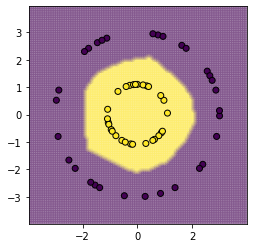

In [186]:
plot_model_prediction(lambda x: model.forward(x), X_test, Y_test)

# 3. Convolutions
## 3.1 Matrix convolution


There is a way to create a **locally connected** layer which will learn local correlations using a smaller amount of parameters.  
This layer is aptly called **Convolutional Layer** and is based on **matrix convolution**

A picture is worth a thousand words which is especially true when learning about convolution:
![Image convolution](./src/conv.png)

In image convolution, a **filter**, also called **kernel**, is applied to the source matrix.  
Each element from the kernel is multiplied by the corresponding element from the source matrix. The results are summed up and written to the target matrix.

In this example, the output matrix has a smaller size than its source\*. This is because the kernel can not overlap the borders. **Zero padding** can be used to retain the original dimension. It is a simple solution which involves adding a border of zeros to the input.

\* It may seem both matrices have the same size (both are shown with the same number of boxes. In the edges of the right matrix, however, no values are stored. The top-left corner of the right image starts where the $-3$ is placed.

The source matrix $X$ is of size $N \times M$ and the kernel $K$ is of size $(2p+1) \times (2q +1 )$.  
We define $X_{ij} = 0$ for $i > N, i < 1$ and $j > M, j < 1$.  
In (other) words: If you try to access a pixel which is out of bounds assume that it is zero.  
This is called **zero padding**.

Therefore, the convolution of a matrix with a kernel is defined as follows:
$$
Y = X \star K \\
Y_{ij} = \sum\limits_{\alpha=0}^{2p} \sum\limits_{\beta=0}^{2q}
K_{\alpha \beta} X_{i + \alpha - p, j+\beta - q}
$$

This operation's name depends on the field:
* In machine learning: **convolution**
* In mathematics: **cross-correlation**

Finally, its time for you to implement matrix convolution.  
You can use the example below this code block to test your implementation.

In [232]:
def conv_matrix(matrix, kernel):
    """Perform the convolution of the matrix 
        with the kernel using zero padding
    # Arguments
        matrix: input matrix np.array of size `(N, M)`
        kernel: kernel of the convolution 
            np.array of size `(2p + 1, 2q + 1)`
    # Output
        the result of the convolution
        np.array of size `(N, M)`
    """
#     print(matrix.shape)
#     print(kernel.shape)
#     print(matrix)
#     print(kernel)
    
#     output = np.zeros(matrix.shape)
#     zero_padded = np.zeros([matrix.shape[0]+2, matrix.shape[1]+2])
#     zero_padded[1:matrix.shape[0]+1, 1:matrix.shape[1]+1] = matrix
    
#     p=int((kernel.shape[0]-1)/2)
#     q=int((kernel.shape[0]-1)/2)
    
#     for row in np.arange(matrix.shape[0])+1:
#         for col in np.arange(matrix.shape[1])+1:
#             output[row-1,col-1] = np.sum(zero_padded[row-p:row+p+1,col-q:col+q+1]*kernel)
    
    
    height, width = matrix.shape
    k_h, k_w = kernel.shape
    
    p, q = (k_h - 1) // 2, (k_w - 1) // 2
    
    matrix_pad = np.pad(matrix, [(p, p), (q, q)], 'constant', constant_values=(0, 0))
    
    print(matrix_pad)
    output = np.zeros(matrix.shape)
    
    print(output)
    for i in range(height):
        for j in range(width):
            patch = matrix_pad[i: i+2*p + 1, j: j+2*q + 1]
            print(patch)
            output[i, j] = np.sum(patch * kernel) 
    
    print(output)

    #################
    ### YOUR CODE ###
    #################
    return output

Let's test the function with the following data:

$$
X = \begin{bmatrix}
1 & 2 & 3 \\
2 & 3 & 4 \\
3 & 4 & 5 \\
\end{bmatrix} \quad
K = 
\begin{bmatrix}
1 & 0 & 0 \\
0 & 1 & 0 \\
0 & 0 & 2 \\
\end{bmatrix} \quad 
X \star K = 
\begin{bmatrix}
7 & 10 & 3 \\
10 & 14 & 6 \\
3 & 6 & 8 \\
\end{bmatrix}
$$

We recreate the example data in Python to perform a local test run.  
Don't be confused by [np.eye](https://docs.scipy.org/doc/numpy-1.13.0/reference/generated/numpy.eye.html). It fills our kernel matrix with ones on the diagonal from top-left to bottom-right.

In [233]:
X = np.array([
    [1, 2, 3],
    [2, 3, 4],
    [3, 4, 5]
])

K = np.eye(3)
K[-1, -1] = 2
print(np.zeros(3))
print(K)

[0. 0. 0.]
[[1. 0. 0.]
 [0. 1. 0.]
 [0. 0. 2.]]


Run the following code block and compare the result with the example above.

In [234]:
print(conv_matrix(X, K))

[[0 0 0 0 0]
 [0 1 2 3 0]
 [0 2 3 4 0]
 [0 3 4 5 0]
 [0 0 0 0 0]]
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]]
[[0 0 0]
 [0 1 2]
 [0 2 3]]
[[0 0 0]
 [1 2 3]
 [2 3 4]]
[[0 0 0]
 [2 3 0]
 [3 4 0]]
[[0 1 2]
 [0 2 3]
 [0 3 4]]
[[1 2 3]
 [2 3 4]
 [3 4 5]]
[[2 3 0]
 [3 4 0]
 [4 5 0]]
[[0 2 3]
 [0 3 4]
 [0 0 0]]
[[2 3 4]
 [3 4 5]
 [0 0 0]]
[[3 4 0]
 [4 5 0]
 [0 0 0]]
[[ 7. 10.  3.]
 [10. 14.  6.]
 [ 3.  6.  8.]]
[[ 7. 10.  3.]
 [10. 14.  6.]
 [ 3.  6.  8.]]


In [235]:
am.test_student_function(username, conv_matrix, ['matrix', 'kernel'])

Running local tests...
[[ 0.        ]
 [ 1.44297693]
 [-0.95784239]
 [ 2.19761031]
 [-3.80013024]
 [ 4.4650435 ]
 [ 0.        ]]
[[0.]
 [0.]
 [0.]
 [0.]
 [0.]]
[[ 0.        ]
 [ 1.44297693]
 [-0.95784239]]
[[ 1.44297693]
 [-0.95784239]
 [ 2.19761031]]
[[-0.95784239]
 [ 2.19761031]
 [-3.80013024]]
[[ 2.19761031]
 [-3.80013024]
 [ 4.4650435 ]]
[[-3.80013024]
 [ 4.4650435 ]
 [ 0.        ]]
[[ 15.48458814]
 [ -7.99714849]
 [ 31.26517958]
 [-34.23077682]
 [ -7.98226671]]
[[ 0.        ]
 [ 3.00539628]
 [-8.5687909 ]
 [-9.32264742]
 [-7.95992638]
 [ 0.        ]]
[[0.]
 [0.]
 [0.]
 [0.]]
[[ 0.        ]
 [ 3.00539628]
 [-8.5687909 ]]
[[ 3.00539628]
 [-8.5687909 ]
 [-9.32264742]]
[[-8.5687909 ]
 [-9.32264742]
 [-7.95992638]]
[[-9.32264742]
 [-7.95992638]
 [ 0.        ]]
[[  51.45194247]
 [ -33.47334697]
 [ -89.19166862]
 [-104.42165578]]
[[ 0.          0.        ]
 [-1.15574712 -3.35584789]
 [ 9.84086357 -0.32191626]
 [-0.80050539  6.65292859]
 [-7.91329847 -9.11577452]
 [-8.67283634 -2.00239047

 [ 4.50917816  3.6355076   1.82507953]]
[[ 1.772497   -8.2702969   0.        ]
 [ 7.4207523   3.85552109  0.        ]
 [ 3.6355076   1.82507953  0.        ]]
[[0.         0.21761499 7.4207523 ]
 [0.         4.50917816 3.6355076 ]
 [0.         0.         0.        ]]
[[0.21761499 7.4207523  3.85552109]
 [4.50917816 3.6355076  1.82507953]
 [0.         0.         0.        ]]
[[7.4207523  3.85552109 0.        ]
 [3.6355076  1.82507953 0.        ]
 [0.         0.         0.        ]]
[[ -59.85958879  -92.28511952  -29.71517125]
 [ -35.52293976 -142.55110022  -33.70649798]
 [  47.09251627 -102.68038973  -41.29637721]
 [  68.97616314  -11.04507119   32.01342743]
 [  53.14866926   83.80216239   41.5259512 ]]
[[ 0.          0.          0.          0.          0.          0.
   0.        ]
 [ 0.         -7.65085773  2.28933111 -2.50272099 -2.75146596  3.4995686
   0.        ]
 [ 0.         -7.88932438  0.67240054 -8.04705819  5.05332599 -5.06721623
   0.        ]
 [ 0.         -9.58453021  5.78

 [ 0.        ]]
[[ 4.08501327]
 [-3.56814203]
 [ 0.        ]]
[[ 7.08131506]
 [-0.2165942 ]
 [ 0.        ]]
[[-80.41099357 -45.65165787 -86.84758106]
 [ -9.16715764 -98.44582916 -72.45789728]
 [ 34.37937349   2.73913291 -68.42390927]
 [ 48.57525538 -27.5368621  -52.42774019]]
[[ 0.          0.        ]
 [-2.22365459  7.49751389]
 [-2.82256703  8.25557915]
 [-7.59290866  7.12948482]
 [-9.34499463 -3.28030625]
 [ 0.          0.        ]]
[[0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]]
[[ 0.        ]
 [-2.22365459]
 [-2.82256703]]
[[0.        ]
 [7.49751389]
 [8.25557915]]
[[-2.22365459]
 [-2.82256703]
 [-7.59290866]]
[[7.49751389]
 [8.25557915]
 [7.12948482]]
[[-2.82256703]
 [-7.59290866]
 [-9.34499463]]
[[ 8.25557915]
 [ 7.12948482]
 [-3.28030625]]
[[-7.59290866]
 [-9.34499463]
 [ 0.        ]]
[[ 7.12948482]
 [-3.28030625]
 [ 0.        ]]
[[ 14.29069139 -36.04169972]
 [ 44.77381665  19.55307245]
 [ 30.78164085 117.32450226]
 [-95.01257052  19.37797301]]
[[-0.24441475  4.34592761]
 [ 0.13180032 -4.

## 3.2 Basic kernels

Matrix convolution can be used to process an image (think Instagram): blur, shift, detecting edges, and much more.  
This [article](http://setosa.io/ev/image-kernels/) (**recommended read**) about image kernels should give you a better understanding of convolutions. It happens to be interactive as well.

In convolutional layers, the kernels are learned by training on the dataset. However, there are predefined kernels, for example used on your Instagram photos. Some examples are:

**Sharpen Kernel:** 
$$ 
\begin{equation*}
\begin{bmatrix}
0 & -1 & 0 \\
-1 & 5 & -1 \\
0 & -1 & 0 
\end {bmatrix}
\end{equation*}
$$

**Edge detection filter:**
$$
\begin{equation*}
\begin{bmatrix}
-1 & -1 & -1 \\
-1 & 8 & -1 \\
-1 & -1 & -1 
\end {bmatrix}
\end{equation*}
$$

**Box blur of size 3:**
$$ \frac{1}{9}
\begin{equation*}
\begin{bmatrix}
1 & 1 & 1 \\
1 & 1 & 1 \\
1 & 1 & 1 
\end {bmatrix}
\end{equation*}
$$

Let's play with convolutions by manipulating an image of a dog.

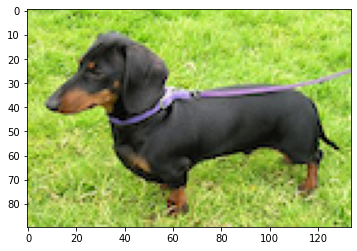

In [236]:
rgb_img = plt.imread('./images/dog.png')
plt.imshow(rgb_img)

Coloured images would require a 3-dimensional tensor to represent RGB (red, green, and blue).  
Therefore, we will convert it to grayscale. This way it can be processed as a matrix.

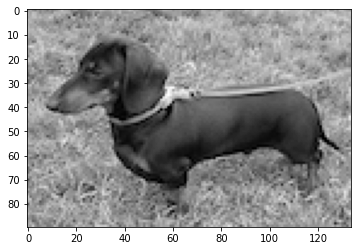

In [237]:
img = rgb_img.mean(axis=2)
plt.imshow(img, cmap='gray')

First of all, let's blur the image with [box blur](https://en.wikipedia.org/wiki/Box_blur). It is just a convolution of a matrix with the kernel of size $N \times N$ of the following form:

$$
\frac{1}{N^2}
\begin{bmatrix}
1 & \dots  & 1\\
\vdots & \ddots & \vdots\\
1 & \dots  & 1\\
\end{bmatrix}
$$

Every element of this filter is *one* and we divide the sum by the total amount of elements in the blur filter. You could understand it as taking the average of an image region.

**Description:**  
Perform the blur of the image.

<u>Arguments:</u>
* `image` - Input matrix - [np.array](https://docs.scipy.org/doc/numpy-1.13.0/reference/generated/numpy.array.html) of size `(N, M)`
* `box_size` - Size of the blur kernel - `int > 0` the kernel is of size `(box_size, box_size)`

<u>Output:</u>  
The result of the blur [np.array](https://docs.scipy.org/doc/numpy-1.13.0/reference/generated/numpy.array.html) of size `(N, M)`

In [238]:
def box_blur(image, box_size):
    """Perform the blur of the image
    # Arguments
        image: input matrix - np.array of size `(N, M)`
        box_size: the size of the blur kernel - int > 0  
            the kernel is of size `(box_size, box_size)`
    # Output
        the result of the blur
            np.array of size `(N, M)`
    """   
    k = 1.0 * np.ones((box_size, box_size)) / (box_size ** 2)
    output = conv_matrix(image, k)
    
    #################
    ### YOUR CODE ###
    #################
    return output

You can test your solution before submitting it. Running the following code block should yield this result:
$$ 
\begin{equation*}
\begin{bmatrix}
1 & 2 & 1 \\
2 & 4 & 2 \\
1 & 2 & 1 
\end {bmatrix}
\end{equation*}
$$

In [239]:
test_image = np.array([
    [9, 0, 9],
    [0, 0, 0],
    [9, 0, 9]
])

print(box_blur(test_image, 3))

[[0 0 0 0 0]
 [0 9 0 9 0]
 [0 0 0 0 0]
 [0 9 0 9 0]
 [0 0 0 0 0]]
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 0.]]
[[0 0 0]
 [0 9 0]
 [0 0 0]]
[[0 0 0]
 [9 0 9]
 [0 0 0]]
[[0 0 0]
 [0 9 0]
 [0 0 0]]
[[0 9 0]
 [0 0 0]
 [0 9 0]]
[[9 0 9]
 [0 0 0]
 [9 0 9]]
[[0 9 0]
 [0 0 0]
 [0 9 0]]
[[0 0 0]
 [0 9 0]
 [0 0 0]]
[[0 0 0]
 [9 0 9]
 [0 0 0]]
[[0 0 0]
 [0 9 0]
 [0 0 0]]
[[1. 2. 1.]
 [2. 4. 2.]
 [1. 2. 1.]]
[[1. 2. 1.]
 [2. 4. 2.]
 [1. 2. 1.]]


In [240]:
am.test_student_function(username, box_blur, ['image', 'box_size'])

Running local tests...
[[ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.        ]
 [ 0.          0.         -2.39873098  9.13019259  3.67420457 -0.3830906
   9.46615513  6.68317647 -9.46144236  2.6730254   9.97233645  0.
   0.        ]
 [ 0.          0.         -8.20809064  7.11118341  1.80017077 -6.09837281
   0.77788848 -5.49274005 -7.95971596  4.30797372 -5.57560186  0.
   0.        ]
 [ 0.          0.          1.44562402 -8.23199913 -4.92898443 -6.89161303
  -4.89419322  4.15107257  7.91571758  6.14269377 -6.86678993  0.
   0.        ]
 [ 0.          0.          1.61307061 -1.44611188  4.02751928 -3.71370762
  -0.11148008 -1.45898728  2.74118646 -5.52876592 -6.89450274  0.
   0.        ]
 [ 0.          0.         -9.70715595  9.95224584  2.77630388  5

[[-7.9698865  -1.69658722 -1.55164033 -1.79268214 -5.63998673  8.5575634
   6.61917763]
 [ 7.92951547 -8.06164925  0.62036241  9.41032044 -2.90447592 -7.16260727
  -1.31079047]
 [ 1.43195728  0.14109749  1.69732766 -1.8642733  -3.24132138  9.57666608
  -9.58519844]
 [-9.04971336 -1.65193308 -7.68927164  3.10018248 -7.78279518  2.20345017
  -2.17505433]
 [ 0.          0.          0.          0.          0.          0.
   0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.        ]]
[[-1.69658722 -1.55164033 -1.79268214 -5.63998673  8.5575634   6.61917763
   9.65630234]
 [-8.06164925  0.62036241  9.41032044 -2.90447592 -7.16260727 -1.31079047
   4.80707349]
 [ 0.14109749  1.69732766 -1.8642733  -3.24132138  9.57666608 -9.58519844
  -1.47464812]
 [-1.65193308 -7.68927164  3.10018248 -7.78279518  2.20345017 -2.17505433
   7.51681542]
 [ 0.          0.          0.          0.    

   0.          0.          0.          0.          0.        ]]
[[ 0.          0.          0.          0.          0.          3.71646758
   6.78331052 -9.95263212  1.72385812 -3.84328496  9.16255344]
 [ 0.          0.          0.          0.          0.          8.29731463
   7.070047   -2.07799058  6.31430997  6.23112279  6.28455489]
 [ 0.          0.          0.          0.          0.          9.8302834
   7.87672625  3.57033046 -2.79938375 -4.57852917  9.36766048]
 [ 0.          0.          0.          0.          0.          4.45374106
   1.83763191  9.59492959  1.49171424 -0.3161516  -5.53952709]
 [ 0.          0.          0.          0.          0.         -2.40109709
   4.84368611  1.89138809  7.32076241  1.81599153 -7.49145241]
 [ 0.          0.          0.          0.          0.         -1.70862391
  -9.32182377  0.69811299 -0.97545735  1.59224224 -7.07379606]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.        

   0.87999787]]
[[ 0.          0.          0.          0.          0.          3.31069682
   3.70874036 -2.10019288  9.74142228 -5.30845612  1.53704676 -4.85552331
   8.18005322]
 [ 0.          0.          0.          0.          0.         -2.88462936
  -5.78712401 -9.36171745 -9.3168418  -0.23270914 -3.2385377  -7.80600281
   9.87574407]
 [ 0.          0.          0.          0.          0.          4.79001244
  -2.19798176 -0.57950157 -7.65311035  4.77439715 -7.11171473 -3.01823536
   5.51085295]
 [ 0.          0.          0.          0.          0.         -1.09927833
  -7.68410054 -3.5733309   9.21529608 -8.90994202  4.46300369 -0.27870418
   2.60304107]
 [ 0.          0.          0.          0.          0.          3.26136857
   4.7920937   9.1704391  -7.93666075  9.5402663   7.77053441 -1.64073707
   7.74339801]
 [ 0.          0.          0.          0.          0.          3.07809759
  -0.7833899  -2.12776597  0.41604851 -7.06403056  7.53568589  8.50442824
  -9.10193985]
 [ 0. 

   0.        ]]
[[-5.54948697  7.53669663 -6.57673588  1.97455989  7.95929844  9.9178787
  -8.75132674  4.67140106  0.79819825  7.87405628 -4.66880278 -2.04463746
   2.10173431]
 [-4.13510429  1.14466782  2.36262042 -9.25533789  4.3985557  -0.82144212
   5.91828175  3.27403891  0.1745839   5.81240715  2.41856801  5.8178645
   2.61262467]
 [ 7.04366317  3.52139162  3.66438992  2.10047683  4.13146199  2.94778148
  -1.80877626 -9.87864881  1.52977393 -3.61958053 -9.73955198 -0.2656194
   1.49356811]
 [ 6.36131706 -6.76107184  0.27059859 -8.30937772 -2.98323754  1.74392503
  -3.50503308 -1.9675521   4.34720457  5.13596514  8.55532963  5.37177299
  -8.78190015]
 [ 6.00700701 -6.31534903  3.23796616  9.58263321  0.59209108  3.59332078
   0.87999787  0.44304343 -2.91842832  7.64575402  0.8030255   1.19321276
  -2.15486174]
 [ 3.9478193  -4.07661756  5.74594089 -2.261172    3.09077132  3.95686119
   9.92473952  3.82246949 -8.62486565  3.76937294  2.39636203  4.86920538
  -2.66049087]
 [ 8.9202

   1.22537258]]
[[ 0.          0.          0.          5.37235696  0.053263   -3.06713654
  -6.86380864 -5.38896099  5.31298579 -2.63397772 -3.81385004  2.59544265
  -8.57020252]
 [ 0.          0.          0.          0.18387762 -4.71103603 -9.28568907
  -1.70314658 -5.40444608 -5.60778198  1.47238658  9.48476533 -8.88172073
  -0.80464626]
 [ 0.          0.          0.         -2.84207809 -8.53874041 -5.00980277
  -2.55087885 -9.57346995  4.24019815 -4.74976114  0.442123   -0.73610037
  -8.61341167]
 [ 0.          0.          0.         -4.35432035 -4.22272833 -8.53462292
  -1.96458763  5.08924699 -4.93781937  2.19115798 -5.93464499 -3.40630204
   0.71298235]
 [ 0.          0.          0.         -8.91212639  9.09888661 -8.15064314
  -6.06533599 -9.45452479 -0.03281899 -1.01049073  7.0963618   1.05091458
  -2.77251502]
 [ 0.          0.          0.          6.35405112 -4.65850576  7.82121845
   2.58813262  9.13954547  1.39407467  1.76284264 -6.60076558  2.11619884
  -7.28666534]
 [ 0. 

   0.        ]]
[[-7.20424168  5.91523383 -1.37042803  4.81363775  8.2039454  -7.30771537
   7.29927974  3.26085675  0.14019395 -3.26301772  0.          0.
   0.        ]
 [-0.22111406 -0.8130155  -7.06415791  8.59918722  7.90241468 -0.34353413
   9.15806003 -6.26711605  4.00900149  5.75278477  0.          0.
   0.        ]
 [-1.78688028 -8.02722762  9.6514929   1.4135816   1.16562927  8.62721588
   0.51585758  8.2364077  -4.0455324  -9.54933813  0.          0.
   0.        ]
 [-2.11117932  0.6428295   0.09306938 -6.89888908 -3.68592201  8.67294636
  -4.51371397 -1.65444224  0.722789   -3.21391824  0.          0.
   0.        ]
 [-6.89505234  1.22537258 -3.7034758   2.6255213   8.90208061 -4.01279805
  -4.23965702 -0.55965077  3.448782    6.2629546   0.          0.
   0.        ]
 [-3.31724211  6.98373489 -2.65936713 -7.02234808  2.4972379   6.45213378
  -0.5314575  -4.25256658 -4.09405407  3.79542826  0.          0.
   0.        ]
 [ 7.73644249  8.64165121  1.13760656 -6.45682036  4.5

[[ 0.          4.29327216 -9.0496415  -3.12673215  3.40473865 -1.75253462
   8.07705623  2.28250786  3.22461025 -8.03530801 -0.87155637]
 [ 0.         -7.54182493  8.93687133  8.66634849  5.02761713 -0.21032385
   4.52997808  5.8187684  -9.53338684  4.82889928  7.02382546]
 [ 0.          2.63466     1.49590888 -9.41868058  4.07371204  8.49310629
  -5.43668505  6.35229425  9.51161013  6.46155785 -8.5105851 ]
 [ 0.          6.50803239  7.74996571 -1.26548346 -2.03283721  2.32840613
   1.59711345 -4.67455301 -7.52484974  9.52917394  2.33863802]
 [ 0.         -0.10816856  6.16206162  7.01851415  7.50273901 -5.13028578
   1.60822591  1.94811281 -6.61769752  5.76843629  3.63976634]
 [ 0.          7.92650561 -3.39181764 -3.46667442 -7.8205698  -5.20951143
   7.21877954  5.26379982  1.86173874 -6.20571815 -9.29394364]
 [ 0.         -1.85762952  4.95502015  6.549978    1.89062064  2.73023963
  -1.8005671   5.91795758  8.67794461 -6.93740213 -4.50360484]
 [ 0.          7.88600501  4.3237435   1.

[[ 3.67388806e+00  9.27058953e+00 -9.34837966e+00  1.48161837e+00
  -9.45323044e+00 -7.53835396e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00]
 [-7.64184400e+00  3.37832308e-01 -6.85775085e+00 -7.48589027e+00
  -2.16054773e+00  7.75799860e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00]
 [-6.55438381e+00 -2.79373620e+00  4.53531816e+00  2.37386832e+00
  -1.35865011e-01 -5.11702718e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00]
 [ 6.80000403e+00 -7.85084600e+00  5.18767287e-03  2.28894293e+00
   7.27686069e+00  6.26803907e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00]
 [ 5.96472853e+00 -7.08000429e+00 -3.52498288e+00 -5.04397620e+00
  -3.30225844e-01  7.65060530e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00]
 [ 8.12661540e+00 -8.18607681e+00  7.84001006e+00 -7.50200366e+00
  -8.56006034e+00 -6.12946221e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00]
 [ 3.98701319e+00 -8.53189659e+00 -5.80187163e-02  3.92678666e+00
  -2.22561457e+00  8.6164149

   0.        ]]
[[ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.        ]
 [ 2.79800076  9.26253572  1.15356303 -6.36634645 -1.89881819  9.29160894
  -1.17627078  4.635846   -2.30865217  0.          0.          0.
   0.        ]
 [-9.44202639 -5.57497088  5.44944294  8.3340015   4.57809998 -0.4043754
  -4.30918721 -5.26520917 -8.15677361  0.          0.          0.
   0.        ]
 [-4.02877564  0.51607995  3.73180992 -7.26266516  7.37079073 -8.94611409
  -2.74338436 -2.85767382  4.92878776  0.          0.          0.
   0.        ]
 [ 1.74802556 -1.14778901 -3.94518458  2.63010978  1.78722778 -1.31548444
   2.

  -0.75881363]]
[[ 0.          0.          0.          0.          0.         -2.79990379
   4.50678829 -6.81184509 -4.6129878   4.19946851 -1.59524915  2.13815062
  -2.52470866]
 [ 0.          0.          0.          0.          0.          7.832191
   1.73368445 -6.58069987  6.29483119  6.35077858 -3.16187071 -9.66295244
   2.67925002]
 [ 0.          0.          0.          0.          0.          0.78977768
  -7.16532979  4.8244324  -8.9937946   8.20786403  1.49370431  6.91743812
  -8.88854193]
 [ 0.          0.          0.          0.          0.          7.89807203
  -3.77274502 -7.082752    3.31178853 -3.37817685  5.81098569 -2.19141712
  -8.17301981]
 [ 0.          0.          0.          0.          0.          2.3463698
   2.77525233 -3.31457971 -7.63754264  5.01636782  2.8840992  -8.96303418
  -7.86175585]
 [ 0.          0.          0.          0.          0.          2.88376982
   4.58673231  7.0052356   7.41941958  1.60893765  3.46663738 -0.69579706
   7.2720358 ]
 [ 0.    

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[-8.96024921  7.0784348  -8.47332469  5.72611798 -9.50610159 -8.39454304
   0.          0.          0.          0.          0.        ]
 [ 5.6778962   5.91237177 -3.58668732  4.48688522  3.89950609 -6.61252053
   0.          0.          0.          0.          0.        ]
 [ 8.93173314  5.44470645 -3.40744846  4.68834159 -9.1568162   4.28959645
   0.          0.          0.          0.          0.        ]
 [ 3.5065998   5.91916697 -4.16281733 -2.06770749  7.04021653  7.98448128
   0.          0.          0.          0.          0.        ]
 [ 3.3743812   4.55078674  3.2294145  -7.13090436 -4.38364901 -6.94043144
   0.          0.          0.          0.          0.        ]
 [ 0.70550982 -3.21216613 -4.47621383  1.90712064  4.71567524 -0.40626271
   0.          0.          0.          0.          0.        ]
 [ 6.94744106  2.87617752 -5.47729892  3.55374211  6.08044019 -8.17854315
   0.          0.          0.          0.          0.        ]
 [-0.67367229 -0.78445494  6.43795384 -3.

[[ 0.7565249   2.5060614  -0.67367229 -0.78445494  6.43795384 -3.11021656
  -4.19393927 -9.85452587  0.          0.          0.        ]
 [ 2.22075962 -8.06780205  7.44360161  4.15212154 -3.48362325 -5.49603594
   2.09771896 -7.10592703  0.          0.          0.        ]
 [ 5.75350623 -1.52993252 -9.8340416   0.92503433 -1.74074671 -3.85976172
   4.63248153  8.69912192  0.          0.          0.        ]
 [ 4.32603767  3.92863464 -6.40958627 -8.0863624  -0.5900749   4.08195913
  -9.87514049  2.13611526  0.          0.          0.        ]
 [ 4.99342067 -4.01417591 -9.24084134 -6.82494981  7.58800008  8.83694468
  -0.20459621  8.43766238  0.          0.          0.        ]
 [ 4.77385429  3.7266369  -8.53208495  9.97351603  7.7379304   1.69711082
   1.53127491 -6.59854803  0.          0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.        ]
 [ 0.          0.          0.          0.        

   0.          0.          0.        ]]
[[-1.26220588 -9.81393105  7.39470638 -6.34857926  5.64207284  8.1651921
  -6.78495342  3.98905141  7.04863918]
 [ 8.43932773 -2.90521826  0.09083226  2.85136225 -7.08412407  8.72505538
   7.2112877  -2.39317514 -2.1053249 ]
 [-0.625922    1.14019335  5.25216502 -4.12584057 -9.3541748  -8.54548421
   3.13708938  8.3981725   5.51208607]
 [-6.40139464  5.2080453  -7.15308883  8.79678228  0.30040562  3.9368306
   3.41709605  5.4984372   4.30939881]
 [-8.86712155  1.22212992  4.47241854 -4.01824101 -9.67188974  0.86815702
   1.88533451  9.24682273  6.49802557]
 [-2.73483453  1.26385532  2.56984386  2.87210727  8.59267436 -9.24147361
   2.94248601  5.01524251  0.81579535]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.   

[[ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.        ]
 [ 5.32783206 -4.62441045 -1.04387548  7.58664301 -6.86958648  6.11245754
   1.32920791 -6.39960854 -5.22931848  9.13730293  6.06574133 -5.2647795
   9.68041294]
 [ 2.04081988 -1.72664933  2.07948512  8.53678279 -0.58995232  8.13717
  -2.06717803  7.37737139  4.49685616 -0.25893178  1.96487696  7.36926096
  -1.17878987]
 [ 3.66482101 -1.84869597 -8.83537914  1.16887213  2.15193745  0.11206033
   5.97623148 -9

[[ 1.32920791 -6.39960854 -5.22931848  9.13730293  6.06574133 -5.2647795
   9.68041294  0.          0.          0.          0.          0.
   0.        ]
 [-2.06717803  7.37737139  4.49685616 -0.25893178  1.96487696  7.36926096
  -1.17878987  0.          0.          0.          0.          0.
   0.        ]
 [ 5.97623148 -9.62385048  0.77377259  0.13013755 -4.18274796 -6.78751409
   0.41240417  0.          0.          0.          0.          0.
   0.        ]
 [-9.42585913  4.19392331  6.43650443 -7.29025314 -3.68282814  4.65390399
   1.0433248   0.          0.          0.          0.          0.
   0.        ]
 [-2.92737609  3.57423694 -5.20708494  5.84274366  8.45144031 -4.20115028
   1.55687904  0.          0.          0.          0.          0.
   0.        ]
 [ 6.65886309  8.24172934 -0.82592368 -7.48394441  5.89390044  8.40232727
   5.92779098  0.          0.          0.          0.          0.
   0.        ]
 [ 0.40341717 -0.67063711 -3.80141154 -4.82107486 -7.48058124 -3.259164

[[ 6.50690056  0.54770215 -3.50849766  1.75227421  0.81028546  7.57126191
   7.86121895 -6.97144051 -7.6165352   0.8845461   6.65886309  8.24172934
  -0.82592368]
 [ 4.86016257 -1.27751939  6.08258269  5.91587938 -1.61500575 -9.74467391
  -9.12115937  4.11831994  0.35684918 -1.7977799   0.40341717 -0.67063711
  -3.80141154]
 [-1.12184582 -9.78935491 -4.80025709  8.26001979 -3.52708184 -0.35473091
   4.01785196  0.50548101 -0.69938954 -7.15151828  6.59578314  2.33108698
  -8.23339638]
 [-7.10486154  2.3678923   9.07436718  6.84636071  2.63510496  9.08874043
  -3.77058537 -2.64649168 -2.89146552 -7.04981038  5.53090307  9.15080627
  -8.37785503]
 [-7.40008225 -6.17324509 -0.18881668  4.7600943  -9.45331802 -3.29757873
   3.31595429  3.81294065  6.67109511  6.84342291 -4.13813461  0.89659957
  -7.49158114]
 [ 8.5799843  -9.73090249 -3.92512545  9.75548075  0.91041721  8.82612905
   3.61108194  7.09082098 -9.58015038 -0.73899813 -6.06035701  6.96209978
   8.51884546]
 [-7.33118164  7.49116

   8.58844478  2.69575227  1.13411582]]
[[ 0.          0.          0.          0.          0.          0.
   0.          0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.        ]
 [ 0.          1.84656144 -8.44479644  0.92387723 -1.73760472 -6.12510158
   5.10609327 -3.23105161 -8.42714169]
 [ 0.         -8.56273882 -4.88760715 -9.52178294 -6.76753084 -3.82578607
  -2.7359557   5.46007407 -0.30683087]
 [ 0.          8.8726882  -0.26945117  8.69918903  4.81674323  2.20360855
  -6.05209926 -2.10259369 -2.53532233]
 [ 0.          5.35002716 -8.61698685  7.71220289 -7.81935048  2.75044554
   3.07914425 -7.04246079  1.73389091]
 [ 0.         -0.64912633 -1.39242785 -2.5576979   1.37189438  8.58844478
   2.69575227 

[[ 0.          0.         -1.82840681  8.62397984 -5.58820925  5.04070564
   9.86255154  0.66484355 -1.99272036]
 [ 0.          0.          5.01064573 -7.35905209  5.76426804  3.34861502
  -7.09249442  0.36267518 -3.09128407]
 [ 0.          0.         -6.40956547  9.88211089  4.10567655 -3.56253784
  -1.93406652 -6.22631642 -4.24011338]
 [ 0.          0.         -1.02482907  3.04402823  3.0605734   7.79139866
   4.94235423 -6.32853506 -2.02037363]
 [ 0.          0.          0.33545617  0.7084808   8.95140603 -8.91827638
   3.79993607 -2.92398763 -0.97791092]
 [ 0.          0.          7.24306925 -7.25492217  8.13878316  9.90242656
   1.83634612  4.25099969  1.49359719]
 [ 0.          0.         -3.27803479  3.88974008  4.17561463  7.32331084
  -7.08524373  0.13829281 -3.45811376]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.        ]

  -4.31983273  4.7999219  -5.63991224  3.95359734 -3.83513786]]
[[ 0.          0.          0.         -5.05868772  5.87696376 -5.77397628
   0.46768299  0.59860255  2.41249537 -2.21020516 -8.28992802]
 [ 0.          0.          0.         -8.18967972 -8.62604218  4.35778124
   8.09475113  1.6725889  -6.94174816  4.95225212  7.44946961]
 [ 0.          0.          0.          4.10209222 -1.06198266  0.68383468
  -4.58344102 -8.1455719   2.9784345  -9.36472452  4.11323596]
 [ 0.          0.          0.         -8.42066499 -4.85274837 -9.39264272
   8.96545943  0.20475187 -6.75705203  0.79233059  3.44594034]
 [ 0.          0.          0.         -5.28048985 -2.18582322 -9.79650291
  -2.40900909  8.95161847  8.59349959  0.45361401 -5.60481808]
 [ 0.          0.          0.          2.5668811   2.91953466  3.00988767
   6.97979173  4.29611254 -3.61988602 -3.33075466 -7.1521182 ]
 [ 0.          0.          0.          1.496119   -3.05469993  8.96720606
  -0.40333419 -7.79072981 -0.44701412 -1

   7.28257579]]
[[ 0.          0.          0.          0.         -9.19726797  2.34969518
   3.17975139 -2.41014489 -5.44995553  3.56937567 -4.18923637 -4.17964036
   8.13606257]
 [ 0.          0.          0.          0.         -4.02513597  2.99955886
  -5.85809852  9.03398262 -9.90732235 -5.28213446  7.37269243  5.00511575
  -2.63205794]
 [ 0.          0.          0.          0.          2.44045025 -0.86488313
   3.33844035 -3.95171442  9.00515472 -9.18252194 -1.47572097 -7.36300006
   7.13301477]
 [ 0.          0.          0.          0.          4.8411835  -3.15429396
  -4.93108581  7.93920601  5.88393151  8.62457315  3.55467294 -6.9793647
   8.58521958]
 [ 0.          0.          0.          0.          6.9262529  -2.79486437
  -9.25895086  6.41611143 -5.25721185  0.22132317 -1.66396214 -2.39150738
   8.22009119]
 [ 0.          0.          0.          0.          8.45587818  4.11402062
  -6.79768115  6.62152896  1.62399196 -4.87716237 -5.15917668  1.77615336
  -8.23464041]
 [ 0.  

   8.31205633]]
[[ 0.          0.          0.          0.          0.          0.
   0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.        ]
 [ 0.         -6.7574119   2.71582596 -6.27114267  9.26800984  2.88243538
  -9.26500039]
 [ 0.         -8.82154522  0.64853511  0.1426504   9.61926045  4.86958738
  -6.52201081]
 [ 0.          4.93582415 -7.96597613 -0.17156413  4.33377893 -6.92883054
   0.01457999]
 [ 0.          9.42379663 -5.80965033  6.5024895  -6.07551835 -5.78210093
   4.16686358]
 [ 0.          3.34665294 -8.91212659 -6.30646114  5.10396698  8.31205633
  -8.75320024]]
[[ 0.          0.          0.          0.          0.          0.
   0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.        ]
 [-6.7574119   2.71582596 -6.27114267  9.26800984  2.88243538 -9.26500039
  -5.09026892]
 [-8.82154522  0.64853511  0.1426504   9.61926045  4.86958738 -6.52201081
  -0.4010185 ]
 [ 4.93582415 -7.96597613 -0.1715641

   0.00000000e+00]]
[[ 0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00]
 [-2.19224070e+00  8.48679143e-01 -6.93108969e+00  9.87745451e+00
  -5.58764621e+00  6.08230190e+00  3.71573945e+00  9.21313765e-01
  -2.91909236e+00 -5.63356606e+00  3.49497331e+00  0.00000000e+00
   0.00000000e+00]
 [-4.37966693e+00  8.48297956e+00 -1.43776010e-02 -4.62835539e+00
  -2.70571674e+00  8.19240377e+00  4.92569764e+00 -2.44727073e+00
   8.06373342e+00  8.41019942e+00  3.33550817e-01  0.00000000e+00
   0.00000000e+00]
 [ 5.76090421e+00  7.03212836e+00 -4.78892311e+00 -1.34295829e+00
  -6.92365206e+00 -3.05586643e+00  3.57514168e

   0.00000000e+00]]
[[ 9.88779498e+00  6.51923523e+00 -1.91676035e-01 -7.49016396e-03
   1.40513901e+00 -7.10705095e+00  4.22443314e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00]
 [-4.17045430e+00 -8.98481320e+00  2.99649586e+00 -2.68656245e+00
  -8.85275774e+00  7.93758231e+00 -2.81644589e-01  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00]
 [ 9.16596867e+00  5.46319131e+00  6.28513543e+00 -5.23047287e+00
   4.61743467e+00  8.14470710e+00 -5.36341508e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00]
 [ 9.62191712e+00  8.07691327e+00 -6.18976859e+00  1.24032875e+00
   1.93627968e+00 -9.42704961e+00 -9.22150401e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00]
 [-9.17193766e+00  1.00794645e+00  2.95303053e+00  2.35288028e+00
   1.32998149e+00  1.94754088e+00  4.52994753e

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[[-3.50140605 -4.4301648  -8.65533481  0.06254581 -3.00960581  9.80787027
  -9.09249888  6.30897384  8.51259795  3.51938826  6.11574588]
 [ 4.82578424  0.36910164  2.66624258  1.8590482   9.40714567  8.0765247
   5.38603597  0.51728645  9.61497569 -5.9780106   3.77863671]
 [ 8.96051025 -7.29353884 -1.60947673  5.74418572 -6.96019902 -0.18802855
   9.80102916 -2.03241094  9.60228379  9.79582638  5.57110713]
 [ 5.80241685 -5.03276255  0.99675842  2.9865853  -9.50043282  6.80673594
  -9.83389935 -0.06457333  4.9655785  -8.45391607  5.69577672]
 [ 4.70379725 -2.09734095  5.8877347   3.58157535 -4.98843133  2.94901301
   8.53830579 -6.54891331  7.75469946  3.15368587  6.61378683]
 [ 3.93262024 -7.06030128  2.17597111  4.83029708  1.08357945 -1.66821712
   4.82113102 -1.38932327  3.28927631 -9.63717731  4.745711  ]
 [ 6.84785928  1.91798551 -6.01581372  2.38620073  8.28469294  5.87643903
   0.80701883  0.01844002  1.64823087  6.98450211  8.46927042]
 [ 0.          0.          0.          0.

   0.        ]]
[[ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.        ]
 [-6.4347277  -3.94878568  0.58430317 -0.7670614   1.95665607 -2.0424652
  -9.49509874 -6.88943932 -7.0540316   0.          0.          0.
   0.        ]
 [-2.65341414 -9.86398762  3.06256932 -3.14729283  3.1071862   8.17740521
  -2.22921016  6.61468654 -5.91116294  0.          0.          0.
   0.        ]
 [-9.17969231  4.51723583 -1.36752575  3.53543612  4.03753268  1.53371697
   4.09276779 -1.68778694 -9.07872633  0.          0.          0.
   0.        ]
 [ 2.40256973 -1.06957399 -3.68774091  6.08242367  4.45659665 -9.08308062
  -9.1047736   6.45631233 -3.7755603   0.          0.          0.
   0.        ]
 [ 2.39912437  7.03221588 -5.4219315  -1.01002524  9.45747512 -2.902975

   0.        ]]
[[ 4.28439969 -6.22402295 -7.58510364  3.07469085 -3.38482211  4.88854872
   4.03535147  0.          0.          0.          0.          0.
   0.        ]
 [ 2.20359297  3.01628516  9.3876662   8.28995453  0.3880361   5.70603412
   9.77466796  0.          0.          0.          0.          0.
   0.        ]
 [-2.63354544  4.68160477 -6.87366595  3.23575323  4.08894561  0.01484974
  -6.06105456  0.          0.          0.          0.          0.
   0.        ]
 [ 9.8299738   6.50102643 -9.79789366 -1.32955241 -5.98896726 -2.7211678
   1.42267168  0.          0.          0.          0.          0.
   0.        ]
 [-6.42815587  4.26694521 -3.83178735  1.19133805  4.39146617  6.31294387
   3.81920633  0.          0.          0.          0.          0.
   0.        ]
 [ 1.28118837 -1.36316971 -0.07568567 -1.16194928  1.17782966 -4.93942449
   7.139281    0.          0.          0.          0.          0.
   0.        ]
 [ 1.72415395  9.92894364  6.84964374  6.11526151 -3.64

   0.          0.          0.        ]]
[[-7.50981767 -4.66148326  7.89645581  5.97776023  8.43053693 -4.13561978
   0.          0.          0.        ]
 [ 4.43954555  3.31890603 -4.80446776 -0.25704329  1.74672919  5.93942427
   0.          0.          0.        ]
 [-1.35118859 -2.40576782 -1.48546292  3.75311218 -1.01273178  5.1789315
   0.          0.          0.        ]
 [ 8.00535456  3.97114659  2.08018666  2.66761429 -1.47126705  1.8502714
   0.          0.          0.        ]
 [-5.07394082 -0.73169033  0.89571654  6.6944417   6.86496849  3.16777179
   0.          0.          0.        ]
 [ 4.89501298 -9.98554418 -3.6959192   4.10433788  5.32564971  8.69166327
   0.          0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.   

   0.        ]]
[[ 2.21521111 -7.28070414  8.89776003  7.51833519  9.455824   -6.37551265
   2.0443163 ]
 [-5.53391482  7.6243623  -2.15847601 -9.62136066 -6.80434237 -8.03932786
   6.82990594]
 [-1.62776076 -2.84248942  0.73115265 -2.20734908  8.43964096  7.77195848
  -3.40205641]
 [ 7.26881668  9.75103519  7.63517985 -5.32920455 -5.90882863  1.31632578
   7.1868333 ]
 [ 2.32055589 -8.55594544  0.32290738 -6.22029276 -6.47904962  6.14650404
  -2.97827814]
 [ 8.25900537 -2.69595785 -6.43378717 -2.05886344  1.09300517  9.847218
   5.64413815]
 [ 0.          0.          0.          0.          0.          0.
   0.        ]]
[[-7.28070414  8.89776003  7.51833519  9.455824   -6.37551265  2.0443163
  -8.95778063]
 [ 7.6243623  -2.15847601 -9.62136066 -6.80434237 -8.03932786  6.82990594
   0.13509511]
 [-2.84248942  0.73115265 -2.20734908  8.43964096  7.77195848 -3.40205641
  -6.39525494]
 [ 9.75103519  7.63517985 -5.32920455 -5.90882863  1.31632578  7.1868333
   7.92066517]
 [-8.55594544  0

  -3.63594679  0.          0.          0.          0.        ]]
[[ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.        ]
 [-9.03515651  7.07046525 -0.16273635 -1.7324415  -3.1463244   4.24468142
   0.          0.          0.          0.          0.        ]
 [-4.73510536  0.29646308 -8.39033764  4.17436104  9.07701738 -3.41492812
   0.          0.          0.          0.          0.        ]
 [ 0.29199038  0.14302578  2.82382695  1.99881176  1.44945842 -6.37781455
   0.          0.          0.          0.          0.        ]
 [ 9.02873082 -6.36184192  4.55669446  2.40169111  5.12034349  0.04634787
   0.          0.          0.          0.          0.        ]
 [-6.62622233  5.92701803  4.86196268 -8.17112607 -9.67899259 -3.10171056
   0.          0.          0.          0.          0.        ]
 [-6.67055152 -5.12338985  7.2495909  -4.07438746  7.42237224  5.38641578
   0.          0.          0.          0.       

   8.63393949  5.03986442 -3.52308695 -1.72142979 -5.65902592]]
[[ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.        ]
 [ 0.          0.          0.          0.         -9.3414733  -5.17481172
   8.82467293  3.72328433  2.93801027  5.37633655 -5.29392183]
 [ 0.          0.          0.          0.         -2.01418666 -6.04947706
   4.47671259  5.79974443  0.53083895  9.42450446 -4.07189058]
 [ 0.          0.          0.          0.         -0.95406037 -7.28528909
   6.60851284 -8.45041862 -3.71655671 -6.89587229  2.35194912]
 [ 0.    

  -2.25785843  4.87771571 -1.7901475  -6.45481122 -0.78297852]]
[[ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.        ]
 [-1.10586979  8.63900076 -8.63570936  9.92888645  5.17107244 -2.88624774
  -5.83344303 -4.25254796  4.21662106 -0.31487436 -4.28644767]
 [ 8.1987292   7.53732984 -7.61792443 -4.3749522  -6.4568492  -4.47950459
   9.99567312 -7.93769795 -3.14043046  8.99105854 -0.46386054]
 [-3.03679541  8.

   0.          0.          0.          0.          0.        ]]
[[ 8.92140875  6.87071466 -4.33481972  0.07421156  3.18397525  6.21554004
  -0.13836301  3.84774244  3.75401775  5.28992167 -9.56421358]
 [-0.68596848 -1.84729042 -9.08787386 -3.74683311 -9.81432012 -8.794873
   4.34463509  9.17060553  0.67998524 -5.29172893 -2.14081153]
 [-4.15958916 -8.06487802  4.41644258  5.37223987 -5.80548019 -7.0060029
   9.60946189 -1.10543663  0.91450073  3.28351785 -7.97857781]
 [-8.00434822 -9.84539788 -2.92823454 -7.09953586  0.34983893 -6.6874445
  -6.52858477 -0.40196444 -8.58428744  6.1746835   4.83837902]
 [ 8.16344375 -6.22414716 -4.30293501  6.31583446 -3.09956932 -9.44597859
  -3.49981325  0.41697477  9.54820304 -2.9575035  -7.52814163]
 [-7.93853708  2.97853749  4.87544873  4.76424274 -3.73619129 -0.02120552
   2.3504435  -4.28710252 -4.4484368  -6.3602473   9.4829716 ]
 [ 6.12770089 -2.40806735  9.97717381  6.59645375 -1.56640978  8.45137379
  -0.87515814 -4.10793011 -3.83777616  1.212

   0.          0.          0.        ]]
[[ 7.87551143  6.34354439 -9.29572515  2.2919547   0.35894107 -9.04926214
  -4.25271709 -5.95487391 -2.63429858]
 [-1.88502974  9.82896336 -0.44054043 -4.03795191 -3.43972708  1.24772099
   4.60148617  6.94979015 -2.44205766]
 [-7.98824351 -5.5605769   6.88993857 -8.94400786 -8.63587487 -0.06934675
  -4.29149028 -7.72760155  9.63070423]
 [ 4.34545051 -4.07221191  4.254071    8.29610317  0.34445526  5.09696164
   6.42954317  7.30227672  2.45426117]
 [-9.29118926 -8.95744701  0.5664337   5.25659883  2.43009231  6.77182081
  -0.22679337  1.57698164 -8.62630951]
 [-0.17962318 -5.28263791  9.07446483  2.64717994 -6.56945042 -2.89608974
   2.6367316   6.15521432  7.39515454]
 [ 1.79130507  9.04607384 -4.48836953  2.8979746   2.4517919  -1.77212661
  -7.7341256  -7.83273504 -4.2969252 ]
 [ 4.50239853  3.62033603  4.5420963   9.95729126 -2.6169138  -8.36355643
  -5.78762164  0.60789174 -9.84171161]
 [ 0.          0.          0.          0.          0.   

   7.54642305  2.94636458 -4.1380615 ]]
[[ 0.          0.          0.          0.          0.          0.
   0.          0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.        ]
 [ 0.          0.          7.9775212   9.50058485 -7.36123954  1.53155682
  -3.00239752  6.63431513  7.28292656]
 [ 0.          0.         -0.07896889  8.98232257  4.45489357 -1.07776031
  -0.67540806  6.54185996 -5.86755943]
 [ 0.          0.         -1.64117629  6.39309856  4.26265867 -6.30477257
   3.54795965 -5.51456047 -4.92341652]
 [ 0.          0.          4.20405813  1.91316073 -4.1133605  -2.7878844
  -6.29586193  1.60394499  7.50183508]
 [ 0.          0.          3.40719406 -5.55359217 -7.15168688 -0.41474157
  -5.74617316  6.55890865 -7.45349452]
 [ 0.          0.         -6.46923682  2.6612781  -2.8064054   7.54642305
   2.94

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[[ 0.          0.          0.          0.          8.62486365 -2.71236881
  -4.2981009   0.12731166 -1.59853256 -3.61297466  6.47310535]
 [ 0.          0.          0.          0.          0.67793573  9.85825298
  -1.34185099 -2.09652908  5.63223242  8.12144373 -1.6300244 ]
 [ 0.          0.          0.          0.         -6.79672062  1.80311256
  -8.43386195 -9.91797189 -7.92323136 -1.85849819 -6.44632025]
 [ 0.          0.          0.          0.         -9.01704731  0.04786355
   9.62518792 -7.89045493 -6.81861571  8.05981385  2.31034687]
 [ 0.          0.          0.          0.          1.90935098  4.53440285
  -2.70337472  8.74310699  8.85366105  4.81238169 -1.56255948]
 [ 0.          0.          0.          0.         -1.1477223   5.45901273
   7.46760296 -0.7115713   1.11133953  0.09334841 -3.79934872]
 [ 0.          0.          0.          0.          6.80330317 -2.45648199
  -9.03428911  3.0008273  -6.79590419  5.16618812  2.30053235]
 [ 0.          0.          0.          0

  -5.49296256e+00  9.56926929e+00  4.07133816e+00]]
[[-3.46994155e-01  3.15452778e+00 -3.58876351e-01 -7.28107280e+00
   2.90900612e+00 -4.34972027e+00  5.98985788e+00]
 [ 9.61720342e+00 -1.76669433e+00  4.81144012e+00 -6.93251546e+00
   1.92649659e+00 -2.80719216e+00 -7.89663458e+00]
 [ 8.72798692e+00 -9.34090860e+00  6.72750222e+00  4.54994616e+00
   8.08437427e+00 -8.05243170e+00 -9.44974421e+00]
 [ 5.30675545e+00 -8.73917782e+00  7.04474225e+00 -5.01167467e+00
   4.95079114e+00 -3.76391325e+00 -3.97480376e+00]
 [-8.79540540e+00 -2.50670721e-01  3.65948093e+00  7.04183428e-03
   1.20297932e+00  1.30630413e+00  9.97833089e+00]
 [-2.47063847e+00 -6.18995708e+00  3.14490030e+00 -5.21135546e+00
  -3.50472299e+00 -7.30099523e+00 -7.92667688e+00]
 [-9.28792600e+00 -7.71296618e-01  4.44933271e+00 -5.49296256e+00
   9.56926929e+00  4.07133816e+00 -2.90222450e+00]]
[[ 3.15452778e+00 -3.58876351e-01 -7.28107280e+00  2.90900612e+00
  -4.34972027e+00  5.98985788e+00  0.00000000e+00]
 [-1.766694

  -9.18013147  1.39108747 -5.89372019 -3.18539259 -6.18394804]]
[[-2.99777723  3.39089991 -9.46360262 -4.92447091 -5.15106269  8.73298597
  -6.44076597 -0.73072492 -0.07619137  2.01076107 -8.49281156]
 [-7.50120962  5.45257982  6.1361008  -5.68315145 -1.89191169 -0.16684028
   6.22575637 -1.9652719   1.98471032 -0.89612787 -9.70928005]
 [ 5.79605106 -5.42793136  5.42671709 -8.24564729 -7.31080562  7.09816231
   0.79015637  7.67937526 -2.02023542 -9.16836647  6.9414676 ]
 [ 9.15918433 -5.20944606 -5.96434185 -7.46542056 -1.79620417  5.37414257
  -4.26348352  1.99206695 -2.51170828  9.31770377 -2.10982222]
 [-3.21811665 -6.98297033 -1.22691421  4.99307906 -8.73533514 -6.12012719
  -1.31443897  7.72044461 -3.45894594  1.06148764 -3.48566498]
 [ 0.7632462   0.61067092  7.4846192   4.74955111  9.88050259  5.23433275
   8.15259547  5.21906989  5.01768364  4.54664619  1.88930448]
 [-0.83293877  7.60293825 -0.68805429 -2.92889557 -2.88103513  1.09082883
  -3.26025683  2.72554187  2.316249    1

   4.25824014]]
[[ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.        ]
 [ 0.          0.         -1.73252236  2.08716626 -0.01268807 -4.51284299
  -4.21209834  6.19204218 -8.33555922  7.63225982  1.59010448  1.67706849
  -6.818373  ]
 [ 0.          0.          2.30855637 -9.02637947  7.89598702 -1.80258253
  -8.91805972  1.30418574  5.62025787 -4.881068   -1.47200751  6.14545365
  -5.39380247]
 [ 0.          0.         -1.6617032  -5.78881112 -2.14852476  7.71960057
   1.41150853  9.61233163  6.56784894 -8.95051578 -9.92884575  0.79315317
  -8.5454325 ]
 [ 0.          0.         -8.60516507  1.31638679 -5.32009074  3.73622759
  -6.86401915 -6.87493059  3.68119396 -1.16904254 -0.16877198 -8.32590686
  -2.13256438]
 [ 0.          0.          3.42531795  9.76242543  2.35802592 -5.19746914
  -4.21097561 -6.46372183 -3.08293151  2.18632768  1.23701484 -2.95763226
  -8.86793931]
 [ 0.          0.     

[[-6.16924281  1.99725047 -1.98276068  3.16071804 -1.01561225 -5.38143478
   4.91590823  1.10613457 -4.67794149 -3.50373277  0.          0.
   0.        ]
 [-3.5782565   1.76647066  8.8754324  -9.89178214  2.76940461  7.52638523
   7.08465934  6.51903204  6.43401331 -9.80296604  0.          0.
   0.        ]
 [-0.17664739 -1.98697863 -6.20180544  3.34103099 -8.3219412   7.15393051
  -3.89806969  8.0705871   6.8442915   3.30408829  0.          0.
   0.        ]
 [-5.22640227  5.06598511 -4.36621819  2.95012321 -6.61060217 -8.41929162
  -6.19737933  9.69375204  5.78610586 -8.0460905   0.          0.
   0.        ]
 [ 1.57713182 -2.73691443  9.49546927  4.25824014  6.84822627 -1.32489658
   7.79543561 -1.56971083 -7.32166883 -2.27675498  0.          0.
   0.        ]
 [-0.49551785 -2.73081851 -2.52580932  9.8845959  -2.15150962 -4.17531798
  -2.61810016 -2.7171752   9.09618466 -4.89421522  0.          0.
   0.        ]
 [ 7.00385659 -7.90502831 -2.12965688 -6.81347941 -9.51875869 -5.85845

   9.88197077]]
[[ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.        ]
 [ 1.95043674  9.71574777  0.28631761  1.07437823  2.02553838  8.79385586
  -5.28906929  4.65953532  3.14859009 -2.33867746  5.27099405 -1.11166064
   0.        ]
 [ 1.91941824  7.66879725 -0.34491945  6.10178173 -3.93770278 -9.05542285
   2.44238622  7.72164072  1.142986    7.28551681  7.62537008 -3.73381057
   0.        ]
 [ 0.68950784 -5.65235192 -5.21399349 -9.15532703 -0.5173762  -1.35886065
  -3.21102841  9.45918276 -6.84114108 -1.31298751  8.49768302  3.98129918
   0.        ]
 [ 3.70757145 -7.83954922 -2.2961999  -2.56671932 -2.00151764 -7.96112927
   0.38480993  8.47424204  8.22757428 -3.38167763 -2.02968437  6.86586802
   0.        ]
 [ 5.17248062  4.5298263  -7.86078785 

   0.        ]]
[[-4.40341625 -3.17462151  8.11385942 -1.41197325  6.76191516  6.61639153
   6.9954729  -3.92569222  0.          0.          0.          0.
   0.        ]
 [ 7.72879982 -7.40990535  6.9685504  -4.99155577  9.84792247 -5.7413608
   5.53843634 -6.96039638  0.          0.          0.          0.
   0.        ]
 [ 2.21568251  6.76412256  5.996918    9.78998229  8.93222812  8.98280474
   0.04115125 -8.33131812  0.          0.          0.          0.
   0.        ]
 [ 6.14737411  2.34777866  3.45792028 -3.0327904   3.97621999 -1.67589708
   7.67544047  2.46613152  0.          0.          0.          0.
   0.        ]
 [ 9.47614088 -3.68084364  4.14056099  8.73813157 -7.24160682 -6.17668966
  -9.98065292  0.36679268  0.          0.          0.          0.
   0.        ]
 [ 7.75757795  9.76995254 -5.02395665 -5.7566404   0.35600169  4.28950676
   8.15533415  7.35186626  0.          0.          0.          0.
   0.        ]
 [ 7.56030151 -0.58668374  5.44287899 -9.35594118 -3.42

[[ 0.          0.          8.12102183 -1.85542744  9.46308049 -3.99661905
  -3.56876535  3.37424611  7.14980356  2.10613063  9.96240991  6.14737411
   2.34777866]
 [ 0.          0.          5.55348292 -6.48526497 -1.61627379  4.89231063
  -5.15347    -2.77263488  4.17688732 -6.25235251 -4.06941275  9.47614088
  -3.68084364]
 [ 0.          0.         -9.92489596 -3.98069577  3.29238223 -0.01547181
   0.11275009  2.12706865 -5.12681867 -5.43589991 -8.28895704  7.75757795
   9.76995254]
 [ 0.          0.         -3.08541498 -3.54950286 -3.62568016  4.84839621
   6.92416617 -6.91786321  7.56635635 -9.01717554  2.95837491  7.56030151
  -0.58668374]
 [ 0.          0.         -4.57158252 -6.32813153 -0.8643709   0.87416473
   1.99615071  6.9102281   0.73413889  0.56031286  4.96411161 -9.77924201
   4.9346051 ]
 [ 0.          0.         -0.16795552  9.3959244   2.63785475 -7.05194278
  -1.21449141 -5.84283103 -5.29506043  0.87121403  7.49752068  2.38164882
   6.97258559]
 [ 0.          0.     

   7.24107874]]
[[ 0.          4.54080143  2.44160636 -4.77451244  5.33333992 -2.24929855
   3.77347584]
 [ 0.          8.6356532  -0.65050993 -8.00228368  1.31620848 -0.74257688
  -2.69118203]
 [ 0.          5.93308358  9.19476645  2.35802432 -8.8790058  -2.45463123
   8.60188045]
 [ 0.         -9.47816555  2.62190346 -6.5740563   6.88266538 -8.97384232
  -4.18842321]
 [ 0.         -2.9646991  -3.00304169  3.82743749 -7.06972235  5.53822831
   4.06610986]
 [ 0.         -7.69335117 -9.09198243  6.37612028 -0.57070895  9.47770415
  -2.25081005]
 [ 0.          4.16651754  9.66956554 -6.09460422 -3.85012051  7.24107874
  -2.53864791]]
[[ 4.54080143  2.44160636 -4.77451244  5.33333992 -2.24929855  3.77347584
   1.90535734]
 [ 8.6356532  -0.65050993 -8.00228368  1.31620848 -0.74257688 -2.69118203
  -4.5282782 ]
 [ 5.93308358  9.19476645  2.35802432 -8.8790058  -2.45463123  8.60188045
  -9.60077023]
 [-9.47816555  2.62190346 -6.5740563   6.88266538 -8.97384232 -4.18842321
   5.72139612]
 [-2

   0.          0.          0.          0.          0.        ]]
[[ 0.          0.         -6.59113678 -5.91298788 -0.31134046 -8.23525201
   8.05146873 -5.14968373  6.00925783 -8.02077622 -7.22518656]
 [ 0.          0.         -8.52502945 -1.67838635  9.04026341 -0.27221396
  -5.90350423 -6.41771815 -1.84442929 -7.40714371 -5.79222073]
 [ 0.          0.          3.63496715 -1.49706011  7.13440716 -9.7107805
  -1.31535427  1.47402661 -1.31230489  4.51293726 -3.22664541]
 [ 0.          0.          0.1783269  -4.43880534 -0.86440498 -0.74556581
   7.2279812   3.2098733  -4.67303394  5.81729593  8.41266168]
 [ 0.          0.         -0.62576601  9.31688651 -4.09562853  1.40408323
  -6.6005934  -6.45791325  4.69169938 -2.528877    9.16314427]
 [ 0.          0.         -1.99389434  4.32915123 -7.92458431  8.55369824
   1.20813267 -6.36920703 -8.64576486 -2.74383708  2.89915806]
 [ 0.          0.          9.40861848 -2.09850887  7.99791515  8.73820644
   2.74977502 -4.45731324 -4.20072579  2.

   0.          0.          0.          0.          0.        ]]
[[ 1.19205362  9.37502799 -1.56293949  9.19046773  8.06344544  5.88468689
  -8.09161899 -2.87436065 -4.2743987   9.06625526 -3.04930488]
 [-9.92238396 -8.7269438   6.95987622 -2.26692259 -7.89373355 -8.88071945
   9.35853798 -0.16075498  0.26913294  4.11016179  0.80141121]
 [ 8.75315361  8.83666977 -2.08073809 -0.30269059 -1.39409239 -6.69542088
  -4.23587968  7.41733209  6.15157794  6.41390751 -5.22084981]
 [-8.9732802   9.67504807  7.7607682   6.94806052 -7.99042059  1.70254839
  -3.48811595  8.82780382 -4.87823981  0.96470879  3.43603369]
 [ 6.22647903 -5.4441249   6.02530314 -1.43578865 -5.51025988 -2.34350417
   2.09161368  7.16509175  3.67035555 -0.10800606  9.46123182]
 [-4.13418837 -9.68045928  0.55393382 -9.29484289  0.61429318  2.63772073
   8.74727404 -6.18731944 -2.12621812 -9.28694341 -9.33414435]
 [-9.63426869  6.03522772  2.2673788  -2.02102048  9.84612875  1.42930843
  -0.6341359  -7.24232007 -3.83208098 -5

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[[ 0.          0.          0.          0.          0.          0.
   6.88776632  3.1354212   6.27936469 -3.07779447  4.79663856  6.85948816
  -3.72735101]
 [ 0.          0.          0.          0.          0.          0.
   7.51619258 -4.23729353  9.26987053 -4.32349507  5.51994658  8.21063826
  -4.53757498]
 [ 0.          0.          0.          0.          0.          0.
  -0.57819493  8.7650422  -0.21371605  9.20378009  5.83712342  1.79685276
   5.26120264]
 [ 0.          0.          0.          0.          0.          0.
   1.28497806  5.95931703 -0.38161177 -9.76090618 -3.82338668 -0.56134859
  -9.13383558]
 [ 0.          0.          0.          0.          0.          0.
  -1.25960678  9.43210587 -0.30376767  4.57324547 -3.76793991  9.78626517
   4.26260746]
 [ 0.          0.          0.          0.          0.          0.
  -8.69107388  7.28061294 -4.36900163  8.26307833  9.03278605 -7.96103155
  -7.73684089]
 [ 0.          0.          0.          0.          0.          0.
  -

  -9.02533639 -2.51805274  3.38941277]]
[[-6.99941955  4.64175592  9.76115897 -2.40159448  2.18775217  9.09902659
  -2.33346361  4.38178555  0.        ]
 [-5.50771955 -6.56181961  4.5423222   5.95702126  0.21700682 -2.54007142
   5.07232686 -1.29867274  0.        ]
 [-2.06030454  3.60762108 -2.38190972 -8.22855112  7.38004965  0.64396784
  -4.43673313  6.52520041  0.        ]
 [ 1.20617724  7.71360551  6.73893565  8.55558285 -7.80862767  2.46410804
   2.37233113 -1.90306443  0.        ]
 [ 1.59374909  5.91931876 -3.91651297  3.12809747 -4.35247008 -7.69934223
  -0.04487592 -8.81705642  0.        ]
 [ 9.9910923  -6.74404331 -6.1468891  -1.86035358 -6.46249214  3.19030722
  -4.80777745  7.29147454  0.        ]
 [-3.87794629 -2.51028755  9.35271649 -6.09079194  9.77925564 -8.70242944
   5.13777901  3.71201198  0.        ]
 [-8.452858    4.4000157  -6.85596472  0.61719309  8.27932023  1.60665639
  -3.31881416 -2.36462325  0.        ]
 [ 7.89857542  0.87218527 -3.14173809 -2.71868359  0.538

   0.          0.          0.        ]]
[[ 5.97857592  2.92919366 -4.13513082  4.99744864 -1.29794764  8.28582459
  -4.48315268  0.39660879 -3.48931636]
 [ 9.52869454 -5.4405633  -8.45215273  4.3980959  -9.45344585 -1.335195
   6.54027806 -7.22967723  9.56526273]
 [-0.91784729 -7.36061502  2.60738479  2.15464362 -7.85640548  4.31347612
  -2.46533127 -8.61744553 -8.42559994]
 [ 7.92753103 -9.99122806 -7.18033233  2.19687481  9.66220494  2.16414498
   6.92986714  5.01992515  4.64295281]
 [ 1.57544697  8.08661148 -1.36463512  4.50215968  1.17771263 -5.93528061
  -7.65928648 -4.77487942  4.76652691]
 [-9.00639412  2.03670305  3.52345756  3.86269688  2.77174115  8.4649516
  -9.75239273  3.87270008 -1.04689418]
 [-2.64787823 -7.10952837  5.50833875 -7.38815908 -7.27512506 -5.98286569
  -2.14329308  4.57333941 -4.00366479]
 [ 7.33842573 -7.14161936  0.55090124 -0.89289538  3.60283257 -3.24804759
  -3.48278528 -9.00960087  4.82431467]
 [ 0.          0.          0.          0.          0.      

   0.          0.          0.        ]]
[[-6.1034504  -8.59159778 -8.97638706 -1.36140994 -1.36669972 -4.60623992
  -7.17471957 -6.40034394 -0.17903012]
 [ 1.62062821 -4.74098613  9.51450789 -2.72711282 -1.38380955  2.96840163
  -1.4142819   0.76589281  9.11858228]
 [-0.18970805 -1.69862349 -9.24250796 -5.95559184  1.0511334   3.67301837
  -3.30054748 -1.17265561 -0.40650598]
 [-4.61731672  0.63140756  9.21303175  2.5136899  -6.93787841 -0.52972014
  -5.75203594  1.06134632  9.87488504]
 [-5.84939053  3.55759936 -8.68138711 -3.80565329 -7.80857533  6.42977492
  -3.16244219  3.29508358  4.18512647]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.         

[[ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.        ]
 [ 0.          0.         -3.20451727  2.8087186   4.84217221 -1.13338282
  -9.81012663  3.5455199   2.69201924  7.60374628 -9.18120131]
 [ 0.          0.          5.58007104  8.64545305 -0.33693943  6.89582426
  -5.00182081 -0.49109171 -5.83684116  8.80074899  9.26279189]
 [ 0.          0.          7.60081315 -6.66601889 -8.85721614 -6.52174141
  -2.45454171  2.98403635  2.55624177 -7.68450298  6.88084337]
 [ 0.          0.          1.84464057  2.8261036   7.92353914 -8.62555871
  -4.85091888  2.81548512 -1.10844644 -7.06360105 -1.05364636]
 [ 0.          0.         -1.36353827 -1.83455594 -6.02846413 -8.34286127
  -2.41029769 -6.60470156 -3.0912409  -9.63613256  9.14855479]
 [ 0.          0.          1.9997777   6.52394763 -4.5708

  -8.68619550e+00 -4.50871117e+00  4.43104184e+00]]
[[ 0.00000000e+00  1.84464057e+00  2.82610360e+00  7.92353914e+00
  -8.62555871e+00 -4.85091888e+00  2.81548512e+00 -1.10844644e+00
  -7.06360105e+00 -1.05364636e+00  9.19286087e+00]
 [ 0.00000000e+00 -1.36353827e+00 -1.83455594e+00 -6.02846413e+00
  -8.34286127e+00 -2.41029769e+00 -6.60470156e+00 -3.09124090e+00
  -9.63613256e+00  9.14855479e+00  6.92157104e+00]
 [ 0.00000000e+00  1.99977770e+00  6.52394763e+00 -4.57087792e+00
   3.00009739e-01  9.88554653e+00 -5.82557386e+00 -7.99048215e+00
  -3.95644464e+00  4.40340739e+00  5.32328139e+00]
 [ 0.00000000e+00 -9.71331800e+00  9.76554685e+00 -3.91544257e-01
  -9.61719070e+00  1.99350002e+00 -3.93424243e+00  8.41614387e-01
   6.20093076e+00 -8.33944643e+00  5.20567403e+00]
 [ 0.00000000e+00 -9.65694088e+00 -5.44432470e+00 -2.17560974e+00
  -6.89177297e+00 -2.17590870e+00 -4.85879330e+00 -3.71397228e-01
   3.83916368e+00  6.30509043e+00  1.69074925e-01]
 [ 0.00000000e+00 -7.29595987e+00

   4.47445924e-01  4.41117131e-01]]
[[ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.        ]
 [ 0.          0.          0.         -6.67026492  7.58312272 -2.8608591
  -7.25485398 -3.16571082  6.7409679   8.51453892 -4.59429985 -7.91184609
   7.72919647 -7.79130623  0.          0.          0.        ]
 [ 0.          0.          0.          3.38009102 -7.13114403 -3.32966257
  -1.15515899  7.9756908  -2.9587829  -7.26729237 -2.66317001  5.05168085
   0.16085365  5.2410

  -3.14501809  0.5399005  -6.95121969  8.22100327 -9.97337785]]
[[ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.        ]
 [-7.37803092 -2.27531478  9.26043358 -3.46320866  2.31868946 -7.63031743
  -2.08945382 -0.71820676 -8.14998309  7.03330068 -0.57694313]
 [-3.58778727 -1.30070409 -3.1478024  -6.69094943  6.99982546  8.50336085
   1.97946772 -7.08601076 -5.16040124  8.82477343  6.61370592]
 [ 8.11443374  3.

   5.25491387  1.32304779  4.20650691  6.02437674 -3.45852058]]
[[-2.82048892 -3.58778727 -1.30070409 -3.1478024  -6.69094943  6.99982546
   8.50336085  1.97946772 -7.08601076 -5.16040124  8.82477343]
 [ 2.55651159  8.11443374  3.15138155  5.30756288 -2.30652009  6.96702602
   1.98970947 -1.53570593  2.80540291  0.1099017   2.18738809]
 [-0.08222115 -0.95259624  1.18926735  1.10669565 -1.03134045  7.41090055
   8.79351986 -7.80023516  3.12163794  8.77553238 -9.95045846]
 [-3.05764648  0.04187446 -4.08507107 -4.4094536  -1.14359754 -5.28588863
   5.57479709 -0.95204842 -3.49687513  0.09840353  2.76163292]
 [ 3.52613489  2.30010793 -1.1499944   3.67938723 -2.25214982  3.89472809
  -3.14501809  0.5399005  -6.95121969  8.22100327 -9.97337785]
 [-1.01570758 -2.99687738 -0.41787088 -2.04856086  0.85806631  6.9413817
   7.58320541 -8.36766476  3.75669458  0.60644005  4.24193733]
 [ 7.68644655  6.47365978 -4.33886776  2.03438924  1.85639363 -9.2297006
   4.8998737  -2.62980232 -4.29604879 -5.9

[[ 0.         -8.74540362 -6.03959635 -9.0672787  -3.40271028  5.54384148
  -0.06259433 -5.83425663  5.52933227 -9.56722659  7.38265566]
 [ 0.         -6.55212989  9.98200039 -0.24425916  0.54313313  8.17458991
   5.71589118  9.7293159   2.15234076  8.51723661  6.77498107]
 [ 0.          9.27285913 -1.51718228  0.51351534  1.81840762  6.75087772
  -6.74979261 -0.96676852 -7.55296391 -2.6220787   6.04178025]
 [ 0.         -8.23943175 -2.4398206  -9.0175121   8.01594246  6.80267745
   5.25491387  1.32304779  4.20650691  6.02437674 -3.45852058]
 [ 0.         -2.51889264  0.36582731  1.40017731  5.61042638  7.30837233
   0.83011661 -4.87989639  9.61891631 -6.17743299  5.44905934]
 [ 0.          8.80047492 -4.51725419  9.3542307   0.27537899 -2.71829587
  -7.39688189  9.81522461 -1.64440249  8.78958757  9.62465704]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.        ]
 [ 0.          0.          0.          0.        

[[ 0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-3.16655497e+00  5.94507788e-03  2.02606078e+00 -3.02496536e+00
   9.66964789e+00 -1.82163031e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 9.28994584e+00 -6.94390322e+00 -6.06692047e+00 -3.79420321e+00
   5.27429217e+00 -3.83709125e-01  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.54289340e+00  5.98684287e+00 -7.09397113e+00 -7.77788403e+00
  -7.90632560e+00  5.02376416e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-7.16317611e+00  8.60671090e+00  4.88233440e+00  5.82541706e-01
  -4.67560312e-01  8.67379991e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 6.38799447e+00  7.58208690e+00  7.27613144e+00 -7.09551712e+00
   8.22735114e+00  

[[-4.73034292  6.96100204 -3.66937523  6.79300852  8.13834215  3.21233086
  -2.60929775 -6.29898288  8.16238923 -4.14446395 -6.33793856]
 [ 4.46346576  2.40249094 -5.01836266  3.76196055  4.41718266  8.22738458
   7.7890199   2.81474021 -2.74320036  1.90984402  5.54441423]
 [-5.41224136 -8.12301211 -8.9885331   8.36482747 -1.98523294  6.46049526
  -5.82203912 -9.21582469 -0.90289882 -9.48443241  9.48343237]
 [-4.33668448 -1.75115367  4.46019136  3.38440084  0.34561608 -2.99193007
  -2.27354483 -4.81502844  3.90897195 -5.12604188 -8.31207213]
 [-8.65626735  4.42855777 -6.76239933 -9.3962871   8.3005778   9.46271876
   8.75258775  9.86859829 -3.04263077  2.65398631  7.50421904]
 [ 0.37927581 -8.17606308  2.80405219  9.56091132  3.49229356  0.20456112
  -7.39529938  7.57314852 -6.1142374  -1.52875212  6.55017355]
 [-7.42080565  8.89036081  9.1935966   1.33128929  8.00729286 -8.89620841
  -1.36519184  0.18893293 -2.99230089  5.72912098  7.57169783]
 [ 4.04425313 -7.53095426  8.56103597  2.

[[ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.          0.          0.  

[[ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.        ]
 [ 0.          5.2361148   7.31720095 -9.60689921  1.32014469  3.09838532
  -9.12987207  5.33288043 -6.30777549  2.09827995 -7.2612629 ]
 [ 0.         -6.68301206 -8.18286078  2.02349679 -4.73160227 -7.11078766
  -3.33581526  6.60062001 -7.7626635   0.47604033  5.00509001]
 [ 0.          9.87125854  6.29478025  9.8368275  -6.95199763  1.16315196
   5.25243764 -4.49787681  6.29661048 -2.41402379  1.20804602]
 [ 0.         -5.01456537  0.24567387  0.14013185 -6.39082918 -1.6632398
   8.43999608  0.93453182  9.31973432 -5.1017702   2.552466  ]
 [ 0.          3.48791611 -2.01665993  4.0616205   5.26588627 -7.83639848
   0.85925279 -0.43224559 -4.59041281 -7.25033948 -2.16268615]
 [ 0.         -2.45386321  3.44563308  9.42585405 -8.57509751  7.00995691
   7.58556803 -0.34589475 -2.55524307 -7.1891221  -3.19839746]
 [ 0.         -6.47186405 -1.23152737  3.13688582 

[[ 0.93453182  9.31973432 -5.1017702   2.552466    6.859863   -6.35949282
  -3.87575271  5.02608408 -3.61716458  0.          0.        ]
 [-0.43224559 -4.59041281 -7.25033948 -2.16268615 -7.71647171  0.85412044
  -6.83915658 -9.82556477  5.53385575  0.          0.        ]
 [-0.34589475 -2.55524307 -7.1891221  -3.19839746 -1.25504505  1.8693878
  -4.71346324 -9.0341043  -7.75024068  0.          0.        ]
 [-1.94098099 -6.51904905 -6.11567265  5.9665219   7.28465707  1.94363945
   2.91890315  9.51946837  4.18235431  0.          0.        ]
 [-7.61795509 -0.12750394  8.65433312  6.41454814  6.02352681 -1.6388608
  -2.4293941   0.67111529 -9.29494255  0.          0.        ]
 [ 2.30498176  2.65132359  4.98482583 -5.83770279 -3.67654085  2.12586276
   0.0490412   3.06234573 -5.48044665  0.          0.        ]
 [-4.39742578 -8.11436303 -1.7276543   0.81641055  9.13644571 -1.43122886
  -5.60885545 -1.29767286  2.27033379  0.          0.        ]
 [ 8.33962324  4.30986531  1.92269661 -0.58

[[ 1.98287531  5.29954087 -3.49806058  2.30498176  2.65132359  4.98482583
  -5.83770279 -3.67654085  2.12586276  0.0490412   3.06234573]
 [-9.23215733 -9.84662623 -6.17227894 -4.39742578 -8.11436303 -1.7276543
   0.81641055  9.13644571 -1.43122886 -5.60885545 -1.29767286]
 [ 6.35858591  0.77143111 -3.10582284  8.33962324  4.30986531  1.92269661
  -0.58323558 -2.02016914  8.03238436 -3.62374342 -2.13244074]
 [ 0.10805098 -0.58170925 -0.43717965  3.2385282  -7.04043087  5.97512584
  -5.97697781  8.88762152 -1.98656892  2.80570936 -5.90898457]
 [ 6.13139511 -4.71157007  2.61697128  9.4265051   4.33366729 -3.11171221
  -4.27421785 -1.17988579  5.3190749  -3.10293857 -4.0122895 ]
 [ 2.7133382  -4.26742312 -2.45203074 -4.80679574 -6.87735756  6.34335379
  -8.75456881  7.04018121  5.21148156 -1.72190028  5.58104879]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.        ]
 [ 0.          0.          0.          0.         

[[ 0.          0.          0.          0.          0.          1.35292376
  -5.6528519   3.90235568  6.48261156  6.42008287 -0.98621326]
 [ 0.          0.          0.          0.          0.          6.26648575
  -9.70349397  7.894132   -1.25144418  4.50202171 -8.89632364]
 [ 0.          0.          0.          0.          0.         -7.64444642
  -8.74151381 -9.5795998  -3.83889358  3.83521292 -5.16760582]
 [ 0.          0.          0.          0.          0.          5.02534419
   1.52999344 -9.77759123 -5.73829497  3.94743431  6.86185223]
 [ 0.          0.          0.          0.          0.         -0.93709145
  -3.85981257  9.50043822 -8.61689545 -9.39965203 -4.28198917]
 [ 0.          0.          0.          0.          0.          2.30672188
   4.20845727  5.89829477  3.95145065 -8.32869867  9.10694721]
 [ 0.          0.          0.          0.          0.          4.38038657
  -1.87624642  6.22755859  2.71247847  6.65265112  1.06061221]
 [ 0.          0.          0.          0.

[[ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.        ]
 [ 0.          0.          0.          0.          0.          0.
   0.          0.          0.          0.          0.          0.
   0.          0.          0.  

   0.          0.          0.          0.          0.        ]]
[[ 0.          0.          0.         -8.9420942  -3.11649071 -2.98714599
   1.99421831  3.60658561  8.25494759  0.94657636  2.08264428]
 [ 0.          0.          0.         -7.82369769  1.87366445 -2.76529429
   6.03614826 -8.56069059 -0.28516612  6.35612661  4.57718517]
 [ 0.          0.          0.         -2.4291392   4.19710074  2.19136834
  -6.7780547  -3.59051797 -6.04069668  2.21755573  5.33682091]
 [ 0.          0.          0.          1.97823954 -9.48735921 -1.60784283
  -4.33207533 -6.4308132   5.88218533 -1.59354721  2.19241562]
 [ 0.          0.          0.          6.57151448  7.72550587  1.36434681
  -6.27223059  0.98331755  4.09828577  3.37768668 -8.18147649]
 [ 0.          0.          0.          6.14775234  8.71701019  6.26272967
   3.5206005  -0.87994354 -3.61354477 -6.0201836  -5.27598541]
 [ 0.          0.          0.         -6.88264036  0.9364617   5.0583262
  -5.87182324  8.37987892  4.09202773  1.

Test was successful. Congratulations!


Let's blur the dog

[[0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.6754902  0.7264706  ... 0.7078432  0.6862745  0.        ]
 [0.         0.74509805 0.7127451  ... 0.75490195 0.7921569  0.        ]
 ...
 [0.         0.7068628  0.7529412  ... 0.67941177 0.70392156 0.        ]
 [0.         0.72352946 0.6843138  ... 0.5392157  0.722549   0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[[0.         0.         0.        ]
 [0.         0.6754902  0.7264706 ]
 [0.         0.74509805 0.7127451 ]]
[[0.         0.         0.        ]
 [0.6754902  0.7264706  0.6519608 ]
 [0.74509805 0.7127451  0.7872549 ]]
[[0.         0.         0.        ]
 [0.7264706  0.6519608  0.6215687 ]
 [0.7127451  0.7872549  0.77156866]]
[[0.         0.         0.        ]
 [0.6519608  0.6215687  0.68529415]
 

 [0.6696079  0.6578432  0.6754902 ]]
[[0.517647   0.57549024 0.5588235 ]
 [0.6019608  0.44215688 0.5833334 ]
 [0.6578432  0.6754902  0.627451  ]]
[[0.57549024 0.5588235  0.59607846]
 [0.44215688 0.5833334  0.5352941 ]
 [0.6754902  0.627451   0.78137255]]
[[0.5588235  0.59607846 0.6480392 ]
 [0.5833334  0.5352941  0.62254906]
 [0.627451   0.78137255 0.7107843 ]]
[[0.59607846 0.6480392  0.6666666 ]
 [0.5352941  0.62254906 0.58431375]
 [0.78137255 0.7107843  0.5098039 ]]
[[0.6480392  0.6666666  0.68039215]
 [0.62254906 0.58431375 0.6333333 ]
 [0.7107843  0.5098039  0.6009804 ]]
[[0.6666666  0.68039215 0.6911765 ]
 [0.58431375 0.6333333  0.6598039 ]
 [0.5098039  0.6009804  0.59019613]]
[[0.68039215 0.6911765  0.7078432 ]
 [0.6333333  0.6598039  0.7078432 ]
 [0.6009804  0.59019613 0.69411767]]
[[0.6911765  0.7078432  0.70882356]
 [0.6598039  0.7078432  0.70882356]
 [0.59019613 0.69411767 0.6215686 ]]
[[0.7078432  0.70882356 0.69509804]
 [0.7078432  0.70882356 0.7019608 ]
 [0.69411767 0.6215

 [0.6245098  0.6431373  0.60588235]]
[[0.6637255  0.67450976 0.68235296]
 [0.65000004 0.6686275  0.67156863]
 [0.6431373  0.60588235 0.65686274]]
[[0.67450976 0.68235296 0.6754902 ]
 [0.6686275  0.67156863 0.722549  ]
 [0.60588235 0.65686274 0.7656863 ]]
[[0.68235296 0.6754902  0.7137255 ]
 [0.67156863 0.722549   0.74509805]
 [0.65686274 0.7656863  0.75490195]]
[[0.6754902  0.7137255  0.69705886]
 [0.722549   0.74509805 0.7205882 ]
 [0.7656863  0.75490195 0.78333336]]
[[0.7137255  0.69705886 0.6647059 ]
 [0.74509805 0.7205882  0.7892157 ]
 [0.75490195 0.78333336 0.7970588 ]]
[[0.69705886 0.6647059  0.7656863 ]
 [0.7205882  0.7892157  0.8235294 ]
 [0.78333336 0.7970588  0.81078434]]
[[0.6647059  0.7656863  0.7470588 ]
 [0.7892157  0.8235294  0.8058824 ]
 [0.7970588  0.81078434 0.8068628 ]]
[[0.7656863  0.7470588  0.79607844]
 [0.8235294  0.8058824  0.81960785]
 [0.81078434 0.8068628  0.75686276]]
[[0.7470588  0.79607844 0.70980394]
 [0.8058824  0.81960785 0.7254902 ]
 [0.8068628  0.7568

[[0.8235294  0.7735294  0.7627451 ]
 [0.845098   0.7509804  0.8009804 ]
 [0.7941176  0.70490193 0.7705882 ]]
[[0.7735294  0.7627451  0.8       ]
 [0.7509804  0.8009804  0.7862745 ]
 [0.70490193 0.7705882  0.7343137 ]]
[[0.7627451  0.8        0.82254905]
 [0.8009804  0.7862745  0.74607843]
 [0.7705882  0.7343137  0.72058827]]
[[0.8        0.82254905 0.7519608 ]
 [0.7862745  0.74607843 0.76960784]
 [0.7343137  0.72058827 0.7735294 ]]
[[0.82254905 0.7519608  0.827451  ]
 [0.74607843 0.76960784 0.8372549 ]
 [0.72058827 0.7735294  0.82254905]]
[[0.7519608  0.827451   0.8411765 ]
 [0.76960784 0.8372549  0.7980392 ]
 [0.7735294  0.82254905 0.7656863 ]]
[[0.827451   0.8411765  0.7921569 ]
 [0.8372549  0.7980392  0.7735294 ]
 [0.82254905 0.7656863  0.78725487]]
[[0.8411765  0.7921569  0.80784315]
 [0.7980392  0.7735294  0.77450985]
 [0.7656863  0.78725487 0.78333336]]
[[0.7921569  0.80784315 0.79019606]
 [0.7735294  0.77450985 0.8117647 ]
 [0.78725487 0.78333336 0.7852941 ]]
[[0.80784315 0.7901

 [0.68333334 0.71274513 0.7343137 ]]
[[0.7970588  0.8264706  0.80196077]
 [0.7205882  0.74705887 0.8068628 ]
 [0.71274513 0.7343137  0.7382353 ]]
[[0.8264706  0.80196077 0.8352941 ]
 [0.74705887 0.8068628  0.74803925]
 [0.7343137  0.7382353  0.7078432 ]]
[[0.80196077 0.8352941  0.7401961 ]
 [0.8068628  0.74803925 0.677451  ]
 [0.7382353  0.7078432  0.7617647 ]]
[[0.8352941  0.7401961  0.7382353 ]
 [0.74803925 0.677451   0.7078432 ]
 [0.7078432  0.7617647  0.7627451 ]]
[[0.7401961  0.7382353  0.76960784]
 [0.677451   0.7078432  0.68529415]
 [0.7617647  0.7627451  0.7852941 ]]
[[0.7382353  0.76960784 0.732353  ]
 [0.7078432  0.68529415 0.732353  ]
 [0.7627451  0.7852941  0.75784314]]
[[0.76960784 0.732353   0.        ]
 [0.68529415 0.732353   0.        ]
 [0.7852941  0.75784314 0.        ]]
[[0.         0.7666667  0.7519608 ]
 [0.         0.7401961  0.7117647 ]
 [0.         0.73333335 0.6931373 ]]
[[0.7666667  0.7519608  0.75686276]
 [0.7401961  0.7117647  0.7607843 ]
 [0.73333335 0.6931

[[0.76960784 0.7637255  0.7058824 ]
 [0.767647   0.77450985 0.74705887]
 [0.74509805 0.76372546 0.7852941 ]]
[[0.7637255  0.7058824  0.73333335]
 [0.77450985 0.74705887 0.70980394]
 [0.76372546 0.7852941  0.73039216]]
[[0.7058824  0.73333335 0.7127451 ]
 [0.74705887 0.70980394 0.66176474]
 [0.7852941  0.73039216 0.70980394]]
[[0.73333335 0.7127451  0.71862745]
 [0.70980394 0.66176474 0.69019604]
 [0.73039216 0.70980394 0.69215685]]
[[0.7127451  0.71862745 0.70000005]
 [0.66176474 0.69019604 0.72058827]
 [0.70980394 0.69215685 0.6813726 ]]
[[0.71862745 0.70000005 0.73725486]
 [0.69019604 0.72058827 0.7509804 ]
 [0.69215685 0.6813726  0.7117647 ]]
[[0.70000005 0.73725486 0.7656863 ]
 [0.72058827 0.7509804  0.7176471 ]
 [0.6813726  0.7117647  0.75490195]]
[[0.73725486 0.7656863  0.65588236]
 [0.7509804  0.7176471  0.68333334]
 [0.7117647  0.75490195 0.7676471 ]]
[[0.7656863  0.65588236 0.6931373 ]
 [0.7176471  0.68333334 0.71568626]
 [0.75490195 0.7676471  0.7009804 ]]
[[0.65588236 0.6931

 [0.6813725  0.5264706  0.39607844]]
[[0.85490197 0.6637255  0.5960784 ]
 [0.6990196  0.55784315 0.48039216]
 [0.5264706  0.39607844 0.3745098 ]]
[[0.6637255  0.5960784  0.55      ]
 [0.55784315 0.48039216 0.327451  ]
 [0.39607844 0.3745098  0.41274512]]
[[0.5960784  0.55       0.35882354]
 [0.48039216 0.327451   0.422549  ]
 [0.3745098  0.41274512 0.35980392]]
[[0.55       0.35882354 0.41862744]
 [0.327451   0.422549   0.39215687]
 [0.41274512 0.35980392 0.3617647 ]]
[[0.35882354 0.41862744 0.47352943]
 [0.422549   0.39215687 0.3745098 ]
 [0.35980392 0.3617647  0.33529413]]
[[0.41862744 0.47352943 0.45784315]
 [0.39215687 0.3745098  0.3754902 ]
 [0.3617647  0.33529413 0.29607844]]
[[0.47352943 0.45784315 0.4284314 ]
 [0.3745098  0.3754902  0.3392157 ]
 [0.33529413 0.29607844 0.2901961 ]]
[[0.45784315 0.4284314  0.37941176]
 [0.3754902  0.3392157  0.3009804 ]
 [0.29607844 0.2901961  0.35882354]]
[[0.4284314  0.37941176 0.34313726]
 [0.3392157  0.3009804  0.35784316]
 [0.2901961  0.3588

 [0.7166667  0.79313725 0.75196075]]
[[0.7294118  0.8009804  0.7647059 ]
 [0.84313726 0.83823526 0.74215686]
 [0.79313725 0.75196075 0.75980395]]
[[0.8009804  0.7647059  0.7705882 ]
 [0.83823526 0.74215686 0.7362745 ]
 [0.75196075 0.75980395 0.7921569 ]]
[[0.7647059  0.7705882  0.745098  ]
 [0.74215686 0.7362745  0.73333335]
 [0.75980395 0.7921569  0.7529412 ]]
[[0.7705882  0.745098   0.67058825]
 [0.7362745  0.73333335 0.74607843]
 [0.7921569  0.7529412  0.81960785]]
[[0.745098   0.67058825 0.60784316]
 [0.73333335 0.74607843 0.6401961 ]
 [0.7529412  0.81960785 0.75490195]]
[[0.67058825 0.60784316 0.5372549 ]
 [0.74607843 0.6401961  0.7313726 ]
 [0.81960785 0.75490195 0.822549  ]]
[[0.60784316 0.5372549  0.71372545]
 [0.6401961  0.7313726  0.75784314]
 [0.75490195 0.822549   0.7921569 ]]
[[0.5372549  0.71372545 0.69509804]
 [0.7313726  0.75784314 0.7656863 ]
 [0.822549   0.7921569  0.73039216]]
[[0.71372545 0.69509804 0.7215686 ]
 [0.75784314 0.7656863  0.6186275 ]
 [0.7921569  0.7303

 [0.74509805 0.7656863  0.7666667 ]]
[[0.7117647 0.6901961 0.6862745]
 [0.6882353 0.6588235 0.6843138]
 [0.7656863 0.7666667 0.7294118]]
[[0.6901961  0.6862745  0.65588236]
 [0.6588235  0.6843138  0.6784314 ]
 [0.7666667  0.7294118  0.72058827]]
[[0.6862745  0.65588236 0.59901965]
 [0.6843138  0.6784314  0.7264706 ]
 [0.7294118  0.72058827 0.7519608 ]]
[[0.65588236 0.59901965 0.6921569 ]
 [0.6784314  0.7264706  0.7558824 ]
 [0.72058827 0.7519608  0.7352941 ]]
[[0.59901965 0.6921569  0.7490196 ]
 [0.7264706  0.7558824  0.7362745 ]
 [0.7519608  0.7352941  0.7235294 ]]
[[0.6921569 0.7490196 0.7401961]
 [0.7558824 0.7362745 0.7137255]
 [0.7352941 0.7235294 0.6333333]]
[[0.7490196  0.7401961  0.68039215]
 [0.7362745  0.7137255  0.6882353 ]
 [0.7235294  0.6333333  0.74509805]]
[[0.7401961  0.68039215 0.7519608 ]
 [0.7137255  0.6882353  0.7852941 ]
 [0.6333333  0.74509805 0.7911765 ]]
[[0.68039215 0.7519608  0.6931373 ]
 [0.6882353  0.7852941  0.7676471 ]
 [0.74509805 0.7911765  0.75      ]]


 [0.59313726 0.6294118  0.69803923]]
[[0.7892157  0.6843138  0.70980394]
 [0.68333334 0.6911765  0.6529412 ]
 [0.6294118  0.69803923 0.6882353 ]]
[[0.6843138  0.70980394 0.7019608 ]
 [0.6911765  0.6529412  0.7343137 ]
 [0.69803923 0.6882353  0.72450984]]
[[0.70980394 0.7019608  0.68921566]
 [0.6529412  0.7343137  0.7352941 ]
 [0.6882353  0.72450984 0.6784314 ]]
[[0.7019608  0.68921566 0.7735294 ]
 [0.7343137  0.7352941  0.7225491 ]
 [0.72450984 0.6784314  0.7205882 ]]
[[0.68921566 0.7735294  0.6892157 ]
 [0.7352941  0.7225491  0.7068628 ]
 [0.6784314  0.7205882  0.78039217]]
[[0.7735294  0.6892157  0.64411765]
 [0.7225491  0.7068628  0.6882353 ]
 [0.7205882  0.78039217 0.73137254]]
[[0.6892157  0.64411765 0.77254903]
 [0.7068628  0.6882353  0.75784314]
 [0.78039217 0.73137254 0.6578431 ]]
[[0.64411765 0.77254903 0.7058824 ]
 [0.6882353  0.75784314 0.72843134]
 [0.73137254 0.6578431  0.8029412 ]]
[[0.77254903 0.7058824  0.6431373 ]
 [0.75784314 0.72843134 0.73039216]
 [0.6578431  0.8029

 [0.7754902  0.7225491  0.7029412 ]]
[[0.7921569  0.8        0.75392157]
 [0.7588235  0.7490196  0.75980395]
 [0.7225491  0.7029412  0.7264706 ]]
[[0.8        0.75392157 0.58137256]
 [0.7490196  0.75980395 0.7264706 ]
 [0.7029412  0.7264706  0.6686275 ]]
[[0.75392157 0.58137256 0.6862745 ]
 [0.75980395 0.7264706  0.7607843 ]
 [0.7264706  0.6686275  0.59411764]]
[[0.58137256 0.6862745  0.7529412 ]
 [0.7264706  0.7607843  0.6578431 ]
 [0.6686275  0.59411764 0.7176471 ]]
[[0.6862745  0.7529412  0.67549026]
 [0.7607843  0.6578431  0.6421569 ]
 [0.59411764 0.7176471  0.7166667 ]]
[[0.7529412  0.67549026 0.6647059 ]
 [0.6578431  0.6421569  0.6294118 ]
 [0.7176471  0.7166667  0.68039215]]
[[0.67549026 0.6647059  0.6058824 ]
 [0.6421569  0.6294118  0.6784314 ]
 [0.7166667  0.68039215 0.6666666 ]]
[[0.6647059  0.6058824  0.6960784 ]
 [0.6294118  0.6784314  0.6598039 ]
 [0.68039215 0.6666666  0.5686275 ]]
[[0.6058824  0.6960784  0.65882355]
 [0.6784314  0.6598039  0.57941175]
 [0.6666666  0.5686

[[0.7656863  0.8009804  0.7382353 ]
 [0.7970588  0.68235296 0.7656863 ]
 [0.78137255 0.68039215 0.6990197 ]]
[[0.8009804  0.7382353  0.70392156]
 [0.68235296 0.7656863  0.68039215]
 [0.68039215 0.6990197  0.7588235 ]]
[[0.7382353  0.70392156 0.7264706 ]
 [0.7656863  0.68039215 0.7617647 ]
 [0.6990197  0.7588235  0.8362745 ]]
[[0.70392156 0.7264706  0.65686274]
 [0.68039215 0.7617647  0.71568626]
 [0.7588235  0.8362745  0.77254903]]
[[0.7264706  0.65686274 0.75784314]
 [0.7617647  0.71568626 0.7892157 ]
 [0.8362745  0.77254903 0.7078432 ]]
[[0.65686274 0.75784314 0.7343137 ]
 [0.71568626 0.7892157  0.7137255 ]
 [0.77254903 0.7078432  0.70000005]]
[[0.75784314 0.7343137  0.7147059 ]
 [0.7892157  0.7137255  0.7107843 ]
 [0.7078432  0.70000005 0.6401961 ]]
[[0.7343137  0.7147059  0.7823529 ]
 [0.7137255  0.7107843  0.7705882 ]
 [0.70000005 0.6401961  0.69509804]]
[[0.7147059  0.7823529  0.78431374]
 [0.7107843  0.7705882  0.70882356]
 [0.6401961  0.69509804 0.6843137 ]]
[[0.7823529  0.7843

 [0.72745097 0.7764706  0.7343137 ]]
[[0.7058824  0.6745098  0.7343137 ]
 [0.6480392  0.7705882  0.72450984]
 [0.7764706  0.7343137  0.6735294 ]]
[[0.6745098  0.7343137  0.7009804 ]
 [0.7705882  0.72450984 0.7019608 ]
 [0.7343137  0.6735294  0.75392157]]
[[0.7343137  0.7009804  0.7117647 ]
 [0.72450984 0.7019608  0.75392157]
 [0.6735294  0.75392157 0.74607843]]
[[0.7009804  0.7117647  0.68921566]
 [0.7019608  0.75392157 0.71862745]
 [0.75392157 0.74607843 0.7107843 ]]
[[0.7117647  0.68921566 0.70882356]
 [0.75392157 0.71862745 0.78137255]
 [0.74607843 0.7107843  0.7705882 ]]
[[0.68921566 0.70882356 0.78137255]
 [0.71862745 0.78137255 0.732353  ]
 [0.7107843  0.7705882  0.6931373 ]]
[[0.70882356 0.78137255 0.        ]
 [0.78137255 0.732353   0.        ]
 [0.7705882  0.6931373  0.        ]]
[[0.         0.5519608  0.64117646]
 [0.         0.74705887 0.7941177 ]
 [0.         0.73039216 0.70980394]]
[[0.5519608  0.64117646 0.8068628 ]
 [0.74705887 0.7941177  0.6539216 ]
 [0.73039216 0.7098

 [0.80784315 0.8235294  0.80588233]]
[[0.6911765  0.7078432  0.63823533]
 [0.7754902  0.79901963 0.8156863 ]
 [0.8235294  0.80588233 0.7745098 ]]
[[0.7078432  0.63823533 0.70882356]
 [0.79901963 0.8156863  0.83235294]
 [0.80588233 0.7745098  0.70980394]]
[[0.63823533 0.70882356 0.74705887]
 [0.8156863  0.83235294 0.8156863 ]
 [0.7745098  0.70980394 0.7264706 ]]
[[0.70882356 0.74705887 0.8411765 ]
 [0.83235294 0.8156863  0.8009804 ]
 [0.70980394 0.7264706  0.7794118 ]]
[[0.74705887 0.8411765  0.83137256]
 [0.8156863  0.8009804  0.7901961 ]
 [0.7264706  0.7794118  0.86764705]]
[[0.8411765  0.83137256 0.8127451 ]
 [0.8009804  0.7901961  0.76960784]
 [0.7794118  0.86764705 0.7754902 ]]
[[0.83137256 0.8127451  0.79607844]
 [0.7901961  0.76960784 0.74803925]
 [0.86764705 0.7754902  0.64607847]]
[[0.8127451  0.79607844 0.8352941 ]
 [0.76960784 0.74803925 0.75490195]
 [0.7754902  0.64607847 0.70392156]]
[[0.79607844 0.8352941  0.8245098 ]
 [0.74803925 0.75490195 0.74803925]
 [0.64607847 0.7039

 [0.5284314  0.53627455 0.5480392 ]]
[[0.722549   0.7294118  0.7343137 ]
 [0.51274514 0.53039217 0.6098039 ]
 [0.53627455 0.5480392  0.5333333 ]]
[[0.7294118  0.7343137  0.6970588 ]
 [0.53039217 0.6098039  0.74215686]
 [0.5480392  0.5333333  0.6127451 ]]
[[0.7343137  0.6970588  0.65098035]
 [0.6098039  0.74215686 0.6745098 ]
 [0.5333333  0.6127451  0.75392157]]
[[0.6970588  0.65098035 0.6990196 ]
 [0.74215686 0.6745098  0.6696079 ]
 [0.6127451  0.75392157 0.7264706 ]]
[[0.65098035 0.6990196  0.5911765 ]
 [0.6745098  0.6696079  0.63235295]
 [0.75392157 0.7264706  0.59411764]]
[[0.6990196  0.5911765  0.7303922 ]
 [0.6696079  0.63235295 0.659804  ]
 [0.7264706  0.59411764 0.677451  ]]
[[0.5911765  0.7303922  0.6911765 ]
 [0.63235295 0.659804   0.6813726 ]
 [0.59411764 0.677451   0.7264706 ]]
[[0.7303922  0.6911765  0.5852941 ]
 [0.659804   0.6813726  0.49215686]
 [0.677451   0.7264706  0.5539216 ]]
[[0.6911765  0.5852941  0.57058823]
 [0.6813726  0.49215686 0.5411765 ]
 [0.7264706  0.5539

 [0.49215686 0.49313727 0.48333335]]
[[0.7764706  0.7794118  0.79509807]
 [0.7607843  0.7745098  0.77156866]
 [0.49313727 0.48333335 0.4754902 ]]
[[0.7794118  0.79509807 0.8068627 ]
 [0.7745098  0.77156866 0.7852941 ]
 [0.48333335 0.4754902  0.46176472]]
[[0.79509807 0.8068627  0.8088235 ]
 [0.77156866 0.7852941  0.7921569 ]
 [0.4754902  0.46176472 0.46176472]]
[[0.8068627  0.8088235  0.7911765 ]
 [0.7852941  0.7921569  0.76862746]
 [0.46176472 0.46176472 0.48235294]]
[[0.8088235  0.7911765  0.7882353 ]
 [0.7921569  0.76862746 0.7529412 ]
 [0.46176472 0.48235294 0.4862745 ]]
[[0.7911765  0.7882353  0.7892157 ]
 [0.76862746 0.7529412  0.72745097]
 [0.48235294 0.4862745  0.4754902 ]]
[[0.7882353  0.7892157  0.8186275 ]
 [0.7529412  0.72745097 0.69803923]
 [0.4862745  0.4754902  0.4539216 ]]
[[0.7892157  0.8186275  0.8392157 ]
 [0.72745097 0.69803923 0.6607843 ]
 [0.4754902  0.4539216  0.44803923]]
[[0.8186275  0.8392157  0.8421569 ]
 [0.69803923 0.6607843  0.6294118 ]
 [0.4539216  0.4480

 [0.6745098  0.6186274  0.5117647 ]]
[[0.54313725 0.46078432 0.48921567]
 [0.55       0.54509807 0.5294118 ]
 [0.6186274  0.5117647  0.46568626]]
[[0.46078432 0.48921567 0.5264706 ]
 [0.54509807 0.5294118  0.5156863 ]
 [0.5117647  0.46568626 0.49019608]]
[[0.48921567 0.5264706  0.5872549 ]
 [0.5294118  0.5156863  0.5470588 ]
 [0.46568626 0.49019608 0.51666665]]
[[0.5264706  0.5872549  0.64117646]
 [0.5156863  0.5470588  0.61176467]
 [0.49019608 0.51666665 0.5892157 ]]
[[0.5872549  0.64117646 0.65686274]
 [0.5470588  0.61176467 0.64117646]
 [0.51666665 0.5892157  0.58431375]]
[[0.64117646 0.65686274 0.65      ]
 [0.61176467 0.64117646 0.61176467]
 [0.5892157  0.58431375 0.5627451 ]]
[[0.65686274 0.65       0.62647057]
 [0.64117646 0.61176467 0.59705883]
 [0.58431375 0.5627451  0.5872549 ]]
[[0.65       0.62647057 0.5921569 ]
 [0.61176467 0.59705883 0.5882353 ]
 [0.5627451  0.5872549  0.5911765 ]]
[[0.62647057 0.5921569  0.60882354]
 [0.59705883 0.5882353  0.62254906]
 [0.5872549  0.5911

 [0.49705884 0.4882353  0.48333335]]
[[0.5117647  0.5147059  0.51862746]
 [0.50392157 0.50686276 0.5029412 ]
 [0.4882353  0.48333335 0.4862745 ]]
[[0.5147059  0.51862746 0.51960784]
 [0.50686276 0.5029412  0.5009804 ]
 [0.48333335 0.4862745  0.49411765]]
[[0.51862746 0.51960784 0.51666665]
 [0.5029412  0.5009804  0.50686276]
 [0.4862745  0.49411765 0.49411765]]
[[0.51960784 0.51666665 0.5117647 ]
 [0.5009804  0.50686276 0.5       ]
 [0.49411765 0.49411765 0.477451  ]]
[[0.51666665 0.5117647  0.51274514]
 [0.50686276 0.5        0.50196075]
 [0.49411765 0.477451   0.48235294]]
[[0.5117647  0.51274514 0.49705884]
 [0.5        0.50196075 0.49509805]
 [0.477451   0.48235294 0.48333335]]
[[0.51274514 0.49705884 0.5029412 ]
 [0.50196075 0.49509805 0.4911765 ]
 [0.48235294 0.48333335 0.49215686]]
[[0.49705884 0.5029412  0.49803922]
 [0.49509805 0.4911765  0.49019608]
 [0.48333335 0.49215686 0.47254902]]
[[0.5029412  0.49803922 0.49411765]
 [0.4911765  0.49019608 0.49803922]
 [0.49215686 0.4725

 [0.44705883 0.43529412 0.42941177]]
[[0.46470588 0.47156864 0.46862745]
 [0.45000002 0.44607845 0.4509804 ]
 [0.43529412 0.42941177 0.4382353 ]]
[[0.47156864 0.46862745 0.46078432]
 [0.44607845 0.4509804  0.45588237]
 [0.42941177 0.4382353  0.44117647]]
[[0.46862745 0.46078432 0.46666667]
 [0.4509804  0.45588237 0.45490196]
 [0.4382353  0.44117647 0.44117647]]
[[0.46078432 0.46666667 0.47156864]
 [0.45588237 0.45490196 0.45490196]
 [0.44117647 0.44117647 0.4382353 ]]
[[0.46666667 0.47156864 0.47058824]
 [0.45490196 0.45490196 0.4490196 ]
 [0.44117647 0.4382353  0.44411767]]
[[0.47156864 0.47058824 0.47156864]
 [0.45490196 0.4490196  0.45000002]
 [0.4382353  0.44411767 0.44411767]]
[[0.47058824 0.47156864 0.4745098 ]
 [0.4490196  0.45000002 0.4519608 ]
 [0.44411767 0.44411767 0.44215688]]
[[0.47156864 0.4745098  0.47843137]
 [0.45000002 0.4519608  0.46078432]
 [0.44411767 0.44215688 0.44509804]]
[[0.4745098  0.47843137 0.48725492]
 [0.4519608  0.46078432 0.46666667]
 [0.44215688 0.4450

 [0.50392157 0.5147059  0.50392157]]
[[0.5264706  0.5470588  0.5382353 ]
 [0.53039217 0.5098039  0.51274514]
 [0.5147059  0.50392157 0.51274514]]
[[0.5470588  0.5382353  0.5323529 ]
 [0.5098039  0.51274514 0.5245098 ]
 [0.50392157 0.51274514 0.50686276]]
[[0.5382353  0.5323529  0.54117644]
 [0.51274514 0.5245098  0.52254903]
 [0.51274514 0.50686276 0.5156863 ]]
[[0.5323529  0.54117644 0.5382353 ]
 [0.5245098  0.52254903 0.52254903]
 [0.50686276 0.5156863  0.5245098 ]]
[[0.54117644 0.5382353  0.54117644]
 [0.52254903 0.52254903 0.5284314 ]
 [0.5156863  0.5245098  0.5137255 ]]
[[0.5382353  0.54117644 0.5382353 ]
 [0.52254903 0.5284314  0.5245098 ]
 [0.5245098  0.5137255  0.51666665]]
[[0.54117644 0.5382353  0.5382353 ]
 [0.5284314  0.5245098  0.52549016]
 [0.5137255  0.51666665 0.49607843]]
[[0.5382353  0.5382353  0.5264706 ]
 [0.5245098  0.52549016 0.51960784]
 [0.51666665 0.49607843 0.49215686]]
[[0.5382353  0.5264706  0.51274514]
 [0.52549016 0.51960784 0.5098039 ]
 [0.49607843 0.4921

 [0.49509805 0.4862745  0.4892157 ]]
[[0.4882353  0.49313727 0.50784314]
 [0.49313727 0.49215686 0.49705884]
 [0.4862745  0.4892157  0.49803922]]
[[0.49313727 0.50784314 0.50686276]
 [0.49215686 0.49705884 0.5156863 ]
 [0.4892157  0.49803922 0.52156866]]
[[0.50784314 0.50686276 0.52254903]
 [0.49705884 0.5156863  0.52156866]
 [0.49803922 0.52156866 0.50392157]]
[[0.50686276 0.52254903 0.52549016]
 [0.5156863  0.52156866 0.5156863 ]
 [0.52156866 0.50392157 0.50392157]]
[[0.52254903 0.52549016 0.5098039 ]
 [0.52156866 0.5156863  0.51862746]
 [0.50392157 0.50392157 0.49215686]]
[[0.52549016 0.5098039  0.5156863 ]
 [0.5156863  0.51862746 0.5009804 ]
 [0.50392157 0.49215686 0.48039216]]
[[0.5098039  0.5156863  0.52254903]
 [0.51862746 0.5009804  0.50392157]
 [0.49215686 0.48039216 0.49803922]]
[[0.5156863  0.52254903 0.53039217]
 [0.5009804  0.50392157 0.5147059 ]
 [0.48039216 0.49803922 0.4862745 ]]
[[0.52254903 0.53039217 0.5098039 ]
 [0.50392157 0.5147059  0.50392157]
 [0.49803922 0.4862

 [0.3892157  0.40784314 0.41862744]]
[[0.43235296 0.4509804  0.4539216 ]
 [0.41862744 0.4392157  0.43431374]
 [0.40784314 0.41862744 0.4254902 ]]
[[0.4509804  0.4539216  0.44705883]
 [0.4392157  0.43431374 0.44607845]
 [0.41862744 0.4254902  0.44411767]]
[[0.4539216  0.44705883 0.46176472]
 [0.43431374 0.44607845 0.46666667]
 [0.4254902  0.44411767 0.45490196]]
[[0.44705883 0.46176472 0.4764706 ]
 [0.44607845 0.46666667 0.46764708]
 [0.44411767 0.45490196 0.46078432]]
[[0.46176472 0.4764706  0.4862745 ]
 [0.46666667 0.46764708 0.47843137]
 [0.45490196 0.46078432 0.4539216 ]]
[[0.4764706  0.4862745  0.4637255 ]
 [0.46764708 0.47843137 0.46078432]
 [0.46078432 0.4539216  0.46176472]]
[[0.4862745  0.4637255  0.44607845]
 [0.47843137 0.46078432 0.4490196 ]
 [0.4539216  0.46176472 0.44411767]]
[[0.4637255  0.44607845 0.45000002]
 [0.46078432 0.4490196  0.44803923]
 [0.46176472 0.44411767 0.42647058]]
[[0.44607845 0.45000002 0.43627453]
 [0.4490196  0.44803923 0.4107843 ]
 [0.44411767 0.4264

[[0.49803922 0.48333335 0.4862745 ]
 [0.49215686 0.47058824 0.45980394]
 [0.48529413 0.46470588 0.43529412]]
[[0.48333335 0.4862745  0.46764708]
 [0.47058824 0.45980394 0.4539216 ]
 [0.46470588 0.43529412 0.4372549 ]]
[[0.4862745  0.46764708 0.46862745]
 [0.45980394 0.4539216  0.45294118]
 [0.43529412 0.4372549  0.43529412]]
[[0.46764708 0.46862745 0.4764706 ]
 [0.4539216  0.45294118 0.45294118]
 [0.4372549  0.43529412 0.4382353 ]]
[[0.46862745 0.4764706  0.4745098 ]
 [0.45294118 0.45294118 0.45490196]
 [0.43529412 0.4382353  0.43529412]]
[[0.4764706  0.4745098  0.45686275]
 [0.45294118 0.45490196 0.46176472]
 [0.4382353  0.43529412 0.45882353]]
[[0.4745098  0.45686275 0.477451  ]
 [0.45490196 0.46176472 0.4656863 ]
 [0.43529412 0.45882353 0.45000002]]
[[0.45686275 0.477451   0.49215686]
 [0.46176472 0.4656863  0.45980394]
 [0.45882353 0.45000002 0.45294118]]
[[0.477451   0.49215686 0.4862745 ]
 [0.4656863  0.45980394 0.4656863 ]
 [0.45000002 0.45294118 0.44803923]]
[[0.49215686 0.4862

 [0.627451   0.6529412  0.5441177 ]]
[[0.67156863 0.6647059  0.66568625]
 [0.66078436 0.6519608  0.6598039 ]
 [0.6529412  0.5441177  0.76666665]]
[[0.6647059  0.66568625 0.5529412 ]
 [0.6519608  0.6598039  0.8009804 ]
 [0.5441177  0.76666665 0.83725494]]
[[0.66568625 0.5529412  0.6127451 ]
 [0.6598039  0.8009804  0.68333334]
 [0.76666665 0.83725494 0.74313724]]
[[0.5529412  0.6127451  0.62352943]
 [0.8009804  0.68333334 0.61764705]
 [0.83725494 0.74313724 0.7588235 ]]
[[0.6127451  0.62352943 0.6509804 ]
 [0.68333334 0.61764705 0.6911765 ]
 [0.74313724 0.7588235  0.7009804 ]]
[[0.62352943 0.6509804  0.5735294 ]
 [0.61764705 0.6911765  0.6166667 ]
 [0.7588235  0.7009804  0.6313726 ]]
[[0.6509804  0.5735294  0.5803922 ]
 [0.6911765  0.6166667  0.6392157 ]
 [0.7009804  0.6313726  0.80294114]]
[[0.5735294  0.5803922  0.5627451 ]
 [0.6166667  0.6392157  0.7254902 ]
 [0.6313726  0.80294114 0.75392157]]
[[0.5803922  0.5627451  0.66078436]
 [0.6392157  0.7254902  0.6480392 ]
 [0.80294114 0.7539

 [0.8088236  0.77156866 0.7656863 ]]
[[0.6529412  0.5441177  0.76666665]
 [0.75490195 0.6862745  0.6480392 ]
 [0.77156866 0.7656863  0.77843136]]
[[0.5441177  0.76666665 0.83725494]
 [0.6862745  0.6480392  0.8186275 ]
 [0.7656863  0.77843136 0.7372549 ]]
[[0.76666665 0.83725494 0.74313724]
 [0.6480392  0.8186275  0.7833333 ]
 [0.77843136 0.7372549  0.64705884]]
[[0.83725494 0.74313724 0.7588235 ]
 [0.8186275  0.7833333  0.7107843 ]
 [0.7372549  0.64705884 0.7362745 ]]
[[0.74313724 0.7588235  0.7009804 ]
 [0.7833333  0.7107843  0.6813725 ]
 [0.64705884 0.7362745  0.68039215]]
[[0.7588235  0.7009804  0.6313726 ]
 [0.7107843  0.6813725  0.6882353 ]
 [0.7362745  0.68039215 0.6901961 ]]
[[0.7009804  0.6313726  0.80294114]
 [0.6813725  0.6882353  0.6156863 ]
 [0.68039215 0.6901961  0.6147059 ]]
[[0.6313726  0.80294114 0.75392157]
 [0.6882353  0.6156863  0.5803922 ]
 [0.6901961  0.6147059  0.5882353 ]]
[[0.80294114 0.75392157 0.6431373 ]
 [0.6156863  0.5803922  0.67058825]
 [0.6147059  0.5882

 [0.28921568 0.28039217 0.2901961 ]]
[[0.29313725 0.30490196 0.3382353 ]
 [0.28921568 0.3009804  0.3254902 ]
 [0.28039217 0.2901961  0.3254902 ]]
[[0.30490196 0.3382353  0.3647059 ]
 [0.3009804  0.3254902  0.34313726]
 [0.2901961  0.3254902  0.36372548]]
[[0.3382353  0.3647059  0.39411765]
 [0.3254902  0.34313726 0.38235295]
 [0.3254902  0.36372548 0.37156862]]
[[0.3647059  0.39411765 0.42352942]
 [0.34313726 0.38235295 0.41470587]
 [0.36372548 0.37156862 0.3627451 ]]
[[0.39411765 0.42352942 0.42352942]
 [0.38235295 0.41470587 0.4117647 ]
 [0.37156862 0.3627451  0.36176473]]
[[0.42352942 0.42352942 0.41470587]
 [0.41470587 0.4117647  0.43529412]
 [0.3627451  0.36176473 0.39313728]]
[[0.42352942 0.41470587 0.41274512]
 [0.4117647  0.43529412 0.45686275]
 [0.36176473 0.39313728 0.43627453]]
[[0.41470587 0.41274512 0.40882355]
 [0.43529412 0.45686275 0.43137255]
 [0.39313728 0.43627453 0.4343137 ]]
[[0.41274512 0.40882355 0.44117647]
 [0.45686275 0.43137255 0.44117647]
 [0.43627453 0.4343

 [0.70392156 0.7441176  0.6931373 ]]
[[0.8176471  0.79607844 0.72450984]
 [0.8        0.75980395 0.73823535]
 [0.7441176  0.6931373  0.73921573]]
[[0.79607844 0.72450984 0.7411765 ]
 [0.75980395 0.73823535 0.777451  ]
 [0.6931373  0.73921573 0.8029412 ]]
[[0.72450984 0.7411765  0.74803925]
 [0.73823535 0.777451   0.7637255 ]
 [0.73921573 0.8029412  0.7009804 ]]
[[0.7411765  0.74803925 0.7607843 ]
 [0.777451   0.7637255  0.6960784 ]
 [0.8029412  0.7009804  0.75      ]]
[[0.74803925 0.7607843  0.6490196 ]
 [0.7637255  0.6960784  0.64215684]
 [0.7009804  0.75       0.6529412 ]]
[[0.7607843  0.6490196  0.6294118 ]
 [0.6960784  0.64215684 0.69509804]
 [0.75       0.6529412  0.6333333 ]]
[[0.6490196  0.6294118  0.6901961 ]
 [0.64215684 0.69509804 0.75392157]
 [0.6529412  0.6333333  0.6784314 ]]
[[0.6294118  0.6901961  0.6960784 ]
 [0.69509804 0.75392157 0.6901961 ]
 [0.6333333  0.6784314  0.6666667 ]]
[[0.6901961  0.6960784  0.67058825]
 [0.75392157 0.6901961  0.7264706 ]
 [0.6784314  0.6666

 [0.7254902  0.7313726  0.6970588 ]]
[[0.7205882  0.59607846 0.65      ]
 [0.75784314 0.6147059  0.654902  ]
 [0.7313726  0.6970588  0.6147059 ]]
[[0.59607846 0.65       0.8127451 ]
 [0.6147059  0.654902   0.8039216 ]
 [0.6970588  0.6147059  0.722549  ]]
[[0.65       0.8127451  0.8068628 ]
 [0.654902   0.8039216  0.577451  ]
 [0.6147059  0.722549   0.68529415]]
[[0.8127451  0.8068628  0.57843137]
 [0.8039216  0.577451   0.70686275]
 [0.722549   0.68529415 0.75      ]]
[[0.8068628  0.57843137 0.70392156]
 [0.577451   0.70686275 0.69509804]
 [0.68529415 0.75       0.6009804 ]]
[[0.57843137 0.70392156 0.7441176 ]
 [0.70686275 0.69509804 0.62647057]
 [0.75       0.6009804  0.59705883]]
[[0.70392156 0.7441176  0.6931373 ]
 [0.69509804 0.62647057 0.73039216]
 [0.6009804  0.59705883 0.55980396]]
[[0.7441176  0.6931373  0.73921573]
 [0.62647057 0.73039216 0.7588236 ]
 [0.59705883 0.55980396 0.6480392 ]]
[[0.6931373  0.73921573 0.8029412 ]
 [0.73039216 0.7588236  0.8264706 ]
 [0.55980396 0.6480

[[0.327451   0.32843137 0.35784316]
 [0.35784316 0.35490197 0.35588235]
 [0.3480392  0.3627451  0.34607846]]
[[0.32843137 0.35784316 0.36960787]
 [0.35490197 0.35588235 0.36960787]
 [0.3627451  0.34607846 0.34901962]]
[[0.35784316 0.36960787 0.36666667]
 [0.35588235 0.36960787 0.37843138]
 [0.34607846 0.34901962 0.3764706 ]]
[[0.36960787 0.36666667 0.38333333]
 [0.36960787 0.37843138 0.38039216]
 [0.34901962 0.3764706  0.3764706 ]]
[[0.36666667 0.38333333 0.3764706 ]
 [0.37843138 0.38039216 0.3745098 ]
 [0.3764706  0.3764706  0.3647059 ]]
[[0.38333333 0.3764706  0.37843138]
 [0.38039216 0.3745098  0.37156862]
 [0.3764706  0.3647059  0.3509804 ]]
[[0.3764706  0.37843138 0.3764706 ]
 [0.3745098  0.37156862 0.36960787]
 [0.3647059  0.3509804  0.3539216 ]]
[[0.37843138 0.3764706  0.3754902 ]
 [0.37156862 0.36960787 0.36666667]
 [0.3509804  0.3539216  0.36078432]]
[[0.3764706  0.3754902  0.37156862]
 [0.36960787 0.36666667 0.36960787]
 [0.3539216  0.36078432 0.3627451 ]]
[[0.3754902  0.3715

[[0.7176471  0.7294118  0.7284314 ]
 [0.67941177 0.6872549  0.75686276]
 [0.7490196  0.7156863  0.57450986]]
[[0.7294118  0.7284314  0.65588236]
 [0.6872549  0.75686276 0.6392157 ]
 [0.7156863  0.57450986 0.7117647 ]]
[[0.7284314  0.65588236 0.6392157 ]
 [0.75686276 0.6392157  0.65686274]
 [0.57450986 0.7117647  0.6696079 ]]
[[0.65588236 0.6392157  0.70882356]
 [0.6392157  0.65686274 0.65882355]
 [0.7117647  0.6696079  0.5901961 ]]
[[0.6392157  0.70882356 0.6872549 ]
 [0.65686274 0.65882355 0.65686274]
 [0.6696079  0.5901961  0.69411767]]
[[0.70882356 0.6872549  0.7656863 ]
 [0.65882355 0.65686274 0.73333335]
 [0.5901961  0.69411767 0.6431373 ]]
[[0.6872549  0.7656863  0.52254903]
 [0.65686274 0.73333335 0.69019604]
 [0.69411767 0.6431373  0.72843134]]
[[0.7656863  0.52254903 0.41862744]
 [0.73333335 0.69019604 0.4137255 ]
 [0.6431373  0.72843134 0.5284314 ]]
[[0.52254903 0.41862744 0.42156863]
 [0.69019604 0.4137255  0.39411765]
 [0.72843134 0.5284314  0.25392157]]
[[0.41862744 0.4215

 [0.6303922  0.62254906 0.6264706 ]]
[[0.6931373  0.77843136 0.60882354]
 [0.6745098  0.6509804  0.7058823 ]
 [0.62254906 0.6264706  0.7794118 ]]
[[0.77843136 0.60882354 0.6647059 ]
 [0.6509804  0.7058823  0.6931373 ]
 [0.6264706  0.7794118  0.74215686]]
[[0.60882354 0.6647059  0.63823533]
 [0.7058823  0.6931373  0.7382353 ]
 [0.7794118  0.74215686 0.722549  ]]
[[0.6647059  0.63823533 0.6686275 ]
 [0.6931373  0.7382353  0.672549  ]
 [0.74215686 0.722549   0.70490193]]
[[0.63823533 0.6686275  0.732353  ]
 [0.7382353  0.672549   0.6843138 ]
 [0.722549   0.70490193 0.69509804]]
[[0.6686275  0.732353   0.7156863 ]
 [0.672549   0.6843138  0.73039216]
 [0.70490193 0.69509804 0.6696079 ]]
[[0.732353   0.7156863  0.68235296]
 [0.6843138  0.73039216 0.63529414]
 [0.69509804 0.6696079  0.62254906]]
[[0.7156863  0.68235296 0.64117646]
 [0.73039216 0.63529414 0.60294116]
 [0.6696079  0.62254906 0.64411765]]
[[0.68235296 0.64117646 0.64607847]
 [0.63529414 0.60294116 0.6637255 ]
 [0.62254906 0.6441

[[0.53431374 0.6303922  0.62254906]
 [0.55490196 0.67058825 0.6509804 ]
 [0.74509805 0.7529412  0.7754902 ]]
[[0.6303922  0.62254906 0.6264706 ]
 [0.67058825 0.6509804  0.59313726]
 [0.7529412  0.7754902  0.74509805]]
[[0.62254906 0.6264706  0.7794118 ]
 [0.6509804  0.59313726 0.73627454]
 [0.7754902  0.74509805 0.70882356]]
[[0.6264706  0.7794118  0.74215686]
 [0.59313726 0.73627454 0.7029412 ]
 [0.74509805 0.70882356 0.6735294 ]]
[[0.7794118  0.74215686 0.722549  ]
 [0.73627454 0.7029412  0.5852941 ]
 [0.70882356 0.6735294  0.70980394]]
[[0.74215686 0.722549   0.70490193]
 [0.7029412  0.5852941  0.6666667 ]
 [0.6735294  0.70980394 0.74509805]]
[[0.722549   0.70490193 0.69509804]
 [0.5852941  0.6666667  0.69411767]
 [0.70980394 0.74509805 0.7254902 ]]
[[0.70490193 0.69509804 0.6696079 ]
 [0.6666667  0.69411767 0.7176471 ]
 [0.74509805 0.7254902  0.73921573]]
[[0.69509804 0.6696079  0.62254906]
 [0.69411767 0.7176471  0.71372545]
 [0.7254902  0.73921573 0.7745098 ]]
[[0.6696079  0.6225

 [0.6882353  0.6598039  0.64705884]]
[[0.5852941  0.6666667  0.69411767]
 [0.70980394 0.74509805 0.7254902 ]
 [0.6598039  0.64705884 0.5480392 ]]
[[0.6666667  0.69411767 0.7176471 ]
 [0.74509805 0.7254902  0.73921573]
 [0.64705884 0.5480392  0.76666665]]
[[0.69411767 0.7176471  0.71372545]
 [0.7254902  0.73921573 0.7745098 ]
 [0.5480392  0.76666665 0.7401961 ]]
[[0.7176471  0.71372545 0.68333334]
 [0.73921573 0.7745098  0.6784314 ]
 [0.76666665 0.7401961  0.7558824 ]]
[[0.71372545 0.68333334 0.63823533]
 [0.7745098  0.6784314  0.6333333 ]
 [0.7401961  0.7558824  0.75392157]]
[[0.68333334 0.63823533 0.7078431 ]
 [0.6784314  0.6333333  0.6862745 ]
 [0.7558824  0.75392157 0.75392157]]
[[0.63823533 0.7078431  0.6872549 ]
 [0.6333333  0.6862745  0.7264706 ]
 [0.75392157 0.75392157 0.75392157]]
[[0.7078431  0.6872549  0.6990196 ]
 [0.6862745  0.7264706  0.7294118 ]
 [0.75392157 0.75392157 0.6784314 ]]
[[0.6872549  0.6990196  0.672549  ]
 [0.7264706  0.7294118  0.70882356]
 [0.75392157 0.6784

 [0.6862745 0.6450981 0.6539216]]
[[0.8068628  0.7529412  0.74607843]
 [0.7921569  0.7852941  0.72843134]
 [0.6450981  0.6539216  0.63725495]]
[[0.7529412  0.74607843 0.8264706 ]
 [0.7852941  0.72843134 0.7588235 ]
 [0.6539216  0.63725495 0.68333334]]
[[0.74607843 0.8264706  0.7254902 ]
 [0.72843134 0.7588235  0.6450981 ]
 [0.63725495 0.68333334 0.6813725 ]]
[[0.8264706  0.7254902  0.7107843 ]
 [0.7588235  0.6450981  0.6784314 ]
 [0.68333334 0.6813725  0.62254906]]
[[0.7254902  0.7107843  0.43529412]
 [0.6450981  0.6784314  0.6       ]
 [0.6813725  0.62254906 0.6215687 ]]
[[0.7107843  0.43529412 0.3019608 ]
 [0.6784314  0.6        0.32254902]
 [0.62254906 0.6215687  0.58431375]]
[[0.43529412 0.3019608  0.35980392]
 [0.6        0.32254902 0.35392156]
 [0.6215687  0.58431375 0.28333333]]
[[0.3019608  0.35980392 0.3647059 ]
 [0.32254902 0.35392156 0.35392156]
 [0.58431375 0.28333333 0.2529412 ]]
[[0.35980392 0.3647059  0.39117646]
 [0.35392156 0.35392156 0.4107843 ]
 [0.28333333 0.2529412

 [0.61764705 0.6480392  0.66764706]]
[[0.6431373  0.64509803 0.5519608 ]
 [0.6745098  0.6303922  0.63235295]
 [0.6480392  0.66764706 0.6539216 ]]
[[0.64509803 0.5519608  0.6980392 ]
 [0.6303922  0.63235295 0.6588235 ]
 [0.66764706 0.6539216  0.5882353 ]]
[[0.5519608  0.6980392  0.65686274]
 [0.63235295 0.6588235  0.6480392 ]
 [0.6539216  0.5882353  0.59019613]]
[[0.6980392  0.65686274 0.59019613]
 [0.6588235  0.6480392  0.63235295]
 [0.5882353  0.59019613 0.59607846]]
[[0.65686274 0.59019613 0.54313725]
 [0.6480392  0.63235295 0.59607846]
 [0.59019613 0.59607846 0.6696079 ]]
[[0.59019613 0.54313725 0.6009804 ]
 [0.63235295 0.59607846 0.52549016]
 [0.59607846 0.6696079  0.677451  ]]
[[0.54313725 0.6009804  0.6529412 ]
 [0.59607846 0.52549016 0.58137256]
 [0.6696079  0.677451   0.56960785]]
[[0.6009804  0.6529412  0.55      ]
 [0.52549016 0.58137256 0.50784314]
 [0.677451   0.56960785 0.59411764]]
[[0.6529412  0.55       0.6372549 ]
 [0.58137256 0.50784314 0.5333333 ]
 [0.56960785 0.5941

 [0.49803922 0.63235295 0.6186275 ]]
[[0.6901961  0.6156863  0.604902  ]
 [0.64705884 0.60882354 0.6147059 ]
 [0.63235295 0.6186275  0.63235295]]
[[0.6156863  0.604902   0.6294118 ]
 [0.60882354 0.6147059  0.5509804 ]
 [0.6186275  0.63235295 0.6401961 ]]
[[0.604902   0.6294118  0.62941176]
 [0.6147059  0.5509804  0.60882354]
 [0.63235295 0.6401961  0.6       ]]
[[0.6294118  0.62941176 0.6147059 ]
 [0.5509804  0.60882354 0.57058823]
 [0.6401961  0.6        0.5       ]]
[[0.62941176 0.6147059  0.5833334 ]
 [0.60882354 0.57058823 0.53431374]
 [0.6        0.5        0.5088235 ]]
[[0.6147059  0.5833334  0.6       ]
 [0.57058823 0.53431374 0.5245098 ]
 [0.5        0.5088235  0.53431374]]
[[0.5833334  0.6        0.5882353 ]
 [0.53431374 0.5245098  0.6147059 ]
 [0.5088235  0.53431374 0.6166667 ]]
[[0.6        0.5882353  0.5715686 ]
 [0.5245098  0.6147059  0.582353  ]
 [0.53431374 0.6166667  0.5264706 ]]
[[0.5882353  0.5715686  0.6333333 ]
 [0.6147059  0.582353   0.6480392 ]
 [0.6166667  0.5264

 [0.66568625 0.4754902  0.6441177 ]]
[[0.54509807 0.42647058 0.25      ]
 [0.6745098  0.7637255  0.6068628 ]
 [0.4754902  0.6441177  0.75      ]]
[[0.42647058 0.25       0.34411764]
 [0.7637255  0.6068628  0.25      ]
 [0.6441177  0.75       0.5480392 ]]
[[0.25       0.34411764 0.327451  ]
 [0.6068628  0.25       0.3254902 ]
 [0.75       0.5480392  0.41960785]]
[[0.34411764 0.327451   0.32647058]
 [0.25       0.3254902  0.25588235]
 [0.5480392  0.41960785 0.45      ]]
[[0.327451   0.32647058 0.31764707]
 [0.3254902  0.25588235 0.25490198]
 [0.41960785 0.45       0.44705883]]
[[0.32647058 0.31764707 0.3       ]
 [0.25588235 0.25490198 0.25882354]
 [0.45       0.44705883 0.39803922]]
[[0.31764707 0.3        0.28333333]
 [0.25490198 0.25882354 0.30882353]
 [0.44705883 0.39803922 0.25      ]]
[[0.3        0.28333333 0.3480392 ]
 [0.25882354 0.30882353 0.25588235]
 [0.39803922 0.25       0.25882354]]
[[0.28333333 0.3480392  0.37352943]
 [0.30882353 0.25588235 0.32941177]
 [0.25       0.2588

 [0.65882355 0.7794118  0.7127451 ]]
[[0.6960784  0.6392157  0.6215687 ]
 [0.70000005 0.68921566 0.6098039 ]
 [0.7794118  0.7127451  0.64705884]]
[[0.6392157  0.6215687  0.6647059 ]
 [0.68921566 0.6098039  0.5617647 ]
 [0.7127451  0.64705884 0.64607847]]
[[0.6215687  0.6647059  0.63529414]
 [0.6098039  0.5617647  0.64705884]
 [0.64705884 0.64607847 0.5480392 ]]
[[0.6647059  0.63529414 0.56078434]
 [0.5617647  0.64705884 0.6392157 ]
 [0.64607847 0.5480392  0.6333333 ]]
[[0.63529414 0.56078434 0.58431375]
 [0.64705884 0.6392157  0.57254905]
 [0.5480392  0.6333333  0.6127451 ]]
[[0.56078434 0.58431375 0.504902  ]
 [0.6392157  0.57254905 0.627451  ]
 [0.6333333  0.6127451  0.49509805]]
[[0.58431375 0.504902   0.572549  ]
 [0.57254905 0.627451   0.5686275 ]
 [0.6127451  0.49509805 0.6754902 ]]
[[0.504902   0.572549   0.56078434]
 [0.627451   0.5686275  0.5862745 ]
 [0.49509805 0.6754902  0.6862745 ]]
[[0.572549   0.56078434 0.73627454]
 [0.5686275  0.5862745  0.70980394]
 [0.6754902  0.6862

 [0.74215686 0.6127451  0.7921569 ]]
[[0.6196078  0.6186274  0.5441177 ]
 [0.6745098  0.5735294  0.48235297]
 [0.6127451  0.7921569  0.80588233]]
[[0.6186274  0.5441177  0.43627453]
 [0.5735294  0.48235297 0.64411765]
 [0.7921569  0.80588233 0.7833333 ]]
[[0.5441177  0.43627453 0.42647058]
 [0.48235297 0.64411765 0.6539216 ]
 [0.80588233 0.7833333  0.78137255]]
[[0.43627453 0.42647058 0.42647058]
 [0.64411765 0.6539216  0.79019606]
 [0.7833333  0.78137255 0.79117644]]
[[0.42647058 0.42647058 0.60882354]
 [0.6539216  0.79019606 0.8215686 ]
 [0.78137255 0.79117644 0.6480392 ]]
[[0.42647058 0.60882354 0.7117647 ]
 [0.79019606 0.8215686  0.64411765]
 [0.79117644 0.6480392  0.60882354]]
[[0.60882354 0.7117647  0.7117647 ]
 [0.8215686  0.64411765 0.7372549 ]
 [0.6480392  0.60882354 0.6539216 ]]
[[0.7117647  0.7117647  0.8068628 ]
 [0.64411765 0.7372549  0.8656863 ]
 [0.60882354 0.6539216  0.8529412 ]]
[[0.7117647  0.8068628  0.7127451 ]
 [0.7372549  0.8656863  0.7313726 ]
 [0.6539216  0.8529

 [0.58137256 0.45588237 0.57058823]]
[[0.5921569  0.56568635 0.5911765 ]
 [0.53431374 0.57058823 0.5529412 ]
 [0.45588237 0.57058823 0.5205883 ]]
[[0.56568635 0.5911765  0.5117647 ]
 [0.57058823 0.5529412  0.6098039 ]
 [0.57058823 0.5205883  0.5392157 ]]
[[0.5911765  0.5117647  0.5715686 ]
 [0.5529412  0.6098039  0.4970588 ]
 [0.5205883  0.5392157  0.48921567]]
[[0.5117647  0.5715686  0.51960784]
 [0.6098039  0.4970588  0.44607842]
 [0.5392157  0.48921567 0.33431372]]
[[0.5715686  0.51960784 0.5539216 ]
 [0.4970588  0.44607842 0.5009804 ]
 [0.48921567 0.33431372 0.38333333]]
[[0.51960784 0.5539216  0.5156863 ]
 [0.44607842 0.5009804  0.5509804 ]
 [0.33431372 0.38333333 0.41568628]]
[[0.5539216  0.5156863  0.48039216]
 [0.5009804  0.5509804  0.50686276]
 [0.38333333 0.41568628 0.46666667]]
[[0.5156863  0.48039216 0.47352943]
 [0.5509804  0.50686276 0.49411765]
 [0.41568628 0.46666667 0.4735294 ]]
[[0.48039216 0.47352943 0.57450986]
 [0.50686276 0.49411765 0.5617647 ]
 [0.46666667 0.4735

 [0.65686274 0.32352942 0.52156866]]
[[0.33431372 0.38333333 0.41568628]
 [0.48235294 0.39117646 0.25      ]
 [0.32352942 0.52156866 0.6872549 ]]
[[0.38333333 0.41568628 0.46666667]
 [0.39117646 0.25       0.3764706 ]
 [0.52156866 0.6872549  0.6352941 ]]
[[0.41568628 0.46666667 0.4735294 ]
 [0.25       0.3764706  0.46764708]
 [0.6872549  0.6352941  0.48627454]]
[[0.46666667 0.4735294  0.5421569 ]
 [0.3764706  0.46764708 0.58235294]
 [0.6352941  0.48627454 0.57549024]]
[[0.4735294  0.5421569  0.5803922 ]
 [0.46764708 0.58235294 0.5617647 ]
 [0.48627454 0.57549024 0.44705883]]
[[0.5421569  0.5803922  0.5892157 ]
 [0.58235294 0.5617647  0.5137255 ]
 [0.57549024 0.44705883 0.50196075]]
[[0.5803922  0.5892157  0.6970588 ]
 [0.5617647  0.5137255  0.5852941 ]
 [0.44705883 0.50196075 0.4627451 ]]
[[0.5892157  0.6970588  0.59901965]
 [0.5137255  0.5852941  0.61372554]
 [0.50196075 0.4627451  0.6284314 ]]
[[0.6970588  0.59901965 0.7058824 ]
 [0.5852941  0.61372554 0.66568625]
 [0.4627451  0.6284

 [0.57254905 0.66764706 0.75686276]]
[[0.6539216  0.63235295 0.62745094]
 [0.67156863 0.7284314  0.6156863 ]
 [0.66764706 0.75686276 0.64411765]]
[[0.63235295 0.62745094 0.7509804 ]
 [0.7284314  0.6156863  0.53431374]
 [0.75686276 0.64411765 0.56078434]]
[[0.62745094 0.7509804  0.84705883]
 [0.6156863  0.53431374 0.7401961 ]
 [0.64411765 0.56078434 0.67941177]]
[[0.7509804  0.84705883 0.8009804 ]
 [0.53431374 0.7401961  0.76862746]
 [0.56078434 0.67941177 0.7401961 ]]
[[0.84705883 0.8009804  0.6862745 ]
 [0.7401961  0.76862746 0.8019608 ]
 [0.67941177 0.7401961  0.69509804]]
[[0.8009804  0.6862745  0.7892157 ]
 [0.76862746 0.8019608  0.7078432 ]
 [0.7401961  0.69509804 0.7921569 ]]
[[0.6862745  0.7892157  0.7156863 ]
 [0.8019608  0.7078432  0.5794118 ]
 [0.69509804 0.7921569  0.7852941 ]]
[[0.7892157  0.7156863  0.66862744]
 [0.7078432  0.5794118  0.6960784 ]
 [0.7921569  0.7852941  0.7558823 ]]
[[0.7156863  0.66862744 0.7117647 ]
 [0.5794118  0.6960784  0.62058824]
 [0.7852941  0.7558

 [0.6882353  0.8058824  0.732353  ]]
[[0.7372549  0.58921576 0.7117647 ]
 [0.8372549  0.5803922  0.6509804 ]
 [0.8058824  0.732353   0.7225491 ]]
[[0.58921576 0.7117647  0.6990197 ]
 [0.5803922  0.6509804  0.55490196]
 [0.732353   0.7225491  0.69509804]]
[[0.7117647  0.6990197  0.4735294 ]
 [0.6509804  0.55490196 0.45392156]
 [0.7225491  0.69509804 0.6696079 ]]
[[0.6990197  0.4735294  0.3754902 ]
 [0.55490196 0.45392156 0.58431375]
 [0.69509804 0.6696079  0.659804  ]]
[[0.4735294  0.3754902  0.6245098 ]
 [0.45392156 0.58431375 0.677451  ]
 [0.6696079  0.659804   0.62843144]]
[[0.3754902  0.6245098  0.57549024]
 [0.58431375 0.677451   0.4137255 ]
 [0.659804   0.62843144 0.5205883 ]]
[[0.6245098  0.57549024 0.5686275 ]
 [0.677451   0.4137255  0.6990196 ]
 [0.62843144 0.5205883  0.6401961 ]]
[[0.57549024 0.5686275  0.6215687 ]
 [0.4137255  0.6990196  0.7401961 ]
 [0.5205883  0.6401961  0.75784314]]
[[0.5686275  0.6215687  0.52549016]
 [0.6990196  0.7401961  0.5617647 ]
 [0.6401961  0.7578

 [0.6627451  0.8117647  0.7558824 ]]
[[0.6401961  0.6392157  0.6490196 ]
 [0.65686274 0.68921566 0.59901965]
 [0.8117647  0.7558824  0.7656863 ]]
[[0.6392157  0.6490196  0.6990196 ]
 [0.68921566 0.59901965 0.61764705]
 [0.7558824  0.7656863  0.67058825]]
[[0.6490196  0.6990196  0.75392157]
 [0.59901965 0.61764705 0.75490195]
 [0.7656863  0.67058825 0.6156863 ]]
[[0.6990196  0.75392157 0.68235296]
 [0.61764705 0.75490195 0.7705883 ]
 [0.67058825 0.6156863  0.6970588 ]]
[[0.75392157 0.68235296 0.74705887]
 [0.75490195 0.7705883  0.6637255 ]
 [0.6156863  0.6970588  0.72450984]]
[[0.68235296 0.74705887 0.777451  ]
 [0.7705883  0.6637255  0.80784315]
 [0.6970588  0.72450984 0.82058823]]
[[0.74705887 0.777451   0.7735294 ]
 [0.6637255  0.80784315 0.76666665]
 [0.72450984 0.82058823 0.78039217]]
[[0.777451   0.7735294  0.74803925]
 [0.80784315 0.76666665 0.7509804 ]
 [0.82058823 0.78039217 0.6696079 ]]
[[0.7735294  0.74803925 0.6843138 ]
 [0.76666665 0.7509804  0.82843137]
 [0.78039217 0.6696

 [0.         0.         0.        ]]
[[0.62352943 0.71960783 0.75784314]
 [0.659804   0.6166667  0.75490195]
 [0.         0.         0.        ]]
[[0.71960783 0.75784314 0.74509805]
 [0.6166667  0.75490195 0.6784314 ]
 [0.         0.         0.        ]]
[[0.75784314 0.74509805 0.7558824 ]
 [0.75490195 0.6784314  0.71568626]
 [0.         0.         0.        ]]
[[0.74509805 0.7558824  0.654902  ]
 [0.6784314  0.71568626 0.7147059 ]
 [0.         0.         0.        ]]
[[0.7558824  0.654902   0.51666665]
 [0.71568626 0.7147059  0.5735294 ]
 [0.         0.         0.        ]]
[[0.654902   0.51666665 0.677451  ]
 [0.7147059  0.5735294  0.65686274]
 [0.         0.         0.        ]]
[[0.51666665 0.677451   0.69411767]
 [0.5735294  0.65686274 0.7137255 ]
 [0.         0.         0.        ]]
[[0.677451   0.69411767 0.6156863 ]
 [0.65686274 0.7137255  0.6039216 ]
 [0.         0.         0.        ]]
[[0.69411767 0.6156863  0.677451  ]
 [0.7137255  0.6039216  0.73039216]
 [0.         0.    

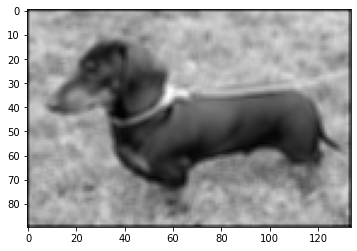

In [241]:
blur_dog = box_blur(img, box_size=3)
plt.imshow(blur_dog, cmap='gray')

Now, we will get the vertical and horizontal gradients. To perform it we calculate the convolution of the image with the following kernels:

$$
K_h = 
\begin{bmatrix}
-1 & 0  & 1\\
\end{bmatrix} \quad
K_v = 
\begin{bmatrix}
1 \\
0 \\
-1\\
\end{bmatrix} \\
X_h = X \star K_h \quad X_v = X \star K_v\\
$$

And then we calculate the amplitude of the gradient:

$$
X_\text{grad} = \sqrt{X_h^2 + X_v^2}
$$

[[0.         0.31775599 0.47766885 ... 0.49498912 0.32679739 0.        ]
 [0.         0.48180828 0.73159042 ... 0.75076254 0.49640523 0.        ]
 [0.         0.49052288 0.75479304 ... 0.77559914 0.51187364 0.        ]
 ...
 [0.         0.46176473 0.66459697 ... 0.61143791 0.41819171 0.        ]
 [0.         0.47331157 0.70141614 ... 0.6285403  0.43583877 0.        ]
 [0.         0.31862747 0.48812638 ... 0.41928105 0.29389978 0.        ]]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[[0.         0.31775599 0.47766885]]
[[0.31775599 0.47766885 0.47461875]]
[[0.47766885 0.47461875 0.47047932]]
[[0.47461875 0.47047932 0.45217866]]
[[0.47047932 0.45217866 0.45000001]]
[[0.45217866 0.45000001 0.44106754]]
[[0.45000001 0.44106754 0.4422658 ]]
[[0.44106754 0.4422658  0.43965142]]
[[0.4422658  0.43965142 0.43300655]]
[[0.43965142 0.43300655 0.44956428]]
[[0.43300655 0.44956428 0.4591

[[0.76590414 0.77102397 0.76296296]]
[[0.77102397 0.76296296 0.74270152]]
[[0.76296296 0.74270152 0.73137254]]
[[0.74270152 0.73137254 0.73856209]]
[[0.73137254 0.73856209 0.71590414]]
[[0.73856209 0.71590414 0.70217865]]
[[0.71590414 0.70217865 0.67897605]]
[[0.70217865 0.67897605 0.67418302]]
[[0.67897605 0.67418302 0.66427017]]
[[0.67418302 0.66427017 0.66328977]]
[[0.66427017 0.66328977 0.68692811]]
[[0.66328977 0.68692811 0.68703704]]
[[0.68692811 0.68703704 0.66884533]]
[[0.68703704 0.66884533 0.64662311]]
[[0.66884533 0.64662311 0.64934642]]
[[0.64662311 0.64934642 0.67135078]]
[[0.64934642 0.67135078 0.69313726]]
[[0.67135078 0.69313726 0.71546842]]
[[0.69313726 0.71546842 0.72854032]]
[[0.71546842 0.72854032 0.73267976]]
[[0.72854032 0.73267976 0.7140523 ]]
[[0.73267976 0.7140523  0.70925927]]
[[0.7140523  0.70925927 0.71427016]]
[[0.70925927 0.71427016 0.69836602]]
[[0.71427016 0.69836602 0.68540306]]
[[0.69836602 0.68540306 0.65479304]]
[[0.68540306 0.65479304 0.66568628]]
[

[[0.68061003 0.68627452 0.68583878]]
[[0.68627452 0.68583878 0.69389978]]
[[0.68583878 0.69389978 0.71307189]]
[[0.69389978 0.71307189 0.71405229]]
[[0.71307189 0.71405229 0.68801745]]
[[0.71405229 0.68801745 0.65435732]]
[[0.68801745 0.65435732 0.60980394]]
[[0.65435732 0.60980394 0.61960786]]
[[0.60980394 0.61960786 0.61862746]]
[[0.61960786 0.61862746 0.64422658]]
[[0.61862746 0.64422658 0.65206971]]
[[0.64422658 0.65206971 0.67091502]]
[[0.65206971 0.67091502 0.67091502]]
[[0.67091502 0.67091502 0.66797385]]
[[0.67091502 0.66797385 0.66013073]]
[[0.66797385 0.66013073 0.6637255 ]]
[[0.66013073 0.6637255  0.66241831]]
[[0.6637255  0.66241831 0.67614381]]
[[0.66241831 0.67614381 0.68877997]]
[[0.67614381 0.68877997 0.70348586]]
[[0.68877997 0.70348586 0.71089327]]
[[0.70348586 0.71089327 0.73071898]]
[[0.71089327 0.73071898 0.72930285]]
[[0.73071898 0.72930285 0.72429195]]
[[0.72930285 0.72429195 0.72886711]]
[[0.72429195 0.72886711 0.75054466]]
[[0.72886711 0.75054466 0.75413944]]
[

[[0.78529413 0.7717865  0.75370371]]
[[0.7717865  0.75370371 0.76296297]]
[[0.75370371 0.76296297 0.77233116]]
[[0.76296297 0.77233116 0.77026145]]
[[0.77233116 0.77026145 0.75936819]]
[[0.77026145 0.75936819 0.73899782]]
[[0.75936819 0.73899782 0.71753812]]
[[0.73899782 0.71753812 0.683878  ]]
[[0.71753812 0.683878   0.65294119]]
[[0.683878   0.65294119 0.64956428]]
[[0.65294119 0.64956428 0.67396515]]
[[0.64956428 0.67396515 0.6885621 ]]
[[0.67396515 0.6885621  0.6801743 ]]
[[0.6885621  0.6801743  0.67298477]]
[[0.6801743  0.67298477 0.67069718]]
[[0.67298477 0.67069718 0.68115469]]
[[0.67069718 0.68115469 0.69738562]]
[[0.68115469 0.69738562 0.70490196]]
[[0.69738562 0.70490196 0.65337691]]
[[0.70490196 0.65337691 0.57211329]]
[[0.65337691 0.57211329 0.48431373]]
[[0.57211329 0.48431373 0.43137255]]
[[0.48431373 0.43137255 0.40043573]]
[[0.43137255 0.40043573 0.38856209]]
[[0.40043573 0.38856209 0.38725491]]
[[0.38856209 0.38725491 0.37450981]]
[[0.38725491 0.37450981 0.35849674]]
[

[[0.42516341 0.45010895 0.46590415]]
[[0.45010895 0.46590415 0.4640523 ]]
[[0.46590415 0.4640523  0.43061003]]
[[0.4640523  0.43061003 0.43834424]]
[[0.43061003 0.43834424 0.45544663]]
[[0.43834424 0.45544663 0.49150328]]
[[0.45544663 0.49150328 0.49444445]]
[[0.49150328 0.49444445 0.4966231 ]]
[[0.49444445 0.4966231  0.50729847]]
[[0.4966231  0.50729847 0.51928104]]
[[0.50729847 0.51928104 0.52222222]]
[[0.51928104 0.52222222 0.52309368]]
[[0.52222222 0.52309368 0.51328977]]
[[0.52309368 0.51328977 0.51579522]]
[[0.51328977 0.51579522 0.5369281 ]]
[[0.51579522 0.5369281  0.57984749]]
[[0.5369281  0.57984749 0.62276689]]
[[0.57984749 0.62276689 0.63888891]]
[[0.62276689 0.63888891 0.63725492]]
[[0.63888891 0.63725492 0.64923749]]
[[0.63725492 0.64923749 0.66710241]]
[[0.64923749 0.66710241 0.68834424]]
[[0.66710241 0.68834424 0.70065361]]
[[0.68834424 0.70065361 0.71721134]]
[[0.70065361 0.71721134 0.71764708]]
[[0.71721134 0.71764708 0.71590415]]
[[0.71764708 0.71590415 0.71884532]]
[

[[0.71666669 0.72244009 0.71623094]]
[[0.72244009 0.71623094 0.72766885]]
[[0.71623094 0.72766885 0.74793029]]
[[0.72766885 0.74793029 0.75762528]]
[[0.74793029 0.75762528 0.75915033]]
[[0.75762528 0.75915033 0.74738561]]
[[0.75915033 0.74738561 0.75130719]]
[[0.74738561 0.75130719 0.7456427 ]]
[[0.75130719 0.7456427  0.7382353 ]]
[[0.7456427  0.7382353  0.73834424]]
[[0.7382353  0.73834424 0.75174293]]
[[0.73834424 0.75174293 0.76034859]]
[[0.75174293 0.76034859 0.75577343]]
[[0.76034859 0.75577343 0.74531592]]
[[0.75577343 0.74531592 0.73725491]]
[[0.74531592 0.73725491 0.75152506]]
[[0.73725491 0.75152506 0.76252723]]
[[0.75152506 0.76252723 0.7587146 ]]
[[0.76252723 0.7587146  0.7264706 ]]
[[0.7587146  0.7264706  0.69989108]]
[[0.7264706  0.69989108 0.70152507]]
[[0.69989108 0.70152507 0.73061003]]
[[0.70152507 0.73061003 0.74923748]]
[[0.73061003 0.74923748 0.75217866]]
[[0.74923748 0.75217866 0.74313727]]
[[0.75217866 0.74313727 0.74956428]]
[[0.74313727 0.74956428 0.7358388 ]]
[

[[0.69389979 0.72668846 0.73235295]]
[[0.72668846 0.73235295 0.71187364]]
[[0.73235295 0.71187364 0.65457518]]
[[0.71187364 0.65457518 0.5777778 ]]
[[0.65457518 0.5777778  0.50729849]]
[[0.5777778  0.50729849 0.46318084]]
[[0.50729849 0.46318084 0.47254902]]
[[0.46318084 0.47254902 0.50392158]]
[[0.47254902 0.50392158 0.53671025]]
[[0.50392158 0.53671025 0.56786494]]
[[0.53671025 0.56786494 0.58779959]]
[[0.56786494 0.58779959 0.59161221]]
[[0.58779959 0.59161221 0.57962964]]
[[0.59161221 0.57962964 0.56023965]]
[[0.57962964 0.56023965 0.53071897]]
[[0.56023965 0.53071897 0.49716776]]
[[0.53071897 0.49716776 0.46655774]]
[[0.49716776 0.46655774 0.45098041]]
[[0.46655774 0.45098041 0.44139435]]
[[0.45098041 0.44139435 0.44901962]]
[[0.44139435 0.44901962 0.47145971]]
[[0.44901962 0.47145971 0.50925927]]
[[0.47145971 0.50925927 0.52854031]]
[[0.50925927 0.52854031 0.4966231 ]]
[[0.52854031 0.4966231  0.43464053]]
[[0.4966231  0.43464053 0.38867103]]
[[0.43464053 0.38867103 0.37440088]]
[

[[0.57559913 0.62788671 0.65326797]]
[[0.62788671 0.65326797 0.63213508]]
[[0.65326797 0.63213508 0.60130719]]
[[0.63213508 0.60130719 0.62603486]]
[[0.60130719 0.62603486 0.65664489]]
[[0.62603486 0.65664489 0.67004359]]
[[0.65664489 0.67004359 0.65032683]]
[[0.67004359 0.65032683 0.63736386]]
[[0.65032683 0.63736386 0.64128543]]
[[0.63736386 0.64128543 0.6724401 ]]
[[0.64128543 0.6724401  0.69455339]]
[[0.6724401  0.69455339 0.69237474]]
[[0.69455339 0.69237474 0.6938998 ]]
[[0.69237474 0.6938998  0.71143792]]
[[0.6938998  0.71143792 0.49063181]]
[[0.71143792 0.49063181 0.        ]]
[[0.         0.48267974 0.71699348]]
[[0.48267974 0.71699348 0.73627452]]
[[0.71699348 0.73627452 0.74302833]]
[[0.73627452 0.74302833 0.73867102]]
[[0.74302833 0.73867102 0.73366013]]
[[0.73867102 0.73366013 0.70708061]]
[[0.73366013 0.70708061 0.69019608]]
[[0.70708061 0.69019608 0.64782136]]
[[0.69019608 0.64782136 0.63257083]]
[[0.64782136 0.63257083 0.62984751]]
[[0.63257083 0.62984751 0.61100219]]
[

[[0.52973857 0.53137256 0.53246188]]
[[0.53137256 0.53246188 0.53366015]]
[[0.53246188 0.53366015 0.53398693]]
[[0.53366015 0.53398693 0.53507625]]
[[0.53398693 0.53507625 0.53562091]]
[[0.53507625 0.53562091 0.53736384]]
[[0.53562091 0.53736384 0.53725491]]
[[0.53736384 0.53725491 0.53681917]]
[[0.53725491 0.53681917 0.5332244 ]]
[[0.53681917 0.5332244  0.52636165]]
[[0.5332244  0.52636165 0.51220043]]
[[0.52636165 0.51220043 0.49379085]]
[[0.51220043 0.49379085 0.47429195]]
[[0.49379085 0.47429195 0.45599129]]
[[0.47429195 0.45599129 0.44389979]]
[[0.45599129 0.44389979 0.44030502]]
[[0.44389979 0.44030502 0.44422659]]
[[0.44030502 0.44422659 0.44455339]]
[[0.44422659 0.44455339 0.44215687]]
[[0.44455339 0.44215687 0.43703705]]
[[0.44215687 0.43703705 0.4345316 ]]
[[0.43703705 0.4345316  0.43071897]]
[[0.4345316  0.43071897 0.42505448]]
[[0.43071897 0.42505448 0.41971679]]
[[0.42505448 0.41971679 0.41557735]]
[[0.41971679 0.41557735 0.41830066]]
[[0.41557735 0.41830066 0.42233116]]
[

[[0.36666667 0.36176471 0.35806101]]
[[0.36176471 0.35806101 0.3513072 ]]
[[0.35806101 0.3513072  0.34281047]]
[[0.3513072  0.34281047 0.33572986]]
[[0.34281047 0.33572986 0.32973857]]
[[0.33572986 0.32973857 0.32189543]]
[[0.32973857 0.32189543 0.30980393]]
[[0.32189543 0.30980393 0.29836602]]
[[0.30980393 0.29836602 0.29357299]]
[[0.29836602 0.29357299 0.30010894]]
[[0.29357299 0.30010894 0.31688454]]
[[0.30010894 0.31688454 0.33376907]]
[[0.31688454 0.33376907 0.3469499 ]]
[[0.33376907 0.3469499  0.35882353]]
[[0.3469499  0.35882353 0.37254903]]
[[0.35882353 0.37254903 0.38801744]]
[[0.37254903 0.38801744 0.40087147]]
[[0.38801744 0.40087147 0.41361656]]
[[0.40087147 0.41361656 0.42200436]]
[[0.41361656 0.42200436 0.42429194]]
[[0.42200436 0.42429194 0.42102397]]
[[0.42429194 0.42102397 0.42091503]]
[[0.42102397 0.42091503 0.42287582]]
[[0.42091503 0.42287582 0.41470589]]
[[0.42287582 0.41470589 0.39204794]]
[[0.41470589 0.39204794 0.37352941]]
[[0.39204794 0.37352941 0.341939  ]]
[

[[0.49346406 0.49880174 0.5671024 ]]
[[0.49880174 0.5671024  0.62647059]]
[[0.5671024  0.62647059 0.64281046]]
[[0.62647059 0.64281046 0.65021787]]
[[0.64281046 0.65021787 0.43180828]]
[[0.65021787 0.43180828 0.        ]]
[[0.         0.45827888 0.68943356]]
[[0.45827888 0.68943356 0.7003268 ]]
[[0.68943356 0.7003268  0.71372549]]
[[0.7003268  0.71372549 0.71492375]]
[[0.71372549 0.71492375 0.71122005]]
[[0.71492375 0.71122005 0.69891067]]
[[0.71122005 0.69891067 0.69400871]]
[[0.69891067 0.69400871 0.68801743]]
[[0.69400871 0.68801743 0.6962963 ]]
[[0.68801743 0.6962963  0.69618737]]
[[0.6962963  0.69618737 0.69509804]]
[[0.69618737 0.69509804 0.67690633]]
[[0.69509804 0.67690633 0.67886711]]
[[0.67690633 0.67886711 0.68409589]]
[[0.67886711 0.68409589 0.70686277]]
[[0.68409589 0.70686277 0.69074076]]
[[0.70686277 0.69074076 0.66176471]]
[[0.69074076 0.66176471 0.62549021]]
[[0.66176471 0.62549021 0.62135077]]
[[0.62549021 0.62135077 0.65522877]]
[[0.62135077 0.65522877 0.68954251]]
[

[[0.73398693 0.72690633 0.73159042]]
[[0.72690633 0.73159042 0.71023965]]
[[0.73159042 0.71023965 0.70261438]]
[[0.71023965 0.70261438 0.70664489]]
[[0.70261438 0.70664489 0.72755992]]
[[0.70664489 0.72755992 0.74891069]]
[[0.72755992 0.74891069 0.75196079]]
[[0.74891069 0.75196079 0.73888889]]
[[0.75196079 0.73888889 0.72810458]]
[[0.73888889 0.72810458 0.72668846]]
[[0.72810458 0.72668846 0.71350764]]
[[0.72668846 0.71350764 0.68845316]]
[[0.71350764 0.68845316 0.66067539]]
[[0.68845316 0.66067539 0.65392157]]
[[0.66067539 0.65392157 0.66579522]]
[[0.65392157 0.66579522 0.67973857]]
[[0.66579522 0.67973857 0.67832245]]
[[0.67973857 0.67832245 0.67843138]]
[[0.67832245 0.67843138 0.66917213]]
[[0.67843138 0.66917213 0.66753815]]
[[0.66917213 0.66753815 0.67047932]]
[[0.66753815 0.67047932 0.68322442]]
[[0.67047932 0.68322442 0.70021788]]
[[0.68322442 0.70021788 0.6858388 ]]
[[0.70021788 0.6858388  0.68366014]]
[[0.6858388  0.68366014 0.66459695]]
[[0.68366014 0.66459695 0.66100219]]
[

[[0.61884533 0.61416123 0.61851852]]
[[0.61416123 0.61851852 0.62668845]]
[[0.61851852 0.62668845 0.64095861]]
[[0.62668845 0.64095861 0.67189543]]
[[0.64095861 0.67189543 0.69564271]]
[[0.67189543 0.69564271 0.72701525]]
[[0.69564271 0.72701525 0.71525055]]
[[0.72701525 0.71525055 0.70272332]]
[[0.71525055 0.70272332 0.68921569]]
[[0.70272332 0.68921569 0.67712419]]
[[0.68921569 0.67712419 0.67788672]]
[[0.67712419 0.67788672 0.66045753]]
[[0.67788672 0.66045753 0.64912856]]
[[0.66045753 0.64912856 0.62505448]]
[[0.64912856 0.62505448 0.62973858]]
[[0.62505448 0.62973858 0.62244011]]
[[0.62973858 0.62244011 0.61819175]]
[[0.62244011 0.61819175 0.6019608 ]]
[[0.61819175 0.6019608  0.57908498]]
[[0.6019608  0.57908498 0.57843139]]
[[0.57908498 0.57843139 0.62265797]]
[[0.57843139 0.62265797 0.64520699]]
[[0.62265797 0.64520699 0.6184096 ]]
[[0.64520699 0.6184096  0.55261439]]
[[0.6184096  0.55261439 0.52843138]]
[[0.55261439 0.52843138 0.51993464]]
[[0.52843138 0.51993464 0.49760349]]
[

[[0.72538127 0.76623094 0.79270154]]
[[0.76623094 0.79270154 0.76949892]]
[[0.79270154 0.76949892 0.47690633]]
[[0.76949892 0.47690633 0.        ]]
[[0.         0.48235295 0.69596952]]
[[0.48235295 0.69596952 0.65773423]]
[[0.69596952 0.65773423 0.66394338]]
[[0.65773423 0.66394338 0.68278869]]
[[0.66394338 0.68278869 0.66067539]]
[[0.68278869 0.66067539 0.64553377]]
[[0.66067539 0.64553377 0.61753813]]
[[0.64553377 0.61753813 0.63137256]]
[[0.61753813 0.63137256 0.65261439]]
[[0.63137256 0.65261439 0.70446624]]
[[0.65261439 0.70446624 0.725817  ]]
[[0.70446624 0.725817   0.69346406]]
[[0.725817   0.69346406 0.62124183]]
[[0.69346406 0.62124183 0.63986929]]
[[0.62124183 0.63986929 0.65315905]]
[[0.63986929 0.65315905 0.69150328]]
[[0.65315905 0.69150328 0.66840959]]
[[0.69150328 0.66840959 0.65664489]]
[[0.66840959 0.65664489 0.6674292 ]]
[[0.65664489 0.6674292  0.68692811]]
[[0.6674292  0.68692811 0.72091504]]
[[0.68692811 0.72091504 0.71437909]]
[[0.72091504 0.71437909 0.69531592]]
[

[[0.64204793 0.62723311 0.62396514]]
[[0.62723311 0.62396514 0.63344227]]
[[0.62396514 0.63344227 0.6291939 ]]
[[0.63344227 0.6291939  0.63747277]]
[[0.6291939  0.63747277 0.65827886]]
[[0.63747277 0.65827886 0.6587146 ]]
[[0.65827886 0.6587146  0.63965142]]
[[0.6587146  0.63965142 0.60272333]]
[[0.63965142 0.60272333 0.59705884]]
[[0.60272333 0.59705884 0.58235296]]
[[0.59705884 0.58235296 0.56448804]]
[[0.58235296 0.56448804 0.58671025]]
[[0.56448804 0.58671025 0.60642702]]
[[0.58671025 0.60642702 0.63867103]]
[[0.60642702 0.63867103 0.61416123]]
[[0.63867103 0.61416123 0.60348586]]
[[0.61416123 0.60348586 0.55958606]]
[[0.60348586 0.55958606 0.54923748]]
[[0.55958606 0.54923748 0.51851852]]
[[0.54923748 0.51851852 0.52385621]]
[[0.51851852 0.52385621 0.49771242]]
[[0.52385621 0.49771242 0.51753813]]
[[0.49771242 0.51753813 0.51056646]]
[[0.51753813 0.51056646 0.5133987 ]]
[[0.51056646 0.5133987  0.49716776]]
[[0.5133987  0.49716776 0.54455339]]
[[0.49716776 0.54455339 0.58572986]]
[

[[0.71688454 0.73235295 0.71546842]]
[[0.73235295 0.71546842 0.70446624]]
[[0.71546842 0.70446624 0.67843138]]
[[0.70446624 0.67843138 0.68867104]]
[[0.67843138 0.68867104 0.69084968]]
[[0.68867104 0.69084968 0.69771243]]
[[0.69084968 0.69771243 0.69117647]]
[[0.69771243 0.69117647 0.6761438 ]]
[[0.69117647 0.6761438  0.67549021]]
[[0.6761438  0.67549021 0.69335514]]
[[0.67549021 0.69335514 0.71034861]]
[[0.69335514 0.71034861 0.70174293]]
[[0.71034861 0.70174293 0.67026144]]
[[0.70174293 0.67026144 0.6567538 ]]
[[0.67026144 0.6567538  0.69139434]]
[[0.6567538  0.69139434 0.72843137]]
[[0.69139434 0.72843137 0.76459695]]
[[0.72843137 0.76459695 0.7627451 ]]
[[0.76459695 0.7627451  0.75403052]]
[[0.7627451  0.75403052 0.70740743]]
[[0.75403052 0.70740743 0.68028326]]
[[0.70740743 0.68028326 0.66644882]]
[[0.68028326 0.66644882 0.65686277]]
[[0.66644882 0.65686277 0.64640525]]
[[0.65686277 0.64640525 0.64836604]]
[[0.64640525 0.64836604 0.65849676]]
[[0.64836604 0.65849676 0.6842048 ]]
[

[[0.46132898 0.44651416 0.42276688]]
[[0.44651416 0.42276688 0.41688453]]
[[0.42276688 0.41688453 0.42734206]]
[[0.41688453 0.42734206 0.43812637]]
[[0.42734206 0.43812637 0.43322441]]
[[0.43812637 0.43322441 0.44270153]]
[[0.43322441 0.44270153 0.46840959]]
[[0.44270153 0.46840959 0.48551199]]
[[0.46840959 0.48551199 0.49662311]]
[[0.48551199 0.49662311 0.49008716]]
[[0.49662311 0.49008716 0.48050111]]
[[0.49008716 0.48050111 0.46568629]]
[[0.48050111 0.46568629 0.44596952]]
[[0.46568629 0.44596952 0.42450982]]
[[0.44596952 0.42450982 0.4553377 ]]
[[0.42450982 0.4553377  0.49564272]]
[[0.4553377  0.49564272 0.52320262]]
[[0.49564272 0.52320262 0.50010894]]
[[0.52320262 0.50010894 0.48725491]]
[[0.50010894 0.48725491 0.48061003]]
[[0.48725491 0.48061003 0.47854031]]
[[0.48061003 0.47854031 0.48366014]]
[[0.47854031 0.48366014 0.48257081]]
[[0.48366014 0.48257081 0.46383443]]
[[0.48257081 0.46383443 0.42505447]]
[[0.46383443 0.42505447 0.4100218 ]]
[[0.42505447 0.4100218  0.42167757]]
[

 [0.77440086]]
[[0.76100219]
 [0.77167757]
 [0.78474946]]
[[0.78376907]
 [0.78572986]
 [0.77015251]]
[[0.79684097]
 [0.78899784]
 [0.76165579]]
[[0.80479303]
 [0.79106755]
 [0.76013073]]
[[0.78921569]
 [0.78464053]
 [0.7798475 ]]
[[0.78474946]
 [0.78006536]
 [0.7872549 ]]
[[0.77472768]
 [0.77102397]
 [0.78050109]]
[[0.76122005]
 [0.75294118]
 [0.7620915 ]]
[[0.76067539]
 [0.74825709]
 [0.76448802]]
[[0.76688455]
 [0.75348586]
 [0.7630719 ]]
[[0.77309369]
 [0.74455339]
 [0.74607843]]
[[0.76427017]
 [0.72679741]
 [0.7264706 ]]
[[0.76612202]
 [0.73039217]
 [0.73333334]]
[[0.7764706 ]
 [0.74989108]
 [0.74313726]]
[[0.78627452]
 [0.77244009]
 [0.74433551]]
[[0.52091504]
 [0.51122004]
 [0.4872549 ]]
[[0.49912854]
 [0.49607842]
 [0.49945533]]
[[0.74150328]
 [0.73845316]
 [0.74705883]]
[[0.72342049]
 [0.71906319]
 [0.73061003]]
[[0.70991286]
 [0.71209152]
 [0.7311547 ]]
[[0.69455338]
 [0.69869282]
 [0.73104576]]
[[0.68322442]
 [0.68616559]
 [0.72265797]]
[[0.67701526]
 [0.67265797]
 [0.7038126

 [0.72472767]]
[[0.76633986]
 [0.7633987 ]
 [0.76448802]]
[[0.76884531]
 [0.77102397]
 [0.76143791]]
[[0.76394335]
 [0.7704793 ]
 [0.77233116]]
[[0.74640522]
 [0.75152505]
 [0.76198257]]
[[0.72723312]
 [0.74030502]
 [0.76263617]]
[[0.71775599]
 [0.73311547]
 [0.75555555]]
[[0.73061002]
 [0.74172113]
 [0.7614379 ]]
[[0.72374727]
 [0.74193899]
 [0.76579519]]
[[0.71873638]
 [0.74498911]
 [0.76361656]]
[[0.69978214]
 [0.73224402]
 [0.74738563]]
[[0.70272332]
 [0.73202616]
 [0.74030503]]
[[0.70991286]
 [0.73638345]
 [0.72930284]]
[[0.72461874]
 [0.74901961]
 [0.73257081]]
[[0.7298475 ]
 [0.73638345]
 [0.72004358]]
[[0.72603487]
 [0.73115469]
 [0.72908497]]
[[0.70272333]
 [0.7230937 ]
 [0.73246188]]
[[0.68572987]
 [0.72265796]
 [0.72625273]]
[[0.68474947]
 [0.71318084]
 [0.71514162]]
[[0.70119827]
 [0.71742921]
 [0.72516341]]
[[0.72690632]
 [0.72657953]
 [0.73976035]]
[[0.73834424]
 [0.73965143]
 [0.75784315]]
[[0.7593682 ]
 [0.75032681]
 [0.75577343]]
[[0.76568629]
 [0.76797387]
 [0.7774509

 [0.69259259]]
[[0.75392158]
 [0.73594772]
 [0.68943357]]
[[0.73398694]
 [0.71960785]
 [0.69967322]]
[[0.70642703]
 [0.70119827]
 [0.70021788]]
[[0.67745099]
 [0.68311548]
 [0.70032681]]
[[0.67461875]
 [0.68932464]
 [0.7019608 ]]
[[0.67004358]
 [0.68366014]
 [0.71056645]]
[[0.68507627]
 [0.70773421]
 [0.74477124]]
[[0.70588236]
 [0.73039216]
 [0.75381264]]
[[0.72254903]
 [0.73496732]
 [0.73235294]]
[[0.68540305]
 [0.68681917]
 [0.66285403]]
[[0.63540306]
 [0.63235294]
 [0.5912854 ]]
[[0.61481482]
 [0.60283224]
 [0.5456427 ]]
[[0.62875819]
 [0.59705883]
 [0.52592592]]
[[0.64117649]
 [0.59477125]
 [0.53202615]]
[[0.65435731]
 [0.60446624]
 [0.53736384]]
[[0.67004357]
 [0.61318084]
 [0.52788672]]
[[0.68278867]
 [0.60686275]
 [0.50239652]]
[[0.68148149]
 [0.59433552]
 [0.48300654]]
[[0.67320263]
 [0.59204794]
 [0.48954249]]
[[0.66960786]
 [0.60653596]
 [0.51938999]]
[[0.67047932]
 [0.6267974 ]
 [0.54989108]]
[[0.6553377 ]
 [0.64052288]
 [0.58006536]]
[[0.65947713]
 [0.65250545]
 [0.6046841

 [0.63257084]]
[[0.47233117]
 [0.45250546]
 [0.44433553]]
[[0.46535948]
 [0.48616558]
 [0.5009804 ]]
[[0.71350763]
 [0.73398694]
 [0.74651417]]
[[0.74956427]
 [0.76307191]
 [0.7576253 ]]
[[0.76525054]
 [0.76797387]
 [0.7566449 ]]
[[0.76906318]
 [0.76111112]
 [0.75370373]]
[[0.77331155]
 [0.75239652]
 [0.74335513]]
[[0.75544664]
 [0.72167757]
 [0.71176471]]
[[0.71633988]
 [0.68202615]
 [0.6785403 ]]
[[0.67222224]
 [0.63877996]
 [0.64618737]]
[[0.67407409]
 [0.63943356]
 [0.64509804]]
[[0.69912855]
 [0.66318083]
 [0.6556645 ]]
[[0.71546842]
 [0.67440089]
 [0.65359479]]
[[0.71677562]
 [0.6771242 ]
 [0.64106756]]
[[0.72058825]
 [0.69368194]
 [0.64869283]]
[[0.74030503]
 [0.7147059 ]
 [0.66601309]]
[[0.75032681]
 [0.73082789]
 [0.69335514]]
[[0.76590415]
 [0.72875818]
 [0.69150329]]
[[0.76655774]
 [0.71459696]
 [0.67592594]]
[[0.76840959]
 [0.72603487]
 [0.69237474]]
[[0.7429194 ]
 [0.71274511]
 [0.68431374]]
[[0.71884532]
 [0.70697169]
 [0.67701526]]
[[0.6972767 ]
 [0.67461875]
 [0.6187364

 [0.79150327]]
[[0.70740741]
 [0.74063181]
 [0.7540305 ]]
[[0.72069717]
 [0.72973857]
 [0.73159042]]
[[0.74607844]
 [0.7600218 ]
 [0.74052288]]
[[0.75468412]
 [0.76862746]
 [0.7513072 ]]
[[0.73845318]
 [0.75827887]
 [0.74411764]]
[[0.71699348]
 [0.73867102]
 [0.74270152]]
[[0.70729848]
 [0.72037037]
 [0.72995643]]
[[0.69836603]
 [0.70326798]
 [0.72701526]]
[[0.69553378]
 [0.69760349]
 [0.72069717]]
[[0.7143791 ]
 [0.70980393]
 [0.71503268]]
[[0.73159043]
 [0.71786493]
 [0.70958606]]
[[0.72233117]
 [0.70675382]
 [0.71416123]]
[[0.71350764]
 [0.7053377 ]
 [0.72777779]]
[[0.70610023]
 [0.70174292]
 [0.73202615]]
[[0.72047931]
 [0.71568628]
 [0.73278868]]
[[0.72581699]
 [0.72657953]
 [0.73736384]]
[[0.7198257 ]
 [0.73692811]
 [0.74335513]]
[[0.72799565]
 [0.74270153]
 [0.74324619]]
[[0.74716777]
 [0.75860567]
 [0.75108933]]
[[0.75196079]
 [0.75141613]
 [0.74901962]]
[[0.75261439]
 [0.75337691]
 [0.74509805]]
[[0.74803923]
 [0.7469499 ]
 [0.7379085 ]]
[[0.76067539]
 [0.76143792]
 [0.7374727

 [0.66372551]]
[[0.65457518]
 [0.66884534]
 [0.69237475]]
[[0.68943357]
 [0.69531592]
 [0.73300655]]
[[0.7234205 ]
 [0.72047932]
 [0.75424837]]
[[0.73540306]
 [0.73997821]
 [0.76862745]]
[[0.72603487]
 [0.7540305 ]
 [0.78714597]]
[[0.70348585]
 [0.7590414 ]
 [0.79716776]]
[[0.68954251]
 [0.74531592]
 [0.79139435]]
[[0.69836602]
 [0.74509804]
 [0.7795207 ]]
[[0.73104576]
 [0.76318084]
 [0.7734205 ]]
[[0.75392157]
 [0.7795207 ]
 [0.76535949]]
[[0.75686275]
 [0.77440089]
 [0.75217867]]
[[0.75697169]
 [0.76198259]
 [0.73344228]]
[[0.75501092]
 [0.74705885]
 [0.72429195]]
[[0.50392159]
 [0.49575165]
 [0.48093683]]
[[0.41034859]
 [0.40631809]
 [0.39302833]]
[[0.63398694]
 [0.60784314]
 [0.59586057]]
[[0.65980393]
 [0.62647059]
 [0.62734206]]
[[0.66350763]
 [0.63627452]
 [0.64183007]]
[[0.65108934]
 [0.65533771]
 [0.65838781]]
[[0.64716778]
 [0.65686277]
 [0.64771244]]
[[0.65697169]
 [0.66067541]
 [0.65424839]]
[[0.66045752]
 [0.66078433]
 [0.66830068]]
[[0.65980394]
 [0.68529414]
 [0.7130719

 [0.7208061 ]]
[[0.7127451 ]
 [0.71873638]
 [0.73235294]]
[[0.71884532]
 [0.73148148]
 [0.73180828]]
[[0.48300654]
 [0.49586057]
 [0.49640524]]
[[0.40065361]
 [0.43267976]
 [0.46383444]]
[[0.62875819]
 [0.67396517]
 [0.69912856]]
[[0.66013074]
 [0.70119828]
 [0.7056645 ]]
[[0.67320263]
 [0.70544663]
 [0.71339869]]
[[0.65152507]
 [0.67156863]
 [0.69814815]]
[[0.6351852 ]
 [0.65315905]
 [0.68769065]]
[[0.63812638]
 [0.65054468]
 [0.67657954]]
[[0.66895427]
 [0.67799566]
 [0.69542485]]
[[0.72069718]
 [0.71034859]
 [0.71982572]]
[[0.7543573 ]
 [0.73126362]
 [0.74346406]]
[[0.76971679]
 [0.74488018]
 [0.75740741]]
[[0.77755992]
 [0.76568629]
 [0.77723312]]
[[0.78431374]
 [0.775817  ]
 [0.76481483]]
[[0.78736384]
 [0.77091504]
 [0.72657953]]
[[0.77287582]
 [0.72647059]
 [0.63867103]]
[[0.71644881]
 [0.65021788]
 [0.55108933]]
[[0.65751635]
 [0.57058825]
 [0.49063182]]
[[0.58267975]
 [0.50762529]
 [0.46699347]]
[[0.53594772]
 [0.47429195]
 [0.46187364]]
[[0.4892157 ]
 [0.4590414 ]
 [0.4693899

 [0.81928105]]
[[0.66296297]
 [0.71437908]
 [0.81013072]]
[[0.65261439]
 [0.69847495]
 [0.7835512 ]]
[[0.6590414 ]
 [0.71002179]
 [0.7583878 ]]
[[0.69662311]
 [0.74596952]
 [0.75708063]]
[[0.72178651]
 [0.77080612]
 [0.76971679]]
[[0.75381266]
 [0.77788673]
 [0.7432462 ]]
[[0.75076255]
 [0.75882355]
 [0.725817  ]]
[[0.75479304]
 [0.75991286]
 [0.72472768]]
[[0.73725491]
 [0.73899783]
 [0.73779958]]
[[0.74313726]
 [0.73943356]
 [0.75032681]]
[[0.73899783]
 [0.72919392]
 [0.73932464]]
[[0.72908499]
 [0.72472769]
 [0.74335514]]
[[0.74793031]
 [0.73311549]
 [0.7489107 ]]
[[0.76612202]
 [0.7358388 ]
 [0.74575165]]
[[0.78681918]
 [0.73867104]
 [0.73725492]]
[[0.77222222]
 [0.72342048]
 [0.72429195]]
[[0.75980393]
 [0.71437909]
 [0.71525056]]
[[0.73856211]
 [0.70239653]
 [0.70784316]]
[[0.72440089]
 [0.68769066]
 [0.70370372]]
[[0.71350764]
 [0.67668847]
 [0.70261439]]
[[0.70762528]
 [0.66819173]
 [0.70686275]]
[[0.69433553]
 [0.66481482]
 [0.70958606]]
[[0.6744009 ]
 [0.66176472]
 [0.7143790

 [0.50381264]]
[[0.49368192]
 [0.51699347]
 [0.51862745]]
[[0.54869281]
 [0.56732026]
 [0.55838779]]
[[0.60228758]
 [0.61459694]
 [0.59727668]]
[[0.63507626]
 [0.6406318 ]
 [0.61655772]]
[[0.64705884]
 [0.64237473]
 [0.61307189]]
[[0.64553379]
 [0.63028323]
 [0.60076253]]
[[0.63943356]
 [0.62298476]
 [0.60119827]]
[[0.6345316 ]
 [0.62429196]
 [0.61023967]]
[[0.62755991]
 [0.62897605]
 [0.62450982]]
[[0.60054467]
 [0.62178651]
 [0.63801744]]
[[0.56285404]
 [0.61045753]
 [0.64498912]]
[[0.52799566]
 [0.5969499 ]
 [0.6422658 ]]
[[0.52200437]
 [0.59716776]
 [0.63692811]]
[[0.53507627]
 [0.59923748]
 [0.62864925]]
[[0.56241833]
 [0.6022876 ]
 [0.61764707]]
[[0.58507629]
 [0.59074077]
 [0.58845317]]
[[0.59923749]
 [0.58159043]
 [0.56274511]]
[[0.59880176]
 [0.58050111]
 [0.55315905]]
[[0.56394337]
 [0.55980393]
 [0.52668846]]
[[0.50403052]
 [0.5184096 ]
 [0.4842048 ]]
[[0.44455339]
 [0.45806101]
 [0.4245098 ]]
[[0.39651417]
 [0.4013072 ]
 [0.37026144]]
[[0.35141612]
 [0.33845316]
 [0.3168845

 [0.57385622]]
[[0.56938999]
 [0.57080611]
 [0.56873639]]
[[0.56928106]
 [0.56819173]
 [0.56688454]]
[[0.56906321]
 [0.56732028]
 [0.56514162]]
[[0.5663399 ]
 [0.56448803]
 [0.56328977]]
[[0.56143792]
 [0.55980393]
 [0.55849674]]
[[0.55413944]
 [0.55326798]
 [0.55326798]]
[[0.55010894]
 [0.55087146]
 [0.55108933]]
[[0.54596951]
 [0.5456427 ]
 [0.54389979]]
[[0.54117647]
 [0.53976034]
 [0.53812636]]
[[0.53311547]
 [0.53071896]
 [0.52777778]]
[[0.52810457]
 [0.52450981]
 [0.52102398]]
[[0.5245098 ]
 [0.51819173]
 [0.50991287]]
[[0.51960784]
 [0.51023965]
 [0.49880175]]
[[0.51187363]
 [0.50141612]
 [0.48910675]]
[[0.50610021]
 [0.49575163]
 [0.48289761]]
[[0.50283225]
 [0.49204794]
 [0.48039217]]
[[0.50185186]
 [0.4892157 ]
 [0.47875818]]
[[0.50305012]
 [0.48845317]
 [0.47810458]]
[[0.50446623]
 [0.48965142]
 [0.47777779]]
[[0.50239651]
 [0.48965142]
 [0.47777779]]
[[0.50043573]
 [0.48856209]
 [0.47559914]]
[[0.49575164]
 [0.48431373]
 [0.47091504]]
[[0.49542485]
 [0.48366014]
 [0.4681917

 [0.64575164]]
[[0.49760348]
 [0.53997822]
 [0.58137256]]
[[0.38845316]
 [0.45446623]
 [0.51971678]]
[[0.31938998]
 [0.38572986]
 [0.46350764]]
[[0.29052288]
 [0.36993464]
 [0.46633987]]
[[0.2761438 ]
 [0.32712419]
 [0.42331155]]
[[0.27886711]
 [0.29596951]
 [0.3795207 ]]
[[0.27668846]
 [0.27058824]
 [0.34596951]]
[[0.28671025]
 [0.2916122 ]
 [0.36416123]]
[[0.30631809]
 [0.32668846]
 [0.40686276]]
[[0.3348584 ]
 [0.37331155]
 [0.46165578]]
[[0.36100219]
 [0.41383443]
 [0.5140523 ]]
[[0.38943356]
 [0.45642702]
 [0.55718955]]
[[0.43104576]
 [0.50479304]
 [0.57440089]]
[[0.47135077]
 [0.54651417]
 [0.55294118]]
[[0.51535949]
 [0.57788672]
 [0.51938999]]
[[0.56732027]
 [0.57026145]
 [0.47276689]]
[[0.60620916]
 [0.5476035 ]
 [0.43649239]]
[[0.60708062]
 [0.49825709]
 [0.39705883]]
[[0.57124185]
 [0.46078432]
 [0.39498911]]
[[0.5150327 ]
 [0.42962963]
 [0.39956427]]
[[0.46285404]
 [0.43039216]
 [0.41198257]]
[[0.45152506]
 [0.44368192]
 [0.40620915]]
[[0.45294119]
 [0.43039217]
 [0.383878 

 [0.6445534 ]]
[[0.67037038]
 [0.66132898]
 [0.66568628]]
[[0.6506536 ]
 [0.6466231 ]
 [0.65806101]]
[[0.63769064]
 [0.63169935]
 [0.64411765]]
[[0.64673203]
 [0.62244009]
 [0.62047931]]
[[0.65555557]
 [0.617756  ]
 [0.61786493]]
[[0.65522879]
 [0.62331157]
 [0.6217865 ]]
[[0.65751637]
 [0.63409589]
 [0.62875819]]
[[0.6660131 ]
 [0.65653596]
 [0.64575165]]
[[0.70370372]
 [0.68605666]
 [0.67026145]]
[[0.74694991]
 [0.7277778 ]
 [0.70708063]]
[[0.75196082]
 [0.73725494]
 [0.71906321]]
[[0.73627454]
 [0.72549023]
 [0.71089328]]
[[0.68921571]
 [0.68779959]
 [0.68431376]]
[[0.68540305]
 [0.66732028]
 [0.65076255]]
[[0.69030501]
 [0.66633987]
 [0.65980393]]
[[0.66949891]
 [0.66187364]
 [0.68267975]]
[[0.64509804]
 [0.65620915]
 [0.70250545]]
[[0.60010894]
 [0.62886711]
 [0.6922658 ]]
[[0.60392159]
 [0.62930285]
 [0.675817  ]]
[[0.59989108]
 [0.6140523 ]
 [0.651634  ]]
[[0.61023966]
 [0.61742921]
 [0.65413945]]
[[0.60751635]
 [0.60936821]
 [0.65403051]]
[[0.62777779]
 [0.62755993]
 [0.6685185

 [0.44302833]]
[[0.47450981]
 [0.46263617]
 [0.44520698]]
[[0.47265796]
 [0.45882354]
 [0.44106755]]
[[0.46165578]
 [0.44509805]
 [0.42734206]]
[[0.44738563]
 [0.43006537]
 [0.41143792]]
[[0.43943356]
 [0.42189543]
 [0.40511984]]
[[0.43812637]
 [0.42298476]
 [0.4090414 ]]
[[0.43888889]
 [0.42472767]
 [0.41437909]]
[[0.44281047]
 [0.43191722]
 [0.42124184]]
[[0.44618738]
 [0.43496733]
 [0.42429195]]
[[0.45065361]
 [0.43801744]
 [0.42527234]]
[[0.45043574]
 [0.43572986]
 [0.42233117]]
[[0.4509804 ]
 [0.43442267]
 [0.41917212]]
[[0.45206973]
 [0.43583879]
 [0.4184096 ]]
[[0.44738563]
 [0.42973857]
 [0.41089326]]
[[0.43289762]
 [0.41361657]
 [0.39433552]]
[[0.40860568]
 [0.38649238]
 [0.37113291]]
[[0.38311548]
 [0.36318084]
 [0.35479304]]
[[0.36100218]
 [0.34891068]
 [0.34869282]]
[[0.34869281]
 [0.3469499 ]
 [0.3513072 ]]
[[0.35381264]
 [0.35718955]
 [0.36023966]]
[[0.36557735]
 [0.36971678]
 [0.36906319]]
[[0.37875818]
 [0.37886711]
 [0.37309369]]
[[0.38235295]
 [0.37777779]
 [0.3690631

 [0.7069717 ]]
[[0.72407408]
 [0.67832245]
 [0.68289762]]
[[0.70882352]
 [0.66699346]
 [0.66840959]]
[[0.72102396]
 [0.66122005]
 [0.64215687]]
[[0.73224403]
 [0.67745099]
 [0.65272333]]
[[0.75849676]
 [0.72429197]
 [0.71078434]]
[[0.76906321]
 [0.75882355]
 [0.7529412 ]]
[[0.75991286]
 [0.75239653]
 [0.75468411]]
[[0.70119827]
 [0.70991288]
 [0.72854033]]
[[0.67908497]
 [0.70000001]
 [0.72984751]]
[[0.68006537]
 [0.70043574]
 [0.73736385]]
[[0.70283225]
 [0.71198257]
 [0.7342048 ]]
[[0.70980393]
 [0.7053377 ]
 [0.71132898]]
[[0.68692811]
 [0.69738563]
 [0.71078432]]
[[0.68267974]
 [0.68093683]
 [0.69041395]]
[[0.67755991]
 [0.66481482]
 [0.67516341]]
[[0.69106755]
 [0.67396516]
 [0.66655775]]
[[0.68562092]
 [0.68006537]
 [0.67440089]]
[[0.68464053]
 [0.69237474]
 [0.6979303 ]]
[[0.66906318]
 [0.65697168]
 [0.66775599]]
[[0.56383442]
 [0.56176471]
 [0.57875817]]
[[0.45511983]
 [0.45490196]
 [0.4671024 ]]
[[0.35250545]
 [0.37788671]
 [0.40185186]]
[[0.3422658 ]
 [0.36982571]
 [0.4067538

[[0.71688454]
 [0.72657952]
 [0.72069718]]
[[0.72222224]
 [0.73638345]
 [0.73594773]]
[[0.7308279 ]
 [0.74030502]
 [0.72755993]]
[[0.75370371]
 [0.75403051]
 [0.73028323]]
[[0.75108933]
 [0.74793029]
 [0.71470589]]
[[0.66525055]
 [0.71296298]
 [0.70359478]]
[[0.51318084]
 [0.59237475]
 [0.63562094]]
[[0.39084968]
 [0.46263618]
 [0.54193902]]
[[0.34978214]
 [0.36928105]
 [0.42919391]]
[[0.37429194]
 [0.3543573 ]
 [0.35305011]]
[[0.41252724]
 [0.38474946]
 [0.35305011]]
[[0.46862746]
 [0.43366014]
 [0.38769064]]
[[0.51165577]
 [0.4708061 ]
 [0.41764706]]
[[0.5466231 ]
 [0.51633988]
 [0.44738563]]
[[0.55054467]
 [0.54836602]
 [0.49684096]]
[[0.54084968]
 [0.57461874]
 [0.55348584]]
[[0.50348584]
 [0.55326798]
 [0.56830066]]
[[0.4506536 ]
 [0.48344227]
 [0.50762528]]
[[0.41100218]
 [0.41546841]
 [0.42832245]]
[[0.39237473]
 [0.37625273]
 [0.36840959]]
[[0.38485839]
 [0.37091503]
 [0.35588235]]
[[0.36851852]
 [0.36557734]
 [0.35947712]]
[[0.35599129]
 [0.36143791]
 [0.36339869]]
[[0.3520697

[[0.51198258]
 [0.53159043]
 [0.58180829]]
[[0.52745099]
 [0.5301743 ]
 [0.53246188]]
[[0.5311547 ]
 [0.51448803]
 [0.4996732 ]]
[[0.5543573 ]
 [0.52407408]
 [0.49411765]]
[[0.59161221]
 [0.5429194 ]
 [0.51535949]]
[[0.55228758]
 [0.52505447]
 [0.52320263]]
[[0.53191721]
 [0.5171024 ]
 [0.52178649]]
[[0.52004358]
 [0.53758171]
 [0.55980393]]
[[0.54651417]
 [0.56078432]
 [0.57864925]]
[[0.567756  ]
 [0.56459697]
 [0.58442267]]
[[0.59389979]
 [0.57755992]
 [0.58180829]]
[[0.64455339]
 [0.61873639]
 [0.60152506]]
[[0.65915034]
 [0.6546841 ]
 [0.63986929]]
[[0.65675383]
 [0.65239653]
 [0.6429194 ]]
[[0.66459697]
 [0.66579523]
 [0.66764708]]
[[0.69335514]
 [0.69967322]
 [0.69978215]]
[[0.71546843]
 [0.73703706]
 [0.72766887]]
[[0.73039218]
 [0.75315906]
 [0.74215688]]
[[0.70108935]
 [0.71993467]
 [0.71775602]]
[[0.68540307]
 [0.69596952]
 [0.69607845]]
[[0.66928106]
 [0.67592595]
 [0.66906321]]
[[0.67047932]
 [0.67254904]
 [0.66982573]]
[[0.66459697]
 [0.67385624]
 [0.70098042]]
[[0.4404139

 [0.69575165]]
[[0.54084969]
 [0.57102398]
 [0.61176473]]
[[0.53888891]
 [0.55272334]
 [0.55827889]]
[[0.52821352]
 [0.53758172]
 [0.55337692]]
[[0.51960786]
 [0.53976036]
 [0.60000001]]
[[0.52843138]
 [0.55664488]
 [0.65108933]]
[[0.56655775]
 [0.6305011 ]
 [0.71263617]]
[[0.61557735]
 [0.67156863]
 [0.71056645]]
[[0.65119827]
 [0.67200436]
 [0.66535948]]
[[0.66459696]
 [0.65457517]
 [0.62026144]]
[[0.67472767]
 [0.64433551]
 [0.60315904]]
[[0.69281046]
 [0.66873639]
 [0.63409587]]
[[0.7127451 ]
 [0.71165578]
 [0.68344227]]
[[0.71721134]
 [0.73137256]
 [0.71165579]]
[[0.7224401 ]
 [0.7335512 ]
 [0.72015252]]
[[0.74183008]
 [0.73616558]
 [0.71862746]]
[[0.74466232]
 [0.7449891 ]
 [0.71361656]]
[[0.74749456]
 [0.75718955]
 [0.72538127]]
[[0.76165578]
 [0.78126362]
 [0.76623094]]
[[0.79444446]
 [0.80261439]
 [0.79270154]]
[[0.79259261]
 [0.78366014]
 [0.76949892]]
[[0.52058825]
 [0.4972767 ]
 [0.47690633]]
[[0.44640523]
 [0.44640523]
 [0.48235295]]
[[0.68148149]
 [0.67701526]
 [0.6959695

 [0.69651417]]
[[0.73856208]
 [0.71339868]
 [0.69586057]]
[[0.7204793 ]
 [0.71590414]
 [0.71132898]]
[[0.69575163]
 [0.69749455]
 [0.69553377]]
[[0.68703705]
 [0.67843139]
 [0.67636167]]
[[0.68562094]
 [0.66328978]
 [0.66982573]]
[[0.69836603]
 [0.68812639]
 [0.68082792]]
[[0.69716778]
 [0.6989107 ]
 [0.70424839]]
[[0.69836603]
 [0.70806102]
 [0.701634  ]]
[[0.69237475]
 [0.67244011]
 [0.67015251]]
[[0.68769064]
 [0.66612201]
 [0.64422658]]
[[0.71143791]
 [0.6932462 ]
 [0.67494554]]
[[0.74520697]
 [0.74357298]
 [0.7245098 ]]
[[0.76220045]
 [0.77516341]
 [0.77320262]]
[[0.77222223]
 [0.77505447]
 [0.76764706]]
[[0.74803923]
 [0.76492376]
 [0.76557736]]
[[0.71481482]
 [0.71546841]
 [0.71263618]]
[[0.64978215]
 [0.66895427]
 [0.67799567]]
[[0.63943356]
 [0.64400874]
 [0.6438998 ]]
[[0.63769064]
 [0.62973858]
 [0.63431374]]
[[0.64793028]
 [0.62156864]
 [0.62821352]]
[[0.62352941]
 [0.60000002]
 [0.62124185]]
[[0.62755991]
 [0.61884533]
 [0.62919392]]
[[0.61982571]
 [0.6251634 ]
 [0.6459695

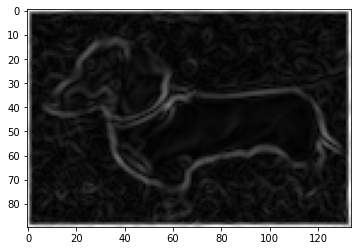

In [242]:
dog_h = conv_matrix(blur_dog, np.array([[-1, 0, 1]]))
dog_v = conv_matrix(blur_dog, np.array([[-1, 0, 1]]).T)
dog_grad = np.sqrt(dog_h ** 2 + dog_v ** 2)
plt.imshow(dog_grad, cmap='gray')

This yields the edges of our blurred dog. It is not the only way to obtain edges though, there are plenty more:
* [Canny edge detection](https://en.wikipedia.org/wiki/Canny_edge_detector)
* [Sobel operator](https://en.wikipedia.org/wiki/Sobel_operator)
* [Prewitt operator](https://en.wikipedia.org/wiki/Prewitt_operator)

When you convolve an image with a kernel you obtain a map of responses. The more correlated the patch of an image is with the kernel, the higher the response. Let's take a closer look:

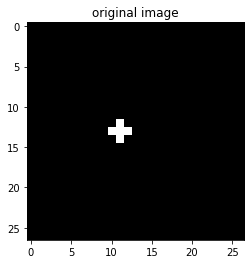

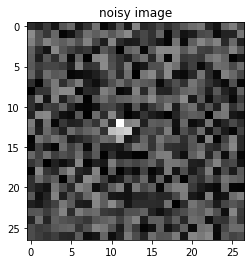

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00]
 [0.00000000e+00 1.60659950e-01 1.14488299e-01 2.10406343e-01
  8.02389774e-02 3.01901410e-01 3.80867724e-01 8.72563901e-02
  1.85084022e-01 4.09342014e-01 2.66468825e-02 1.05539069e-01
  3.10132108e-01 8.75638750e-02 4.70598161e-01 1.49400778e-01
  1.71356933e-01 2.58813262e-01 1.68950105e-01 2.29883277e-01
  3.23676605e-01 3.86718520e-01 4.23692919e-01 1.41484615e-01
  7.38208216e-02 3.58254709e-01 4.47933465e-01 2.63203383e-01
  0.00000000e+00]
 [0.00000000e+00 4.97641146e-01 3.00509208e-01 1.92507277e-01
  3.70077105e-01 1.91196158e-02 7.

 [0.40489358 0.00666369 0.15749407]]
[[0.45034939 0.45909908 0.20853313]
 [0.26704389 0.44295391 0.09143056]
 [0.00666369 0.15749407 0.41458704]]
[[0.45909908 0.20853313 0.10214309]
 [0.44295391 0.09143056 0.0568211 ]
 [0.15749407 0.41458704 0.3313395 ]]
[[0.20853313 0.10214309 0.05904642]
 [0.09143056 0.0568211  0.44609909]
 [0.41458704 0.3313395  0.26952993]]
[[0.10214309 0.05904642 0.029237  ]
 [0.0568211  0.44609909 0.05143874]
 [0.3313395  0.26952993 0.09801332]]
[[0.05904642 0.029237   0.37038955]
 [0.44609909 0.05143874 0.07150527]
 [0.26952993 0.09801332 0.25275062]]
[[0.029237   0.37038955 0.02401858]
 [0.05143874 0.07150527 0.38577703]
 [0.09801332 0.25275062 0.31005368]]
[[0.37038955 0.02401858 0.02134443]
 [0.07150527 0.38577703 0.45346542]
 [0.25275062 0.31005368 0.25719835]]
[[0.02401858 0.02134443 0.        ]
 [0.38577703 0.45346542 0.        ]
 [0.31005368 0.25719835 0.        ]]
[[0.         0.32068357 0.0541789 ]
 [0.         0.11644027 0.07954385]
 [0.         0.3055

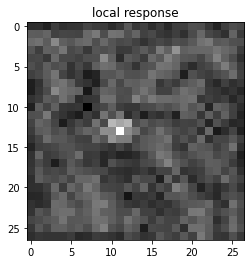

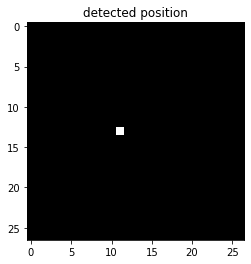

In [243]:
pattern = np.array([
    [0, 1, 0],
    [1, 1, 1],
    [0, 1, 0]
])
# Create the image
image = np.pad(pattern, [(12, 12), (10, 14)], mode='constant', constant_values=0)
plt.imshow(image, cmap='gray')
plt.title('original image')
plt.show()

# Add some noise
image = 0.5 * image + 0.5 * np.random.random(image.shape)
plt.imshow(image, cmap='gray')
plt.title('noisy image')
plt.show()

# Let's find the cross 
response = conv_matrix(image, pattern)
plt.imshow(response, cmap='gray')
plt.title('local response')
plt.show()

plt.imshow(response == response.max(), cmap='gray')
plt.title('detected position')
plt.show()

The brightest pixel highlights where the cross is located. We can find the area where the image is locally close to the kernel. This is especially useful for finding different patterns in images such as: eyes, legs, dogs, cats, etc.

We defined kernels and applied them to images. But we can also **learn** them by minimizing loss and making the processing as effective as possible. In order to do this, we have to define the **Convolutional Layer** in the next chapter.

## 3.3 Convolutional layer

A **Convolutional Layer** works with images. Each image is a 3-dimensional object  $N_{\text{channels}} \times H \times W$.  
Here index *"channels"* refers to the 3 colors (or 1 for black & white images), $H$ to height, and $W$ to width.  
And therefore, the collection of images is 4-dimensional tensor of shape $N_{\text{objects}} \times N_{\text{channels}} \times H \times W$.

For example, 32 RGB images of size $224 \times 224$ are represented as a tensor of shape $32 \times 3 \times 224 \times 224$

A convolutional layer receives an image as its input. Here is how it works:  
The layer has `n_in * n_out` kernels. It is a tensor of size `(n_in, n_out, kernel_h, kernel_w)`  
It takes a 4-dimensional tensor of size `n_objects, n_in, H, W` as its input. 
* `n_objects` is the collection of images. 
* Each of them has `n_in` channels.
* The resolution of the images is `(H, W)`

For each of the images the following operation is performed:  
* In order to get the 1st output channel, all inputs are convolved with their corresponding kernels.  
* Then the results are summed and written to the output channel.  
This is our implementation:
```python
for i in range(n_out):
    out_channel = 0.0
    for j in range(n_in):
        kernel_2d = K[i, j] # Retrieve kernel from the collection of kernels
        input_channel = input_image[j] # Get one channel of the input image
        out_channel += conv_matrix(input_channel, kernel_2d) # Perform convolution
    output_image.append(out_channel) # Append the calculated channel to the output          
```

We implemented the convolutional layer for you. The implementation of `backward` is based on the idea that convolution could be represented as matrix multiplication.

In [244]:
class ConvLayer(Layer):
    """
    Convolutional Layer. The implementation is based on 
        the representation of the convolution as matrix multiplication
    """
    
    def __init__(self, n_in, n_out, filter_size):
        super(ConvLayer, self).__init__()
        self.W = np.random.normal(size=(n_out, n_in, filter_size, filter_size))
        self.b = np.zeros(n_out)
        
    def forward(self, x_input):
        n_obj, n_in, h, w = x_input.shape
        n_out = len(self.W)
        
        self.output = []
        
        for image in x_input:
            output_image = []
            for i in range(n_out):
                out_channel = 0.0
                for j in range(n_in):
                    out_channel += conv_matrix(image[j], self.W[i, j])
                output_image.append(out_channel)
            self.output.append(np.stack(output_image, 0))

        self.output = np.stack(self.output, 0)
        return self.output

    
    def backward(self, x_input, grad_output):

        N, C, H, W = x_input.shape 
        F, C, HH, WW = self.W.shape
        
        pad = int((HH - 1) / 2)

        self.grad_b = np.sum(grad_output, (0, 2, 3)) 

        # pad input array
        x_padded = np.pad(x_input, ((0,0), (0,0), (pad, pad), (pad, pad)), 'constant')
        H_padded, W_padded = x_padded.shape[2], x_padded.shape[3]
        # naive implementation of im2col
        x_cols = None
        for i in range(HH, H_padded + 1):
            for j in range(WW, W_padded+1):
                for n in range(N):
                    field = x_padded[n, :, i-HH:i, j-WW:j].reshape((1,-1))    
                    if x_cols is None:
                        x_cols = field
                    else:
                        x_cols = np.vstack((x_cols, field))
                        
        x_cols = x_cols.T

        d_out = grad_output.transpose(1, 2, 3, 0) 
        dout_cols = d_out.reshape(F, -1) 

        dw_cols = np.dot(dout_cols, x_cols.T) 
        self.grad_W = dw_cols.reshape(F, C, HH, WW) 

        w_cols = self.W.reshape(F, -1) 
        dx_cols = np.dot(w_cols.T, dout_cols) 

        dx_padded = np.zeros((N, C, H_padded, W_padded))
        idx = 0
        for i in range(HH, H_padded + 1):
            for j in range(WW, W_padded + 1):
                for n in range(N):
                    dx_padded[n:n+1, :, i-HH:i, j-WW:j] += dx_cols[:, idx].reshape((1, C, HH, WW))
                    idx += 1
            dx = dx_padded[:, :, pad:-pad, pad:-pad]
        grad_input = dx
        return grad_input
    
    def get_params(self):
        return [self.W, self.b]

    def get_params_gradients(self):
        return [self.grad_W, self.grad_b]

This layer transforms images with 3 channels into images with 8 channels by convolving them with kernels of size `(3, 3)`

In [245]:
conv_layer = ConvLayer(3, 8, filter_size=3)

## 3.4 Pooling layer

The pooling layer **reduces the size of an image**. 

In the following figure $2 \times 2$ pooling is applied on the image which effectively reduces the size by half.  
If you look closely, pooling operations have no effect on the depth of an image.
![pool](./src/pool.png)

There are several types of pooling operations but the most common one is **max pooling**. 

During a max pooling operation, the image is split into **windows** (or **filters**) and then the maximum of each window is used as the output.

![maxpool](./src/maxpool.png)

In [268]:
def maxpool_forward(x_input):
    """Perform max pooling operation with 2x2 window
    # Arguments
        x_input: np.array of size (2 * W, 2 * H)
    # Output
        output: np.array of size (W, H)
    """
    #help("//")
    M, N = x_input.shape
    K = 2
    L = 2

    MK = M // K
    NL = N // L
    output = x_input[:MK*K, :NL*L].reshape(MK, K, NL, L).max(axis=(1, 3))
# [[200, 119], [120, 49]] 
#     output = skimage.measure.block_reduce(x_input, (2,2), np.max)
#     output = x_input.reshape(int(x_input[0]/2),int(x_input[1]/2))
#     print(x_input.shape)
#     print(x_input)
    #################
    ### YOUR CODE ###
    ################# 
    return output

Once again, you can use example data to test your solution:  
**Image:**
$$ 
\begin{equation*}
\begin{bmatrix}
1 & 1 & 2 & 4 \\
5 & 6 & 7 & 8 \\
3 & 2 & 1 & 0 \\
1 & 2 & 3 & 4
\end {bmatrix}
\end{equation*}
$$

**Output:**
$$ 
\begin{equation*}
\begin{bmatrix}
6 & 8 \\
3 & 4
\end {bmatrix}
\end{equation*}
$$

In [269]:
test_image = np.array([
    [1, 1, 2, 4],
    [5, 6, 7, 8],
    [3, 2, 1, 0],
    [1, 2, 3, 4]
])

print(maxpool_forward(test_image))

[[6 8]
 [3 4]]


In [270]:
am.test_student_function(username, maxpool_forward, ['x_input'])

Running local tests...
maxpool_forward successfully passed local tests
Running remote test...
Test was successful. Congratulations!


We already implemented the gradient calculation.  
It is not overly complicated; reading the code should help you to understand the concept.

In [271]:
def maxpool_grad_input(x_input, grad_output):
    """Calculate partial derivative of the loss with respect to the input
    # Arguments
        x_input: np.array of size (2 * W, 2 * H)
        grad_output: partial derivative of the loss 
            with respect to the output 
            np.array of size (W, H)
    # Output
        output: partial derivative of the loss 
            with respect to the input
            np.array of size (2 * W, 2 * H) 
    """
    height, width = x_input.shape
    # create the array of zeros of the required size
    grad_input = np.zeros(x_input.shape)
    
    # let's put 1 if the element with this position 
    # is maximal in the window
    for i in range(0, height, 2):
        for j in range(0, width, 2):
            window = x_input[i:i+2, j:j+2]
            i_max, j_max = np.unravel_index(np.argmax(window), (2, 2))
            grad_input[i + i_max, j + j_max] = 1
            
    # put corresponding gradient instead of 1       
    grad_input = grad_input.ravel()
    grad_input[grad_input == 1] = grad_output.ravel()
    grad_input = grad_input.reshape(x_input.shape)
    return grad_input

Following up is the full implementation of the **MaxPool Layer**.

In [272]:
class MaxPool2x2(Layer):
    
    def forward(self, x_input):
        n_obj, n_ch, h, w = x_input.shape
        self.output = np.zeros((n_obj, n_ch, h // 2, w // 2))
        for i in range(n_obj):
            for j in range(n_ch):
                self.output[i, j] = maxpool_forward(x_input[i, j])
        return self.output 
    
    def backward(self, x_input, grad_output):
        n_obj, n_ch, _, _ = x_input.shape
        grad_input = np.zeros_like(x_input)
        for i in range(n_obj):
            for j in range(n_ch):
                grad_input[i, j] = maxpool_grad_input(x_input[i, j], grad_output[i, j])
        return grad_input

## 3.5 Flatten

Convolutional neural networks are better at image processing than fully connected neural networks (dense networks). We will combine convolutional layers, which deal with 4-dimensional tensors, with dense layers, which work with matrices.  
In order to bridge the gap between convolutional layers and dense layers we will implement the **Flatten Layer**.

The Flatten layer receives a 4-dimensional tensor of size `(n_obj, n_channels, h, w)` as its input and reshapes it into a 2-dimensional tensor (matrix) of size `(n_obj, n_channels * h * w)`.  

The backward pass of this layer is pretty straightforward. Remember that we don't actually change any values; we merely reshape inputs.

**Please implement `flatten_forward` and `flatten_grad_input` functions using [np.reshape](https://docs.scipy.org/doc/numpy-1.13.0/reference/generated/numpy.reshape.html)**.

In [295]:
def flatten_forward(x_input):
    """Perform the reshaping of the tensor of size `(K, L, M, N)` 
        to the tensor of size `(K, L*M*N)`
    # Arguments
        x_input: np.array of size `(K, L, M, N)`
    # Output
        output: np.array of size `(K, L*M*N)`
    """
    print(x_input.shape)
#     output = x_input.reshape(x_input.shape[0])
    output = x_input.reshape(x_input.shape[0], np.prod(x_input.shape[1:]))
    
    print(np.prod(x_input.shape[1:]))
    #################
    ### YOUR CODE ###
    #################
    return output

You can use test data and compare the final shape. It should be `(100, 768)` for the following example.  
Please ignore the use of [np.zeros](https://docs.scipy.org/doc/numpy-1.13.0/reference/generated/numpy.zeros.html) in this case. We are just interested in transforming shapes.  
**Be aware:** This test will fail if you do not return an array like object!

In [296]:
test_input = np.zeros((100, 3, 16, 16))

print(flatten_forward(test_input).shape)

(100, 3, 16, 16)
768
(100, 768)


In [297]:
am.test_student_function(username, flatten_forward, ['x_input'])

Running local tests...
(6, 4, 6, 4)
96
(6, 5, 1, 5)
25
(6, 5, 6, 5)
150
(3, 5, 2, 5)
50
(4, 5, 4, 1)
20
(2, 3, 5, 5)
75
(5, 5, 6, 3)
90
(2, 5, 3, 2)
30
(6, 6, 6, 1)
36
(2, 3, 2, 2)
12
(2, 2, 2, 6)
24
(6, 6, 1, 1)
6
(6, 5, 6, 6)
180
(2, 6, 2, 5)
60
(6, 2, 4, 6)
48
(1, 1, 1, 4)
4
(3, 4, 5, 6)
120
(3, 6, 1, 3)
18
(2, 5, 3, 3)
45
(2, 5, 5, 4)
100
(6, 3, 2, 4)
24
(2, 1, 3, 6)
18
(2, 4, 4, 3)
48
(3, 5, 5, 1)
25
(4, 2, 2, 5)
20
(1, 2, 3, 5)
30
(4, 1, 6, 2)
12
(5, 4, 3, 4)
48
(4, 2, 1, 4)
8
(3, 5, 6, 6)
180
(5, 4, 6, 3)
72
(1, 2, 2, 5)
20
(1, 4, 3, 6)
72
(2, 5, 5, 5)
125
(5, 6, 6, 3)
108
(6, 1, 1, 4)
4
(2, 3, 3, 1)
9
(1, 6, 5, 6)
180
(2, 5, 2, 5)
50
(6, 3, 3, 6)
54
(1, 6, 5, 6)
180
(1, 3, 3, 6)
54
(6, 4, 2, 5)
40
(4, 1, 4, 3)
12
(6, 2, 3, 4)
24
(5, 1, 4, 4)
16
(6, 3, 2, 6)
36
(3, 5, 4, 4)
80
(2, 2, 6, 2)
24
(6, 3, 6, 6)
108
(1, 4, 6, 3)
72
(4, 5, 2, 3)
30
(4, 4, 3, 5)
60
(2, 6, 3, 5)
90
(6, 6, 6, 5)
180
(2, 4, 4, 4)
64
(5, 2, 3, 3)
18
(1, 1, 4, 6)
24
(5, 3, 1, 5)
15
(2, 3, 3, 4)
36
(1, 5, 2, 1

In [276]:
def flatten_grad_input(x_input, grad_output):
    """Calculate partial derivative of the loss with respect to the input
    # Arguments
        x_input: np.array of size `(K, L, M, N)`
        grad_output: partial derivative of the loss 
            with respect to the output
            np.array of size `(K, L*M*N)`
    # Output
        output: partial derivative of the loss 
            with respect to the input
            np.array of size `(K, L, M, N)`
    """
    grad_input = grad_output.reshape(x_input.shape)
    #################
    ### YOUR CODE ###
    #################
    return grad_input

In [277]:
am.test_student_function(username, flatten_grad_input, ['x_input', 'grad_output'])

Running local tests...
flatten_grad_input successfully passed local tests
Running remote test...
Test was successful. Congratulations!


This is the, pretty self-explanatory, implemention of the **Flatten Layer**.

In [278]:
class FlattenLayer(Layer):
    
    def forward(self, x_input):
        self.output = flatten_forward(x_input)
        return self.output
    
    def backward(self, x_input, grad_output):
        output = flatten_grad_input(x_input, grad_output)
        return output

# 4. Image Experiments

This chapter focuses on conducting several experiments. We will train our neural networks with **mini-batches**. Mini-batches are small portions of our dataset, all mini-batches together should form the original dataset again. With our mini-batches in place we will feed these one-by-one to our neural network.

In [279]:
import sys

def iterate_minibatches(x, y, batch_size=16, verbose=True):
    assert len(x) == len(y)
    
    indices = np.arange(len(x))
    np.random.shuffle(indices)
    
    for i, start_idx in enumerate(range(0, len(x) - batch_size + 1, batch_size)):
        if verbose:
            print('\rBatch: {}/{}'.format(i + 1, len(x) // batch_size), end='')
            sys.stdout.flush()
        
        excerpt = indices[start_idx:start_idx + batch_size]
        yield x[excerpt], y[excerpt]

Let's import the data. Please [download](http://yann.lecun.com/exdb/mnist/) it first.

If you get an error with loading the data, chances are you'll need to unpack the downloaded files.

In [280]:
from dataset_utils import load_mnist

In [281]:
train = list(load_mnist(dataset='training', path='.'))
train
train_images = np.array([im[1] for im in train])
train_targets = np.array([im[0] for im in train])
# We will train a 0 vs. 1 classifier
x_train = train_images[train_targets < 2][:1000]
y_train = train_targets[train_targets < 2][:1000]

y_train = y_train 
y_train = y_train.reshape((-1, 1))

FileNotFoundError: [Errno 2] No such file or directory: './train-labels-idx1-ubyte'

You just loaded the MNIST dataset. This dataset consists of gray-scale (so a single channel) images of size `28x28`. These images are represented by the RGB color model. This color model representes a color by 3 integers that range from 0 to 255, or in the case of gray-scale images this is a single integer. This means that each picture in the MNIST dataset is represented by 784 pixels with a value ranging from 0 to 255. This is how a single image looks like:

In [282]:
plt.imshow(x_train[0].reshape(28, 28), cmap='gray_r')

NameError: name 'x_train' is not defined

To make divergence to an optimum easier, we will normalize the images to have values between 0 and 1. Then, by reshaping, we will add the dimensions for the channel which, for simplicity, was removed by the creators of this dataset. As you can see, this doesn't change anything in how the image looks like.

In [283]:
x_train = x_train.astype('float32') / 255.0
x_train = x_train.reshape((-1, 1, 28, 28))
plt.imshow(x_train[0].reshape(28, 28), cmap='gray_r')

NameError: name 'x_train' is not defined

Now we will train a simple convolutional neural network:

In [284]:
def get_cnn():
    nn = SequentialNN(
        ConvLayer(1, 2, filter_size=3), # The output is of size [N_obj 2 28 28]
        ReLU(), # The output is of size [N_obj 2 28 28]
        MaxPool2x2(), # The output is of size [N_obj 2 14 14]
        ConvLayer(2, 4, filter_size=3), # The output is of size [N_obj 4 14 14]
        ReLU(), # The output is of size [N_obj 4 14 14]
        MaxPool2x2(), # The output is of size [N_obj 4 7 7]
        FlattenLayer(),  # The output is of size [N_obj 196]
        Dense(4 * 7 * 7, 8),
        ReLU(),
        Dense(8, 1),
        Sigmoid()
    )
    return nn

In [285]:
nn = get_cnn()
loss = NLL()
optimizer = SGD(nn, weight_decay=0.0)

In [286]:
# It will train for about 5 minutes
num_epochs = 5 
batch_size = 32
# We will store the results here
history = {'loss': [], 'accuracy': []}

# `num_epochs` represents the number of iterations
for epoch in range(num_epochs):
    print('Epoch {}/{}'.format(epoch + 1, num_epochs))
    
    # We perform iteration a one-by-one iteration of the mini-batches
    for x_batch, y_batch in iterate_minibatches(x_train, y_train, batch_size):
        # Predict the target value
        y_pred = nn.forward(x_batch)
        # Compute the gradient of the loss
        loss_grad = loss.backward(y_pred, y_batch)
        # Perform backwards pass
        nn.backward(x_batch, loss_grad)
        # Update the params
        optimizer.update_params()
        
        # Save loss and accuracy values
        history['loss'].append(loss.forward(y_pred, y_batch))
        prediction_is_correct = (y_pred > 0.5) == (y_batch > 0.5)
        history['accuracy'].append(np.mean(prediction_is_correct))
        
    print()

Epoch 1/5


NameError: name 'x_train' is not defined

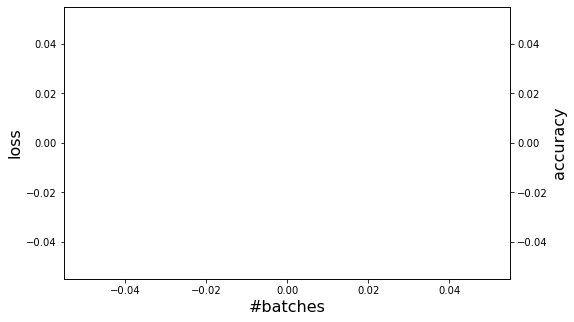

In [287]:
# Let's plot the results to get a better insight
plt.figure(figsize=(8, 5))

ax_1 = plt.subplot()
ax_1.plot(history['loss'], c='g', lw=2, label='train loss')
ax_1.set_ylabel('loss', fontsize=16)
ax_1.set_xlabel('#batches', fontsize=16)

ax_2 = plt.twinx(ax_1)
ax_2.plot(history['accuracy'], lw=3, label='train accuracy')
ax_2.set_ylabel('accuracy', fontsize=16)
plt.show()

**Things you could try:**  
Train the model with a different `batch_size`:
* What would happen with `batch_size=1`?
* What would happen with `batch_size=1000`?
* Does the speed of the computation depend on this parameter? If so, why?

Train the model with a different number of `num_epochs`:
* What would happen with `num_epochs=1`?
* What would happen with `num_epochs=1000`?
* How does it affect computation time, resource strain, and accuracy?

Let's visualize the activations of the intermediate layers:

In [288]:
viz_images = x_batch[:2]
_ = nn.forward(viz_images)

activations = {
    'conv_1': nn.layers[0].output,
    'relu_1': nn.layers[1].output,
    'pool_1': nn.layers[2].output,
    'conv_2': nn.layers[3].output,
    'relu_2': nn.layers[4].output,
    'pool_2': nn.layers[5].output,
}

NameError: name 'x_batch' is not defined

### Input Images

NameError: name 'viz_images' is not defined

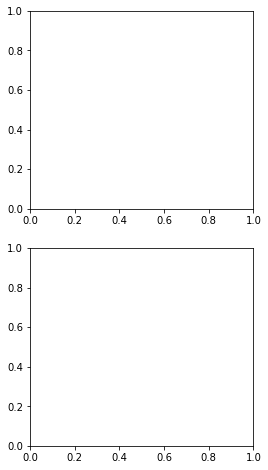

In [289]:
# Input
f, (ax1, ax2) = plt.subplots(2, 1, figsize=(4, 8))

ax1.imshow(viz_images[0, 0], cmap=plt.cm.gray_r)
ax1.set_xticks([])
ax1.set_yticks([])

ax2.imshow(viz_images[1, 0], cmap=plt.cm.gray_r)
ax2.set_xticks([])
ax2.set_yticks([])

plt.show()

### Activations of Conv 1

NameError: name 'activations' is not defined

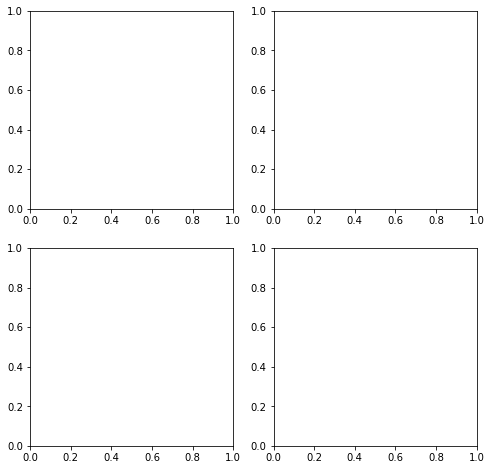

In [290]:
# Conv 1
f, axes = plt.subplots(2, 2, figsize=(8, 8))

for i in range(2):
    for j in range(2):
        ax = axes[i, j]
        ax.imshow(activations['conv_1'][i, j], cmap=plt.cm.gray_r)
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_title('Channel {}'.format(j + 1))

plt.show()

### Activations of ReLU 1

In [ ]:
# ReLU 1
f, axes = plt.subplots(2, 2, figsize=(8, 8))

for i in range(2):
    for j in range(2):
        ax = axes[i, j]
        ax.imshow(activations['relu_1'][i, j], cmap=plt.cm.gray_r)
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_title('Channel {}'.format(j + 1))

plt.show()

### Activations of MaxPooling 1

NameError: name 'activations' is not defined

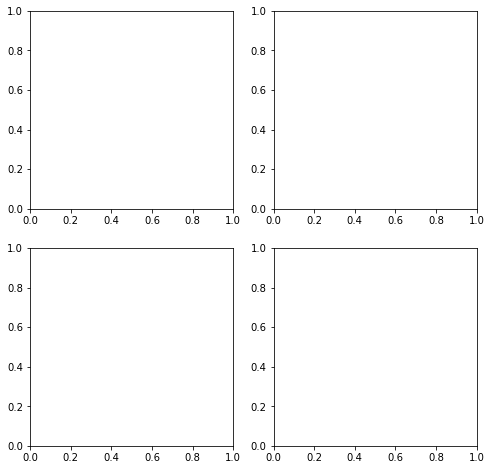

In [291]:
# Max Pooling 1
f, axes = plt.subplots(2, 2, figsize=(8, 8))

for i in range(2):
    for j in range(2):
        ax = axes[i, j]
        ax.imshow(activations['pool_1'][i, j], cmap=plt.cm.gray_r)
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_title('Channel {}'.format(j + 1))

plt.show()

### Activations of Conv 2

NameError: name 'activations' is not defined

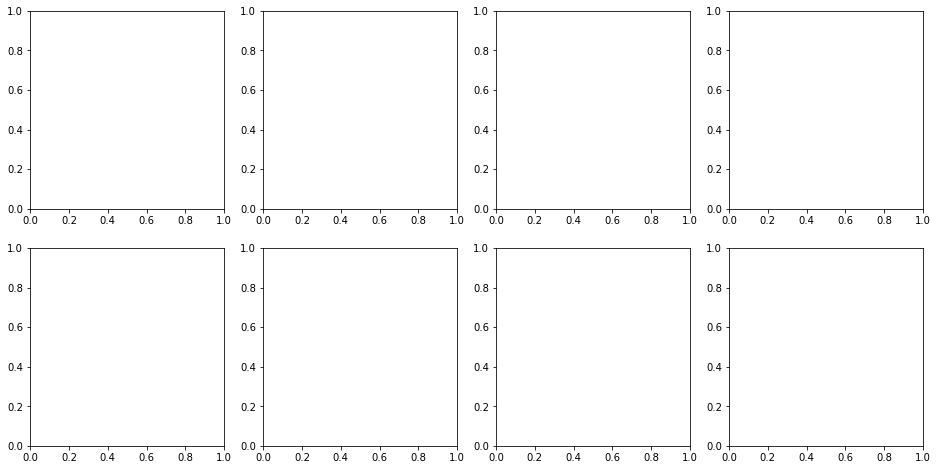

In [292]:
# Conv 2
f, axes = plt.subplots(2, 4, figsize=(16, 8))

for i in range(2):
    for j in range(4):
        ax = axes[i, j]
        ax.imshow(activations['conv_2'][i, j], cmap=plt.cm.gray_r)
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_title('Channel {}'.format(j + 1))

plt.show()

### Activations of ReLU 2

In [ ]:
# ReLU 2
f, axes = plt.subplots(2, 4, figsize=(16, 8))

for i in range(2):
    for j in range(4):
        ax = axes[i, j]
        ax.imshow(activations['relu_2'][i, j], cmap=plt.cm.gray_r)
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_title('Channel {}'.format(j + 1))

plt.show()

### Activations of MaxPooling 2

NameError: name 'activations' is not defined

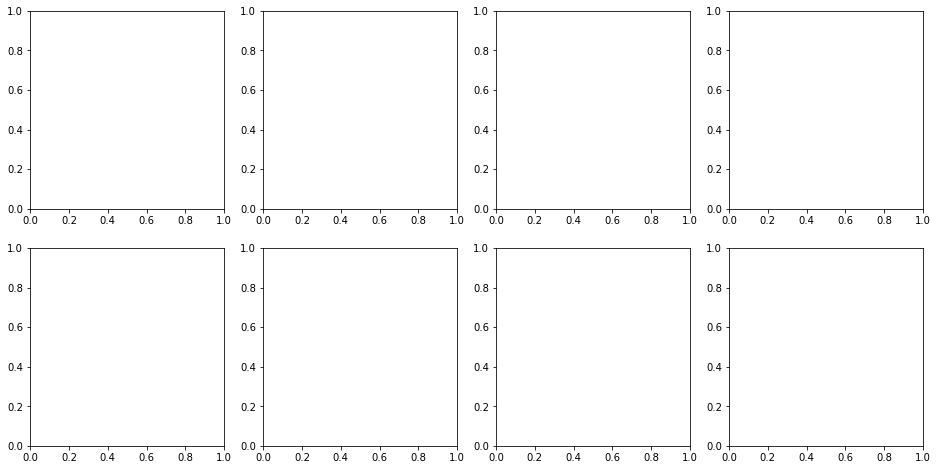

In [293]:
# Max Pooling 2
f, axes = plt.subplots(2, 4, figsize=(16, 8))

for i in range(2):
    for j in range(4):
        ax = axes[i, j]
        ax.imshow(activations['pool_2'][i, j], cmap=plt.cm.gray_r)
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_title('Channel {}'.format(j + 1))

plt.show()

As we go deeper and deeper, images become less locally-correlated (the dependance between two neighbours decreases) and more semantically loaded.  
Each convoluted pixel stores more and more useful information about the object.  
In the end, this will be anaylzed using several **Dense Layers**.

**Things you could try:**
* Change the architecture of the neural network
* Vary the number of kernels
* Vary the size of the kernels